# 정부별 count 분석

In [1]:
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
import seaborn as sns
import re
from tqdm import tqdm
from gensim.models import Word2Vec
from sklearn.cluster import KMeans
import os
from gensim import models
import fasttext.util
from sklearn.cluster import AgglomerativeClustering
from konlpy.tag import Okt
import logging
import hanja
from krwordrank.hangle import normalize
import datetime
%matplotlib inline

In [2]:
# 한글폰트 설정
import matplotlib as mpl
import matplotlib.pyplot as plt
 
%config InlineBackend.figure_format = 'retina'
 
!apt -qq -y install fonts-nanum
 
import matplotlib.font_manager as fm
fontpath = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font = fm.FontProperties(fname=fontpath, size=9)
plt.rc('font', family='NanumBarunGothic') 
mpl.font_manager._rebuild()

Unable to locate an executable at "/Library/Java/JavaVirtualMachines/jdk-14.0.1.jdk/Contents/Home/bin/apt" (-1)


In [3]:
gender = pd.read_csv('whole-gender-bill-1320.csv', index_col=0,
                           parse_dates=['제안일자','의결일자'],encoding='utf-8-sig')
print(gender.shape)
gender.head(1)

(4521, 16)


,의안번호,의안명,제안일자,제안자구분,의결일자,의결결과,제안회기,제안이유,소관위원회,제안자,발의자,제안정당,성별,여성의원 수,정당성향,국회회기
0,131131,소득세법중개정법률안,1990-12-17,위원장,1990-12-18,원안가결,제13대 (1988~1992) 제151회,"정부제출,柳인학·강金식·금봉욱·林춘원·李경재·허만기·홍영기의원외64인 발의,1...",재무위원회,[],위원장,위원장,NaN,0,NaN,13


In [4]:
gender['제안일자'] = gender['제안일자'].dt.date
gender['의결일자'] = gender['의결일자'].dt.date

In [5]:
gender['제안일자'].unique()

array([datetime.date(1990, 12, 17), datetime.date(1990, 11, 20),
       datetime.date(1990, 10, 8), ..., datetime.date(2016, 6, 1),
       datetime.date(2016, 5, 31), datetime.date(2016, 5, 30)],
      dtype=object)

In [6]:
drop_list = [177919, 177064, 176854, 176797, 176796, 176795, 176794]

gender = gender[~gender['의안번호'].isin(drop_list)]
gender.shape

(4514, 16)

## 정부별 wordcloud

In [7]:
gender['제안자구분'].value_counts()

의원     3992
위원장     344
정부      178
Name: 제안자구분, dtype: int64

In [8]:
# 한글 전처리
def preprocessing(text): 
    text_pre1 = re.sub('[-=.#/:$}·,■?]', ' ', text)
    text_pre2 = re.sub('[^가-힣ㄱ-ㅎㅏ-ㅣa-zA-Z]', ' ', text_pre1)
    return str(text_pre2)

# 의미없는 단어 삭제 
def remove_stopword(text): 
    stopwords = ['사이','을','이','의','를','에','가','들','은','는','으로','한','도','항','관','정',
              '수','에서','로','것','그','과','제','입니다','할','하고','적','하는','로부터','면','관','항','이',
              '합니다','와','에게','고','인','하여','등','저','있습니다','말','까지','일명','보장하',
              '그리고','다','만','했습니다','안','된','못','일','더','위','최근','인한','있어'
              '있는','해','또한','명','하지','정말','물','많은','것임','류','줄','통해',
              '중','게','너무','자','이런','때','되지','위해','에는','없는','중','물이',
              '및','요','때문','관련','대한','전','라고','되었습니다','하기','나','후','같은','해서',
              '글','되어','주','차','하','내','없이','대해','잘','항','조','경우','함안','기간','하려는','일부',
              '마련','있도록','또는','함','하도록','개월','분','부터','제호','관','되고','년','월','및','등',\
              '안','바','이','것','부터','수','시','자',
            '조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출']

    text = [word for word in text if word not in stopwords]
    return text

In [9]:
gender['의안텍스트'] = (gender['의안명'] + ' ' + gender['제안이유']).str.strip()
gender['의안텍스트'] = gender['의안텍스트'].apply(lambda x:str(x).lower())

In [10]:
%time gender['의안텍스트'] = gender['의안텍스트'].apply(preprocessing)

CPU times: user 291 ms, sys: 3.52 ms, total: 295 ms
Wall time: 306 ms


In [11]:
from konlpy.tag import Mecab, Okt, Hannanum

# okt = Okt()
hannanum = Hannanum()

def get_tokens(x):
    try:
        return [i for i in hannanum.nouns(x) if len(i) > 1] if x else []
    except Exception as e:
        if str(x) == 'nan':
            return []
        print(e)
        print(str(x))
        raise e

In [12]:
# 단어에서 명사만 뽑아내기
# okt = Okt()
%time gender['tokens'] = gender['의안텍스트'].apply(get_tokens)
gender['tokens'][:3]

CPU times: user 3min, sys: 888 ms, total: 3min 1s
Wall time: 2min 40s


0    [소득세법중개정법률, 정부제출, 인학, 금봉욱, 춘원, 경재, 허만기, 홍영기의원외...
1    [특정범죄가중처벌등에관한법률중개정법률안, 정부, 제출, 특정범죄, 가중처벌, 법률,...
2    [유아의보호, 교육에관한법률안, 현대사회, 산업화, 여성, 사회참여, 가족구조, 핵...
Name: tokens, dtype: object

In [13]:
%time gender['tokens'] = gender['tokens'].apply(remove_stopword)

CPU times: user 1.45 s, sys: 5.2 ms, total: 1.46 s
Wall time: 1.5 s


In [14]:
%time gender['명사수'] = gender['tokens'].apply(len)

CPU times: user 2.2 ms, sys: 81 µs, total: 2.28 ms
Wall time: 2.22 ms


In [15]:
# 명사 수가 10개를 넘어가는 경우만 추출
#gender = gender[gender['명사수'] >= 10]
#gender = gender.reset_index(drop=True)
#print(gender.shape)

In [16]:
# 문장 벡터 생성
def get_sentence_mean_vector(morphs, model):
    vector = []
    for i in morphs:
        try:
            vector.append(model.wv[i])
        except:
            pass
    try:
        return np.mean(vector, axis=0)
    except:
        pass
    
# 엘보우 함수
def elbow(X):
    sse = []
    for i in tqdm(range(1,15), desc = '엘보우'):
        km = KMeans(init='k-means++', n_clusters = i, random_state=0)
        km.fit(X)
        sse.append(km.inertia_)
        
    plt.plot(range(1,15), sse, marker='o')
    plt.xlabel("number of cluster")
    plt.ylabel("SSE")
    plt.show()

## 정권 탐색 

### 노태우 정권 
- 1998.02.25 ~ 1993.02.24

In [17]:
notaewoo = gender[(gender['제안일자'] >= datetime.date(1988,5,3)) & 
                        (gender['제안일자'] <= datetime.date(1993,2,24))]
notaewoo.shape

(23, 19)

In [18]:
notaewoo['소관위원회'].value_counts()

법제사법위원회             11
보건사회위원회              4
재무위원회                4
노동위원회                2
내무위원회                1
민주발전을위한법률개폐특별위원회     1
Name: 소관위원회, dtype: int64

#### 소관위원회별 탐색

<AxesSubplot:>

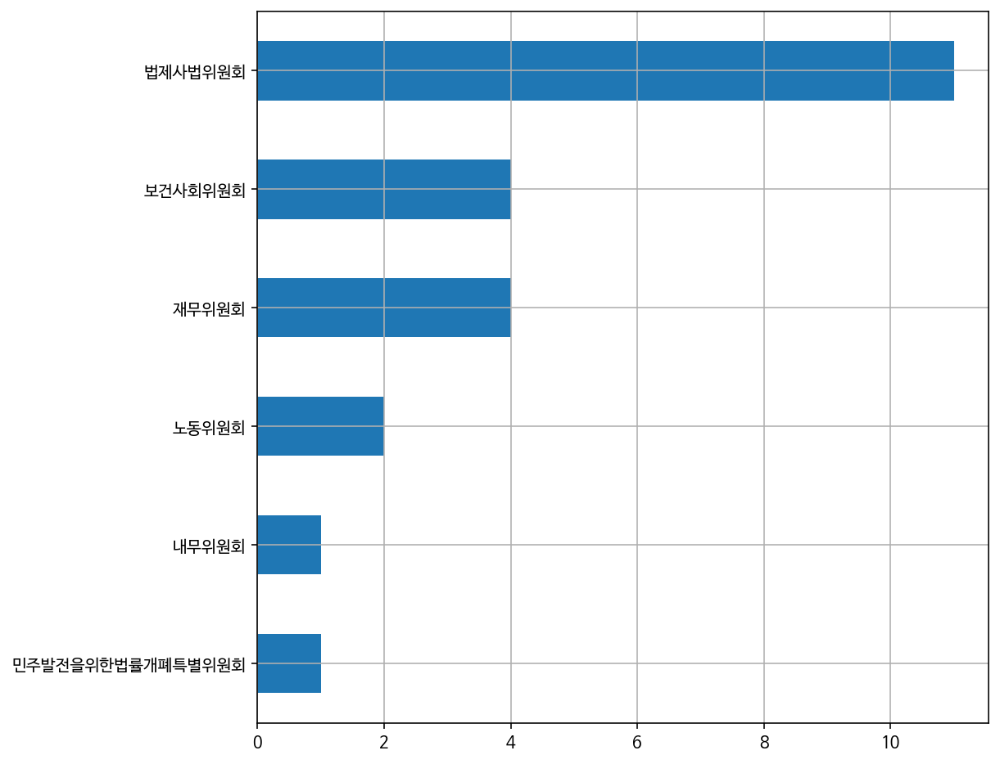

In [19]:
comm_df = notaewoo.copy()
comm_df = comm_df[comm_df['소관위원회'] != '미확정']

comm_df['소관위원회'].value_counts(ascending=True).plot(kind='barh', grid=True, figsize=(8,8))

In [20]:
# word2vec 모델 학습에 로그를 찍기
logging.basicConfig(
    format='%(asctime)s : %(levelname)s : %(message)s', 
    level=logging.INFO)

In [21]:
model_government = Word2Vec(notaewoo['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-11-05 14:48:48,923 : INFO : collecting all words and their counts
2020-11-05 14:48:48,924 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-11-05 14:48:48,926 : INFO : collected 2142 word types from a corpus of 4342 raw words and 23 sentences
2020-11-05 14:48:48,927 : INFO : Loading a fresh vocabulary
2020-11-05 14:48:48,929 : INFO : effective_min_count=10 retains 43 unique words (2% of original 2142, drops 2099)
2020-11-05 14:48:48,930 : INFO : effective_min_count=10 leaves 649 word corpus (14% of original 4342, drops 3693)
2020-11-05 14:48:48,932 : INFO : deleting the raw counts dictionary of 2142 items
2020-11-05 14:48:48,932 : INFO : sample=0.001 downsamples 43 most-common words
2020-11-05 14:48:48,933 : INFO : downsampling leaves estimated 160 word corpus (24.8% of prior 649)
2020-11-05 14:48:48,934 : INFO : estimated required memory for 43 words and 100 dimensions: 55900 bytes
2020-11-05 14:48:48,935 : INFO : resetting layer weights
2020-11-05 1

2020-11-05 14:48:49,086 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,087 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:49,088 : INFO : EPOCH - 15 : training on 4342 raw words (160 effective words) took 0.0s, 51732 effective words/s
2020-11-05 14:48:49,092 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,093 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:49,094 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,095 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:49,096 : INFO : EPOCH - 16 : training on 4342 raw words (136 effective words) took 0.0s, 38169 effective words/s
2020-11-05 14:48:49,100 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,101 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 1

2020-11-05 14:48:49,223 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,224 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:49,226 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,227 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:49,228 : INFO : EPOCH - 32 : training on 4342 raw words (165 effective words) took 0.0s, 31988 effective words/s
2020-11-05 14:48:49,232 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,234 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:49,235 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,236 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:49,238 : INFO : EPOCH - 33 : training on 4342 raw words (163 effective words) took 0.0s, 28826 effective words/s
2020-11-05 1

2020-11-05 14:48:49,375 : INFO : EPOCH - 48 : training on 4342 raw words (136 effective words) took 0.0s, 31032 effective words/s
2020-11-05 14:48:49,377 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,378 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:49,379 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,381 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:49,382 : INFO : EPOCH - 49 : training on 4342 raw words (182 effective words) took 0.0s, 36113 effective words/s
2020-11-05 14:48:49,384 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,386 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:49,388 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,389 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 1

2020-11-05 14:48:49,546 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,548 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:49,550 : INFO : EPOCH - 65 : training on 4342 raw words (148 effective words) took 0.0s, 24139 effective words/s
2020-11-05 14:48:49,556 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,558 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:49,560 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,562 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:49,564 : INFO : EPOCH - 66 : training on 4342 raw words (153 effective words) took 0.0s, 20229 effective words/s
2020-11-05 14:48:49,569 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,570 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 1

2020-11-05 14:48:49,738 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,740 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:49,742 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,824 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:49,825 : INFO : EPOCH - 82 : training on 4342 raw words (147 effective words) took 0.1s, 1688 effective words/s
2020-11-05 14:48:49,827 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,829 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:49,831 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,832 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:49,833 : INFO : EPOCH - 83 : training on 4342 raw words (159 effective words) took 0.0s, 26530 effective words/s
2020-11-05 14

2020-11-05 14:48:49,989 : INFO : EPOCH - 98 : training on 4342 raw words (148 effective words) took 0.0s, 21616 effective words/s
2020-11-05 14:48:49,992 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:49,994 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:49,996 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:49,998 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:48:50,000 : INFO : EPOCH - 99 : training on 4342 raw words (168 effective words) took 0.0s, 20641 effective words/s
2020-11-05 14:48:50,003 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:48:50,006 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:48:50,008 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:48:50,011 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 1

In [22]:
print(model_government.wv.most_similar('여성'))

2020-11-05 14:48:50,022 : INFO : precomputing L2-norms of word weight vectors


[('성폭력범죄', 0.9630917310714722), ('피해자', 0.8540656566619873), ('사회', 0.8517250418663025), ('보호', 0.8203960061073303), ('지방자치단체', 0.7782047986984253), ('시설', 0.7436238527297974), ('범죄', 0.7294354438781738), ('가중처벌', 0.6944010257720947), ('미성년자', 0.6907159090042114), ('보육시설', 0.6882810592651367)]


In [23]:
import nltk 
from wordcloud import WordCloud

def total_tokens(df): 
    gender_tokens = []
    for row in df: 
        for word in row: 
            gender_tokens.append(word)
    return gender_tokens

def frewords_vis(tokens): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    plt.figure(figsize=(12,6))
    ko.plot(50) # 상위 50 토큰를 정렬하여 보여줌 
    plt.show()
    
def wordcloud_vis(tokens, color): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    data = ko.vocab().most_common(150)
    data2 = dict(data)
    font_path = '/usr/share/fonts/BlackHanSans-Regular.ttf'

    wordcloud = WordCloud(font_path=font_path,
                          colormap=f'{color}',
                          width = 800, 
                         height = 800)

    wordcloud = wordcloud.generate_from_frequencies(data2)
    plt.figure(figsize=(10,10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [24]:
government_word = total_tokens(notaewoo['tokens'])

In [25]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','만원이하','세부담',
            '현재','보고','중요','규정함','계산시','다음','퍼센트']
government_word = [each_word for each_word in government_word if each_word not in stopwords]

In [26]:
ko = nltk.Text(government_word, name='노태우 정권')

In [27]:
print('총 토큰 수:', len(ko.tokens))
print(ko.vocab())

총 토큰 수: 4129
<FreqDist with 2113 samples and 4129 outcomes>


In [28]:
ko.vocab().most_common(20)

[('공제', 33),
 ('지방자치단체', 27),
 ('근로자', 21),
 ('범죄', 21),
 ('소득세', 19),
 ('보호', 19),
 ('처벌', 19),
 ('배우자', 19),
 ('징역', 18),
 ('가중처벌', 17),
 ('무기', 17),
 ('과세', 16),
 ('보육시설', 16),
 ('후보자', 16),
 ('호주', 16),
 ('미성년자', 15),
 ('피해자', 14),
 ('여성', 14),
 ('사회', 14),
 ('가정법원', 13)]

In [29]:
print('부녀 단어 수:', ko.count('부녀'))
print('여자 단어 수:', ko.count('여자'))
print('여성 단어 수:', ko.count('여성'))
print('젠더 단어 수:', ko.count('젠더'))
print()

print('여성발전 단어 수:', ko.count('여성발전'))
print('남녀평등 단어 수:', ko.count('남녀평등'))
print('양성평등 단어 수:', ko.count('양성평등'))
print('성평등 단어 수:', ko.count('성평등'))
print('성인지적 단어 수:', ko.count('성인지적'))
print('성주류화 단어 수:', ko.count('성주류화'))
print()

print('청소년 단어 수:', ko.count('청소년'))
print('아동 단어 수:', ko.count('아동'))

부녀 단어 수: 6
여자 단어 수: 1
여성 단어 수: 14
젠더 단어 수: 0

여성발전 단어 수: 0
남녀평등 단어 수: 1
양성평등 단어 수: 1
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 1
아동 단어 수: 6


In [48]:
# 호주제
print('호주제 단어 수:', ko.count('호주제'))
print('가족법 단어 수:', ko.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko.count('저출산'))
print('육아휴직 단어 수:', ko.count('육아휴직'))
print('보육 단어 수:', ko.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko.count('위안부'))
print('일본군성노예제 단어 수:', ko.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko.count('성범죄'))
print('강간 단어 수:', ko.count('강간'))
print('성희롱 단어 수:', ko.count('성희롱'))
print('성폭력 단어 수:', ko.count('성폭력'))
print('성폭력범죄 단어 수:', ko.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko.count('윤락'))
print('윤락행위 단어 수:', ko.count('윤락행위'))
print('기생관광 단어 수:', ko.count('기생관광'))
print('성매매 단어 수:', ko.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko.count('낙태'))
print('임신중절 단어 수:', ko.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko.count('불법촬영'))
print('몰카 단어 수:', ko.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 7

저출산 단어 수: 0
육아휴직 단어 수: 0
보육 단어 수: 5

위안부 단어 수: 0
일본군성노예제 단어 수: 0

성범죄 단어 수: 2
강간 단어 수: 12
성희롱 단어 수: 0
성폭력 단어 수: 8
성폭력범죄 단어 수: 12

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 0

낙태 단어 수: 1
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0


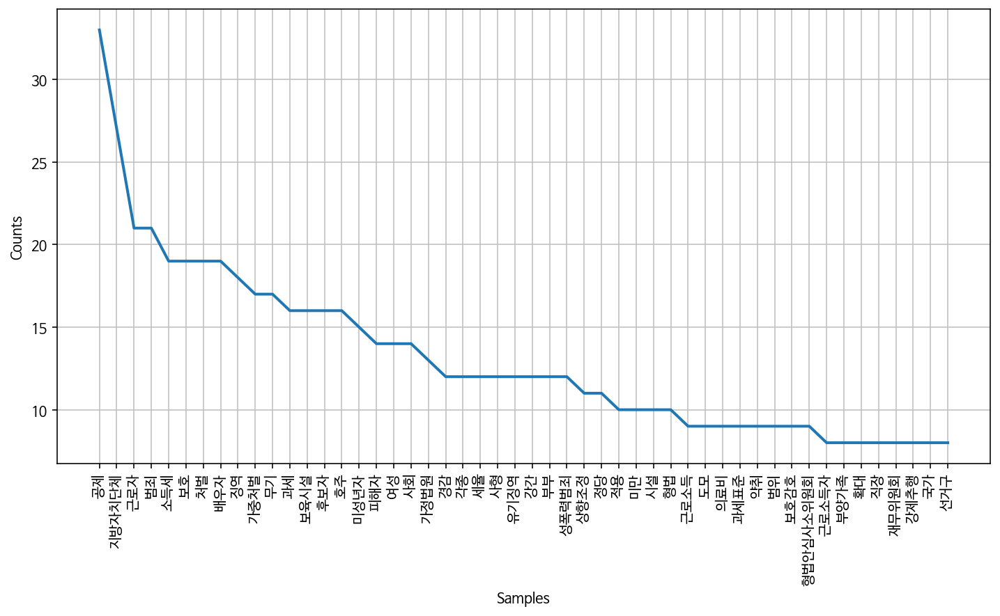

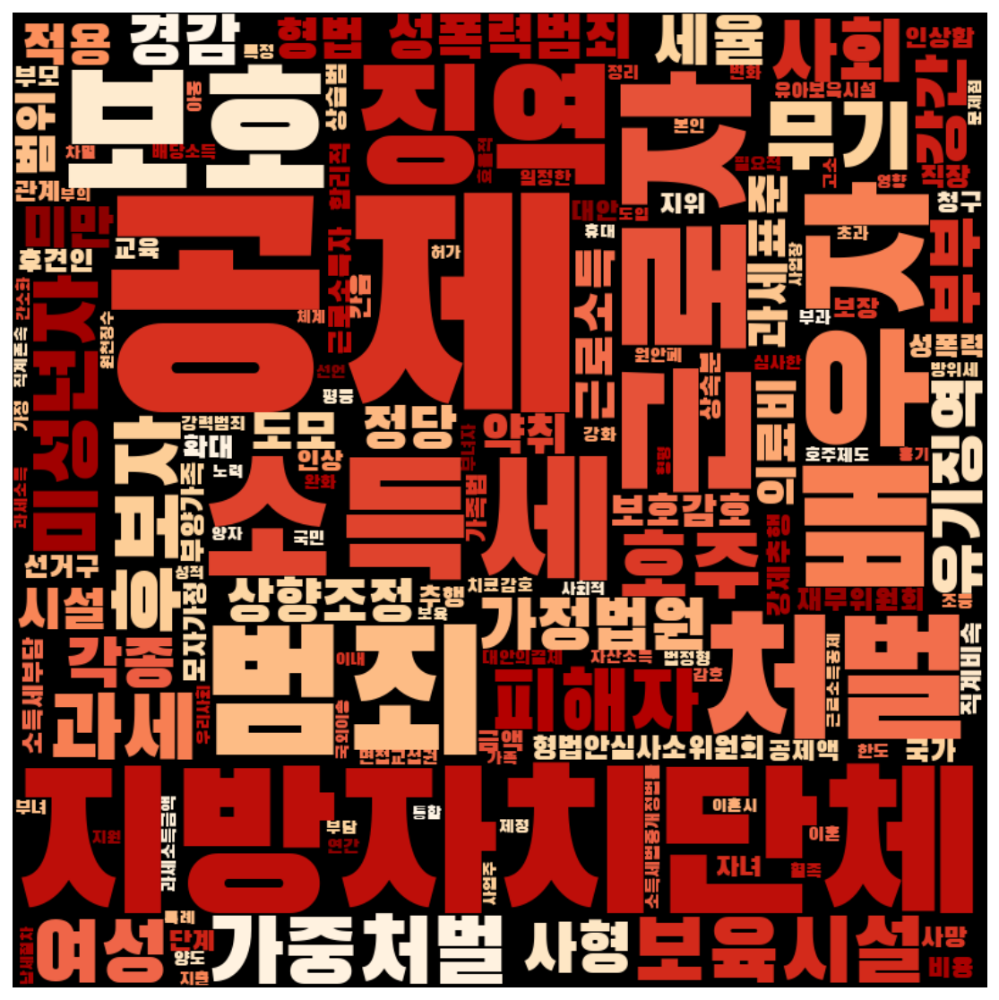

In [29]:
frewords_vis(government_word)
wordcloud_vis(government_word, 'OrRd')

## 김영삼 정권 
- 1993.02.25 ~ 1998.02.24

In [30]:
kimyoungsam = gender[(gender['제안일자'] >= datetime.date(1993,2,25)) & 
                        (gender['제안일자'] <= datetime.date(1998,2,24))]
kimyoungsam.shape

(62, 19)

In [31]:
kimyoungsam['소관위원회'].value_counts()

법제사법위원회      12
보건복지위원회      10
재정경제위원회       9
환경노동위원회       8
행정위원회         6
문화체육공보위원회     3
보건사회위원회       2
산업자원위원회       2
행정자치위원회       2
내무위원회         2
문화관광위원회       1
국회운영위원회       1
교육위원회         1
행정경제위원회       1
노동위원회         1
정무위원회         1
Name: 소관위원회, dtype: int64

<AxesSubplot:>

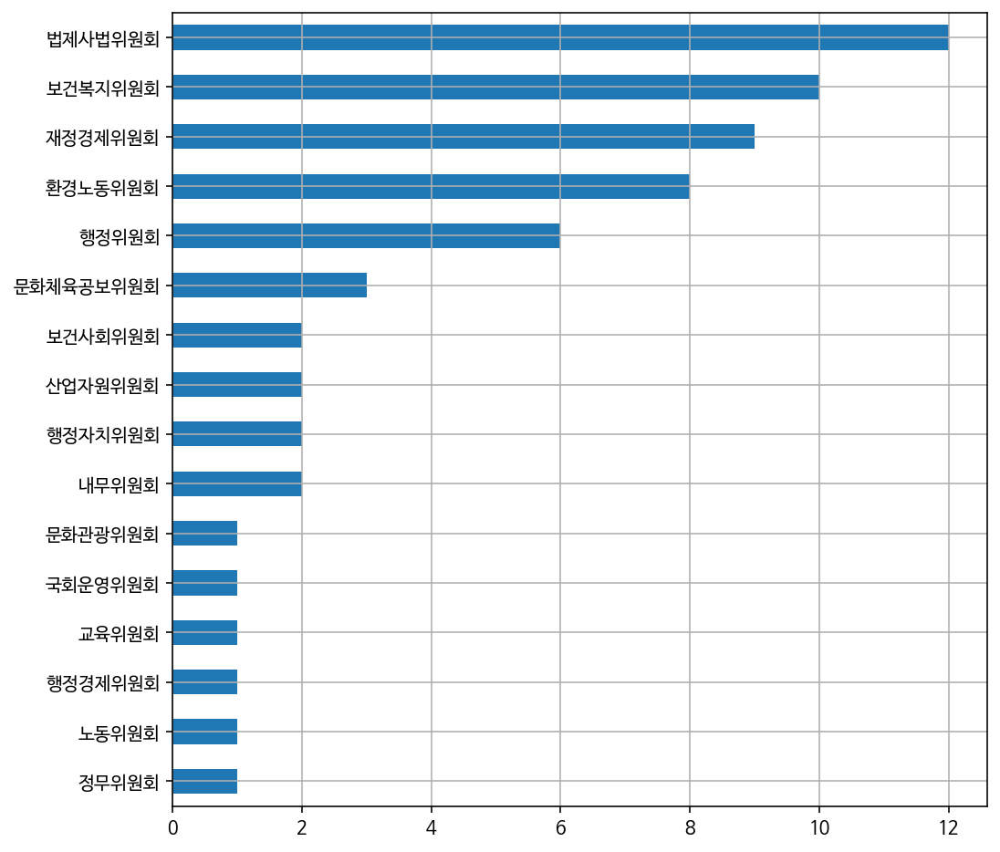

In [32]:
comm_df = kimyoungsam.copy()
comm_df = comm_df[comm_df['소관위원회'] != '미확정']

comm_df['소관위원회'].value_counts(ascending=True).plot(kind='barh', grid=True, figsize=(8,8))

In [33]:
model_government = Word2Vec(kimyoungsam['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-11-05 14:51:25,707 : INFO : collecting all words and their counts
2020-11-05 14:51:25,708 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-11-05 14:51:25,713 : INFO : collected 3134 word types from a corpus of 7814 raw words and 62 sentences
2020-11-05 14:51:25,714 : INFO : Loading a fresh vocabulary
2020-11-05 14:51:25,718 : INFO : effective_min_count=10 retains 119 unique words (3% of original 3134, drops 3015)
2020-11-05 14:51:25,719 : INFO : effective_min_count=10 leaves 2090 word corpus (26% of original 7814, drops 5724)
2020-11-05 14:51:25,720 : INFO : deleting the raw counts dictionary of 3134 items
2020-11-05 14:51:25,722 : INFO : sample=0.001 downsamples 119 most-common words
2020-11-05 14:51:25,722 : INFO : downsampling leaves estimated 944 word corpus (45.2% of prior 2090)
2020-11-05 14:51:25,724 : INFO : estimated required memory for 119 words and 100 dimensions: 154700 bytes
2020-11-05 14:51:25,725 : INFO : resetting layer weights
2020-1

2020-11-05 14:51:25,983 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:25,988 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:25,989 : INFO : EPOCH - 15 : training on 7814 raw words (958 effective words) took 0.0s, 111186 effective words/s
2020-11-05 14:51:25,995 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:25,996 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:25,996 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:26,001 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:26,002 : INFO : EPOCH - 16 : training on 7814 raw words (908 effective words) took 0.0s, 96567 effective words/s
2020-11-05 14:51:26,007 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:26,009 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 

2020-11-05 14:51:26,213 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:26,217 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:26,222 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:26,224 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:26,225 : INFO : EPOCH - 32 : training on 7814 raw words (960 effective words) took 0.0s, 81228 effective words/s
2020-11-05 14:51:26,235 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:26,244 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:26,248 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:26,249 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:26,251 : INFO : EPOCH - 33 : training on 7814 raw words (959 effective words) took 0.0s, 55028 effective words/s
2020-11-05 1

2020-11-05 14:51:26,456 : INFO : EPOCH - 48 : training on 7814 raw words (935 effective words) took 0.0s, 81944 effective words/s
2020-11-05 14:51:26,460 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:26,462 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:26,465 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:26,466 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:26,468 : INFO : EPOCH - 49 : training on 7814 raw words (898 effective words) took 0.0s, 119081 effective words/s
2020-11-05 14:51:26,472 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:26,474 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:26,476 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:26,478 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 

2020-11-05 14:51:26,668 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:26,668 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:26,670 : INFO : EPOCH - 65 : training on 7814 raw words (925 effective words) took 0.0s, 122921 effective words/s
2020-11-05 14:51:26,673 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:26,679 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:26,680 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:26,681 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:26,683 : INFO : EPOCH - 66 : training on 7814 raw words (910 effective words) took 0.0s, 86136 effective words/s
2020-11-05 14:51:26,690 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:26,692 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 

2020-11-05 14:51:26,889 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:26,891 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:26,893 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:26,895 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:26,898 : INFO : EPOCH - 82 : training on 7814 raw words (957 effective words) took 0.0s, 91668 effective words/s
2020-11-05 14:51:26,910 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:26,912 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:26,916 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:26,917 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:26,919 : INFO : EPOCH - 83 : training on 7814 raw words (938 effective words) took 0.0s, 85347 effective words/s
2020-11-05 1

2020-11-05 14:51:27,178 : INFO : EPOCH - 98 : training on 7814 raw words (957 effective words) took 0.0s, 74108 effective words/s
2020-11-05 14:51:27,185 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:27,186 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:27,188 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:27,190 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 14:51:27,191 : INFO : EPOCH - 99 : training on 7814 raw words (935 effective words) took 0.0s, 140525 effective words/s
2020-11-05 14:51:27,203 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-05 14:51:27,203 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-05 14:51:27,205 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-05 14:51:27,209 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-05 

In [34]:
print(model_government.wv.most_similar('여성'))

2020-11-05 14:51:27,236 : INFO : precomputing L2-norms of word weight vectors


[('남녀', 0.7987964749336243), ('도모', 0.7588805556297302), ('남녀평등', 0.7561129927635193), ('촉진', 0.7080587148666382), ('근로자', 0.5339147448539734), ('여성정책', 0.5098986625671387), ('평등', 0.5026174783706665), ('발전', 0.5013870596885681), ('확대', 0.48624250292778015), ('전환', 0.48384755849838257)]


In [35]:
government_word = total_tokens(kimyoungsam['tokens'])

In [36]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','만원이하','세부담',
            '현재','보고','중요','규정함','계산시','다음','퍼센트','기능']
government_word = [each_word for each_word in government_word if each_word not in stopwords]

In [37]:
ko = nltk.Text(government_word, name='김영삼 정권')
ko.vocab().most_common(20)

[('피해자', 70),
 ('보호', 63),
 ('지방자치단체', 61),
 ('여성', 54),
 ('가정폭력', 51),
 ('청소년', 48),
 ('강화', 42),
 ('가정', 35),
 ('국가', 34),
 ('근로자', 31),
 ('지원', 28),
 ('범위', 26),
 ('보완', 25),
 ('성폭력범죄', 25),
 ('예방', 24),
 ('보호처분', 24),
 ('보육시설', 22),
 ('처벌', 22),
 ('위반', 21),
 ('남녀평등', 20)]

In [38]:

print('부녀 단어 수:', ko.count('부녀'))
print('여자 단어 수:', ko.count('여자'))
print('여성 단어 수:', ko.count('여성'))
print('젠더 단어 수:', ko.count('젠더'))
print()

print('여성발전 단어 수:', ko.count('여성발전'))
print('남녀평등 단어 수:', ko.count('남녀평등'))
print('양성평등 단어 수:', ko.count('양성평등'))
print('성평등 단어 수:', ko.count('성평등'))
print('성인지적 단어 수:', ko.count('성인지적'))
print('성주류화 단어 수:', ko.count('성주류화'))
print()

print('청소년 단어 수:', ko.count('청소년'))
print('아동 단어 수:', ko.count('아동'))

부녀 단어 수: 0
여자 단어 수: 1
여성 단어 수: 54
젠더 단어 수: 0

여성발전 단어 수: 2
남녀평등 단어 수: 20
양성평등 단어 수: 1
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 48
아동 단어 수: 14


In [174]:
# 호주제
print('호주제 단어 수:', ko.count('호주제'))
print('가족법 단어 수:', ko.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko.count('저출산'))
print('육아휴직 단어 수:', ko.count('육아휴직'))
print('보육 단어 수:', ko.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko.count('위안부'))
print('일본군성노예제 단어 수:', ko.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko.count('성범죄'))
print('강간 단어 수:', ko.count('강간'))
print('성희롱 단어 수:', ko.count('성희롱'))
print('성폭력 단어 수:', ko.count('성폭력'))
print('성폭력범죄 단어 수:', ko.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko.count('윤락'))
print('윤락행위 단어 수:', ko.count('윤락행위'))
print('기생관광 단어 수:', ko.count('기생관광'))
print('성매매 단어 수:', ko.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko.count('낙태'))
print('임신중절 단어 수:', ko.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko.count('불법촬영'))
print('몰카 단어 수:', ko.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 5
보육 단어 수: 6

위안부 단어 수: 6
일본군성노예제 단어 수: 0

성범죄 단어 수: 1
강간 단어 수: 13
성희롱 단어 수: 12
성폭력 단어 수: 12
성폭력범죄 단어 수: 25

윤락 단어 수: 0
윤락행위 단어 수: 6
기생관광 단어 수: 0
성매매 단어 수: 0

가정폭력 단어 수: 51

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 0

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0


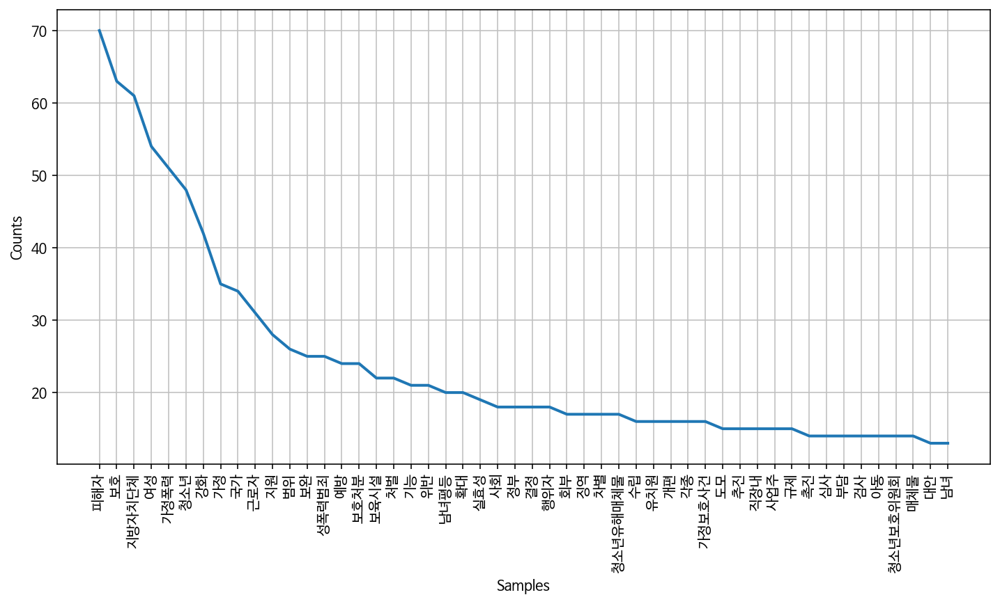

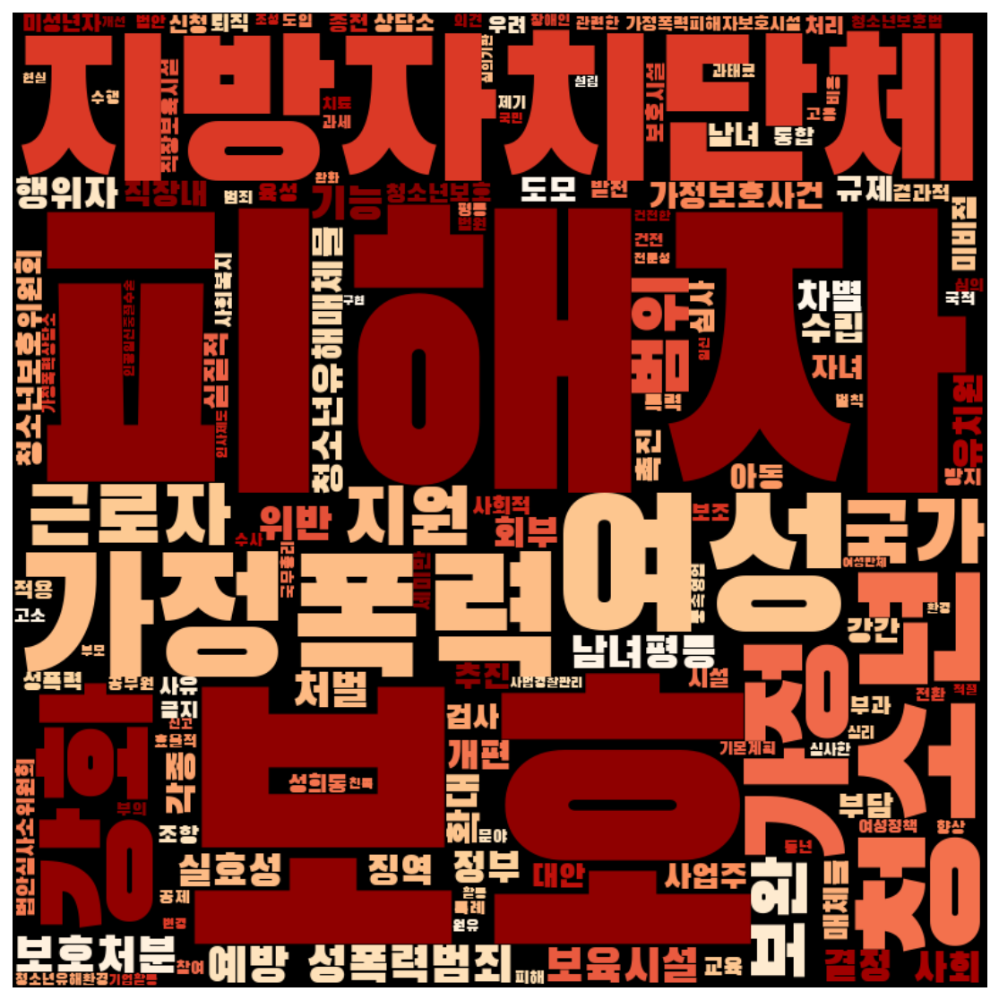

In [38]:
frewords_vis(government_word)
wordcloud_vis(government_word, 'OrRd')

In [39]:
kimyoungsam['문장벡터'] = kimyoungsam['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))

<ipython-input-39-00585b52f52f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  kimyoungsam['문장벡터'] = kimyoungsam['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))


In [40]:
# K means 수행 
word_vectors = kimyoungsam['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors)
kimyoungsam['category'] = idx

<ipython-input-40-37d02800ccbd>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  kimyoungsam['category'] = idx


In [41]:
kimyoungsam['category'].value_counts()

1    32
0    21
2     9
Name: category, dtype: int64

In [42]:
kimyoungsam_g1 = kimyoungsam[kimyoungsam['category'] == 0]
kimyoungsam_g2 = kimyoungsam[kimyoungsam['category'] == 1]
kimyoungsam_g3 = kimyoungsam[kimyoungsam['category'] == 2]

In [43]:
kimyoungsam_g1_tokens = total_tokens(kimyoungsam_g1['tokens'])
kimyoungsam_g2_tokens = total_tokens(kimyoungsam_g2['tokens'])
kimyoungsam_g3_tokens = total_tokens(kimyoungsam_g3['tokens'])

In [44]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','퍼센트',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
kimyoungsam_g1_tokens = [each_word for each_word in kimyoungsam_g1_tokens if each_word not in stopwords]
kimyoungsam_g2_tokens = [each_word for each_word in kimyoungsam_g2_tokens if each_word not in stopwords]
kimyoungsam_g3_tokens = [each_word for each_word in kimyoungsam_g3_tokens if each_word not in stopwords]

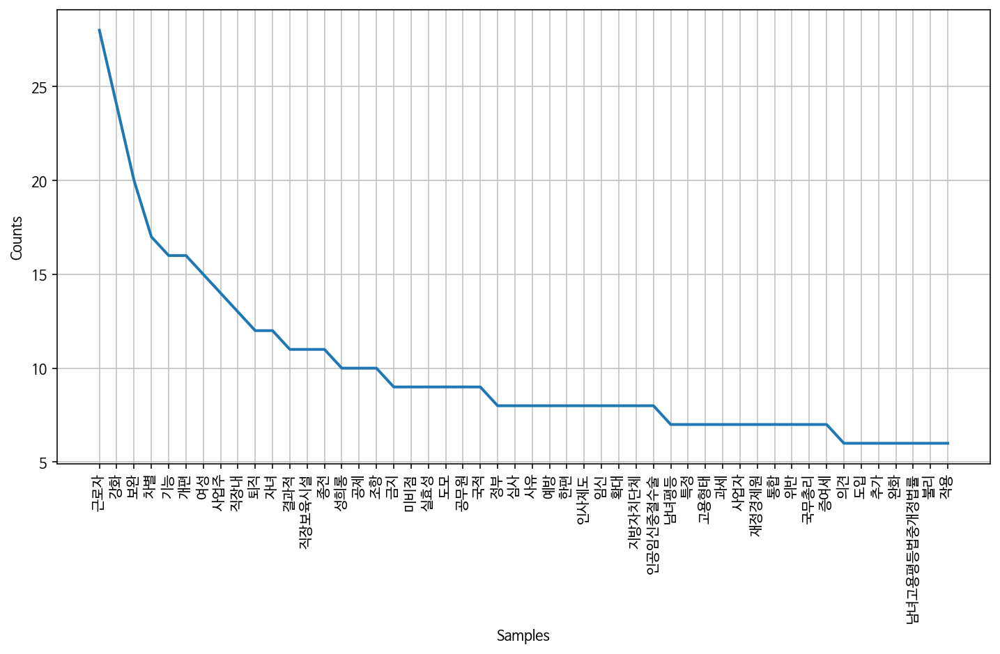

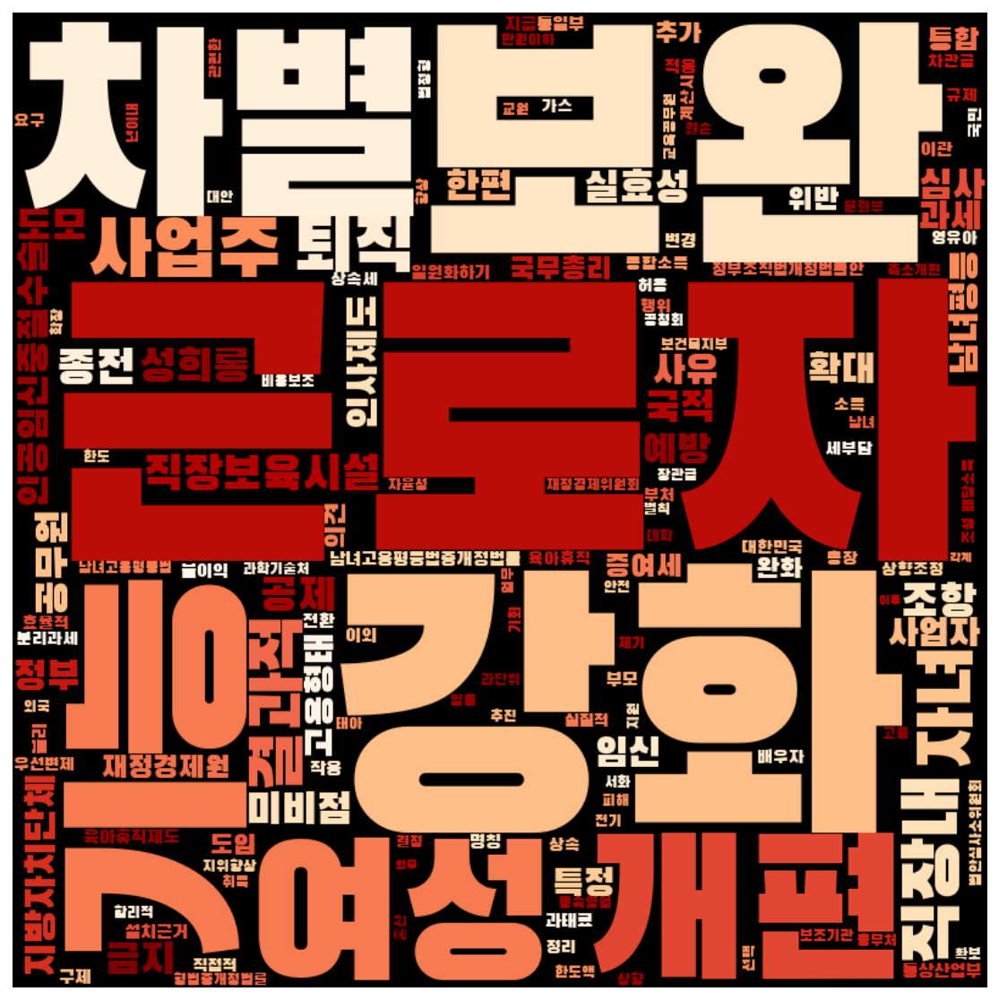

In [45]:
frewords_vis(kimyoungsam_g1_tokens)
wordcloud_vis(kimyoungsam_g1_tokens, 'OrRd')

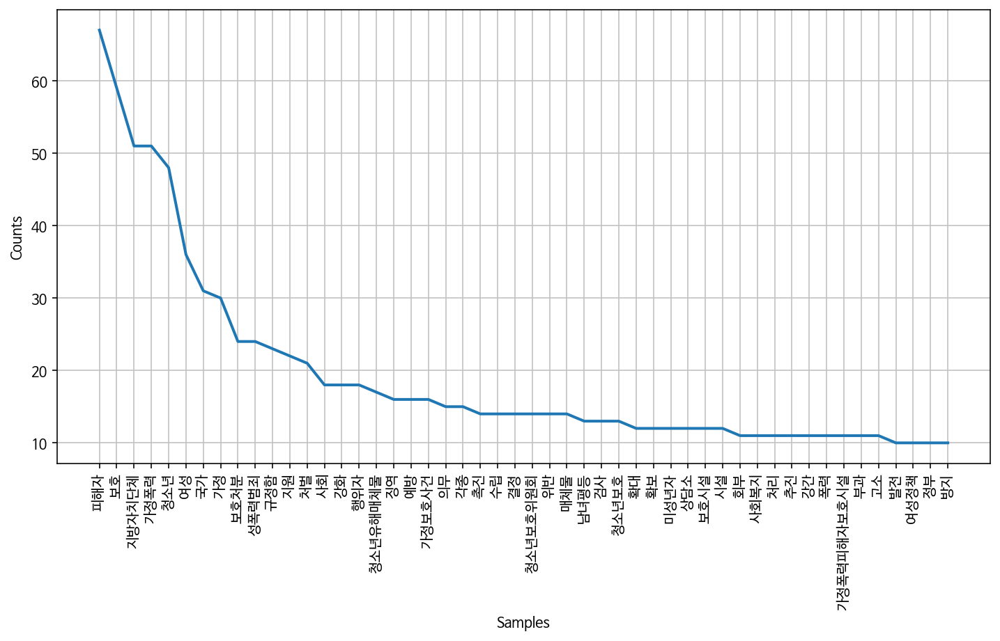

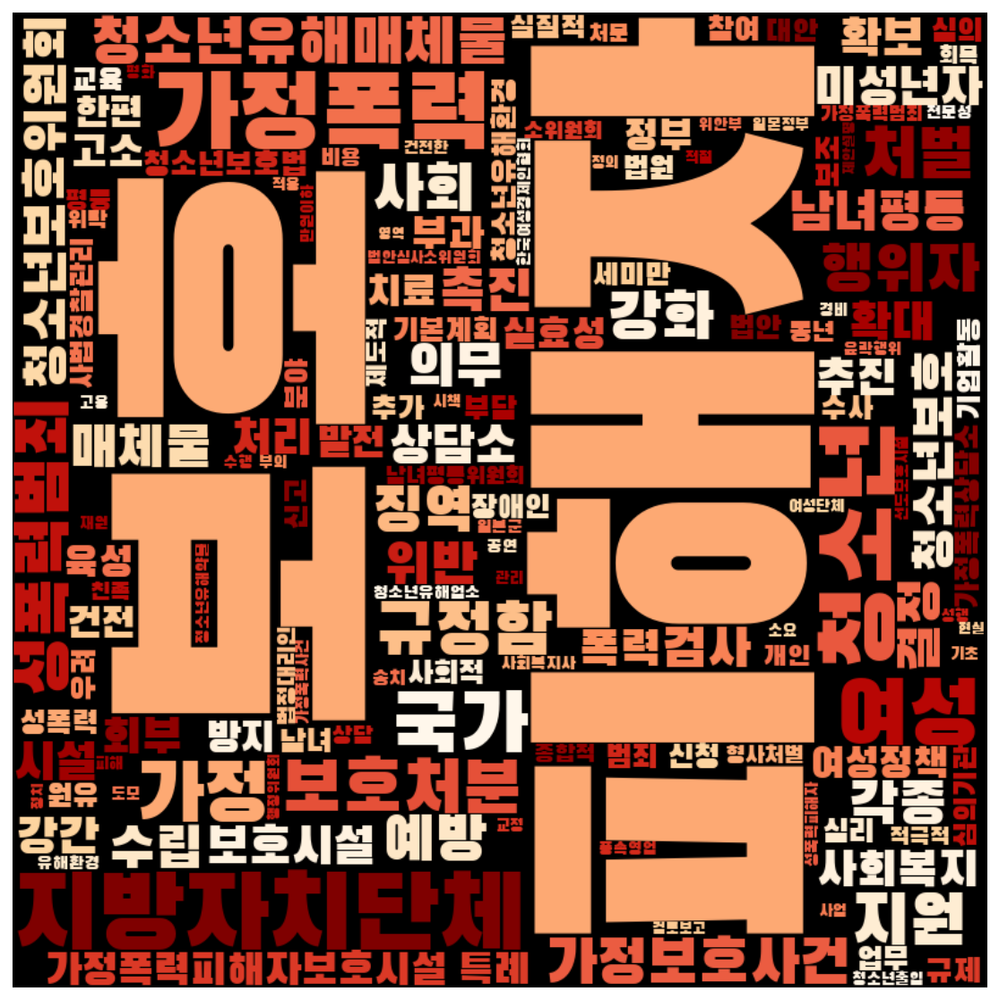

In [46]:
frewords_vis(kimyoungsam_g2_tokens)
wordcloud_vis(kimyoungsam_g2_tokens, 'OrRd')

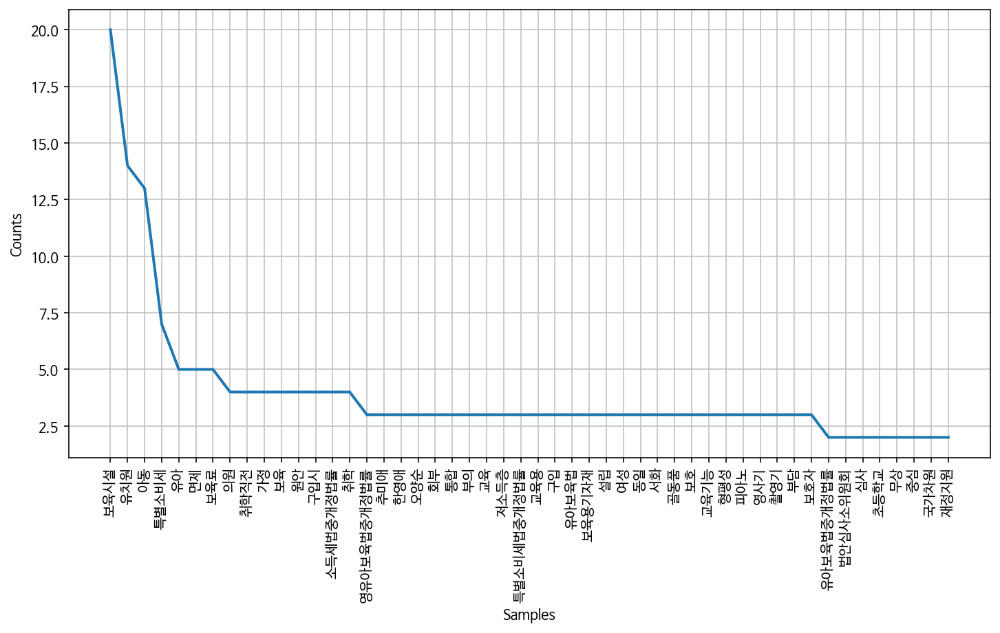

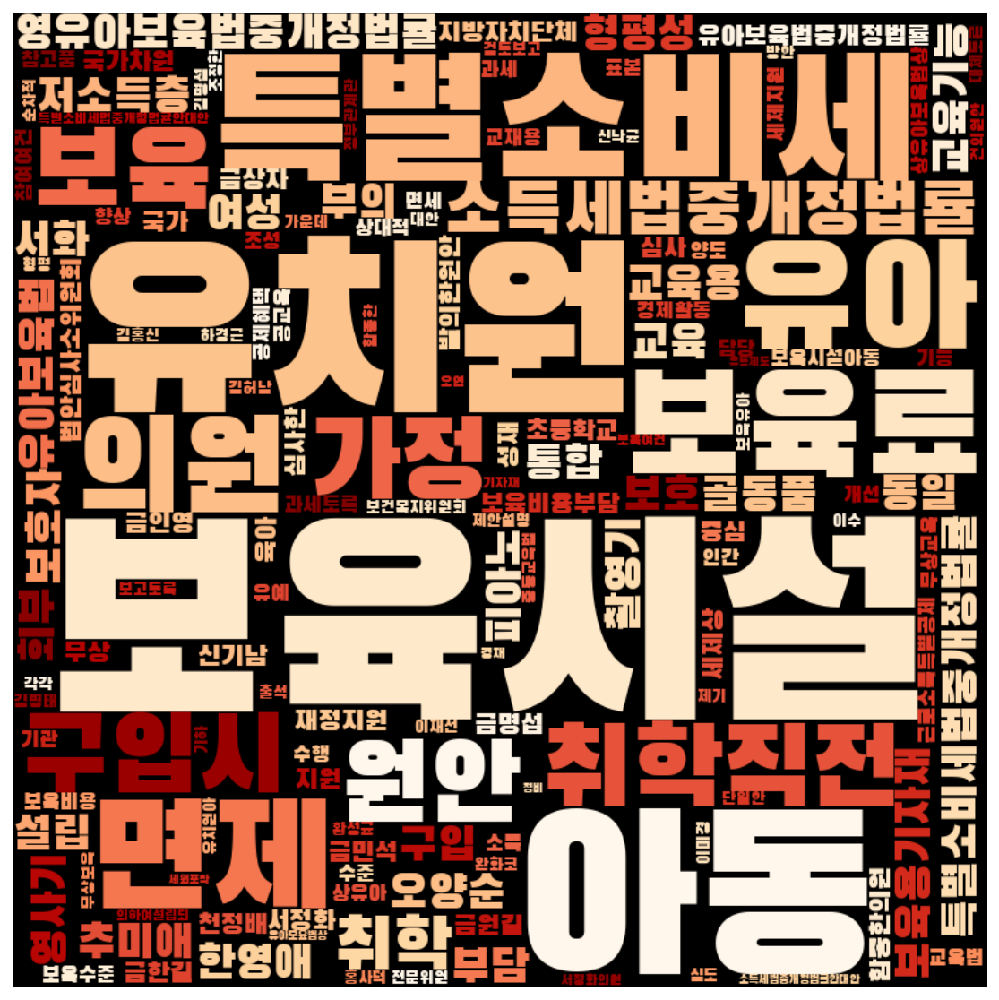

In [47]:
frewords_vis(kimyoungsam_g3_tokens)
wordcloud_vis(kimyoungsam_g3_tokens, 'OrRd')

## 김대중 정권 
- 1998.02.25 ~ 2003.02.24

In [78]:
kimdaejoong = gender[(gender['제안일자'] >= datetime.date(1998,2,25)) & 
                        (gender['제안일자'] <= datetime.date(2003,2,24))]
kimdaejoong.shape

(92, 19)

In [79]:
kimdaejoong['소관위원회'].value_counts()

보건복지위원회        17
환경노동위원회        12
정무위원회          11
행정자치위원회        10
국회운영위원회         9
정치개혁특별위원회       8
법제사법위원회         7
교육위원회           7
산업자원위원회         3
과학기술정보통신위원회     3
농림해양수산위원회       2
재정경제위원회         1
여성위원회           1
미확정             1
Name: 소관위원회, dtype: int64

<AxesSubplot:>

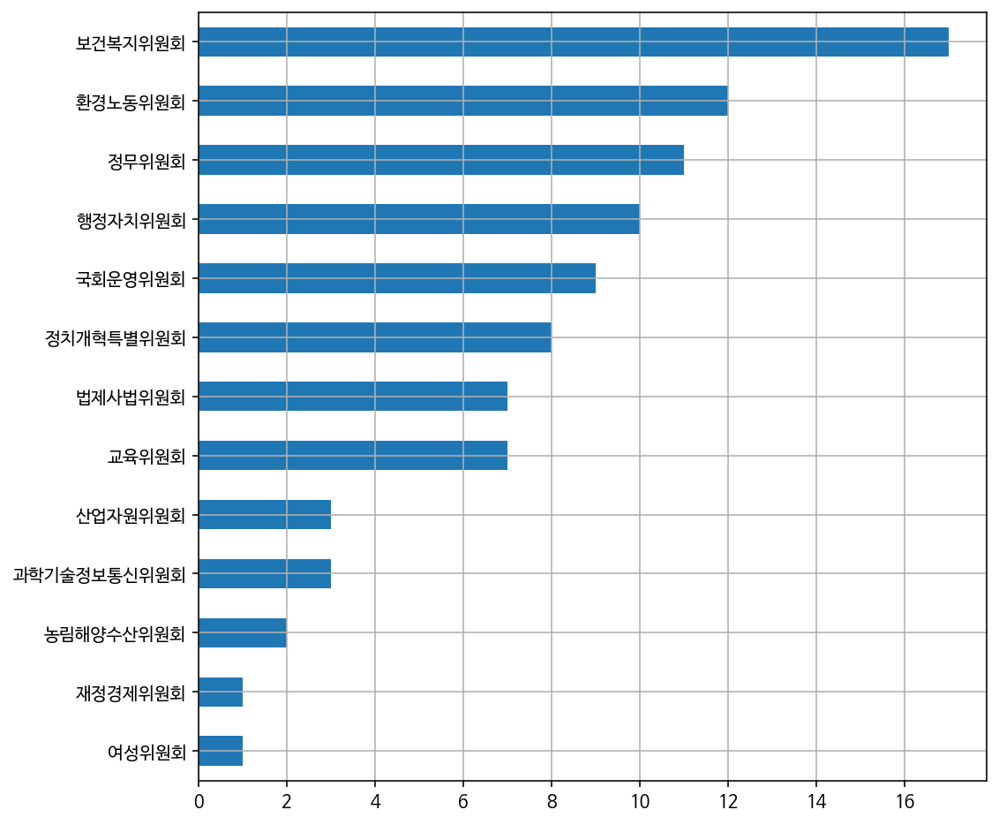

In [80]:
comm_df = kimdaejoong.copy()
comm_df = comm_df[comm_df['소관위원회'] != '미확정']

comm_df['소관위원회'].value_counts(ascending=True).plot(kind='barh', grid=True, figsize=(8,8))

In [81]:
model_government = Word2Vec(kimdaejoong['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-11-03 21:42:11,786 : INFO : collecting all words and their counts
2020-11-03 21:42:11,788 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-11-03 21:42:11,793 : INFO : collected 3451 word types from a corpus of 10680 raw words and 92 sentences
2020-11-03 21:42:11,795 : INFO : Loading a fresh vocabulary
2020-11-03 21:42:11,798 : INFO : effective_min_count=10 retains 198 unique words (5% of original 3451, drops 3253)
2020-11-03 21:42:11,799 : INFO : effective_min_count=10 leaves 3856 word corpus (36% of original 10680, drops 6824)
2020-11-03 21:42:11,802 : INFO : deleting the raw counts dictionary of 3451 items
2020-11-03 21:42:11,803 : INFO : sample=0.001 downsamples 167 most-common words
2020-11-03 21:42:11,804 : INFO : downsampling leaves estimated 2384 word corpus (61.8% of prior 3856)
2020-11-03 21:42:11,807 : INFO : estimated required memory for 198 words and 100 dimensions: 257400 bytes
2020-11-03 21:42:11,808 : INFO : resetting layer weights
202

2020-11-03 21:42:12,153 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:12,165 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:12,166 : INFO : EPOCH - 15 : training on 10680 raw words (2374 effective words) took 0.0s, 156873 effective words/s
2020-11-03 21:42:12,170 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:12,172 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:12,173 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:12,184 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:12,185 : INFO : EPOCH - 16 : training on 10680 raw words (2396 effective words) took 0.0s, 156691 effective words/s
2020-11-03 21:42:12,190 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:12,191 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-11-03 21:42:12,509 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:12,511 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:12,512 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:12,524 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:12,524 : INFO : EPOCH - 32 : training on 10680 raw words (2359 effective words) took 0.0s, 156714 effective words/s
2020-11-03 21:42:12,528 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:12,529 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:12,530 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:12,542 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:12,542 : INFO : EPOCH - 33 : training on 10680 raw words (2354 effective words) took 0.0s, 166223 effective words/s
2020-1

2020-11-03 21:42:12,917 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:12,918 : INFO : EPOCH - 48 : training on 10680 raw words (2363 effective words) took 0.0s, 120609 effective words/s
2020-11-03 21:42:12,921 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:12,926 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:12,930 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:12,938 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:12,938 : INFO : EPOCH - 49 : training on 10680 raw words (2371 effective words) took 0.0s, 139092 effective words/s
2020-11-03 21:42:12,944 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:12,946 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:12,947 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-11-03 21:42:13,269 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:13,271 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:13,282 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:13,283 : INFO : EPOCH - 65 : training on 10680 raw words (2410 effective words) took 0.0s, 149123 effective words/s
2020-11-03 21:42:13,295 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:13,301 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:13,305 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:13,307 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:13,308 : INFO : EPOCH - 66 : training on 10680 raw words (2369 effective words) took 0.0s, 166166 effective words/s
2020-11-03 21:42:13,316 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-11-03 21:42:13,674 : INFO : EPOCH - 81 : training on 10680 raw words (2381 effective words) took 0.0s, 130036 effective words/s
2020-11-03 21:42:13,678 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:13,679 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:13,681 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:13,693 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:13,694 : INFO : EPOCH - 82 : training on 10680 raw words (2403 effective words) took 0.0s, 145172 effective words/s
2020-11-03 21:42:13,704 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:13,711 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:13,712 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:13,718 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-11-03 21:42:14,043 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:14,049 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:14,049 : INFO : EPOCH - 98 : training on 10680 raw words (2394 effective words) took 0.0s, 106651 effective words/s
2020-11-03 21:42:14,055 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:14,057 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:42:14,061 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:42:14,070 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:42:14,072 : INFO : EPOCH - 99 : training on 10680 raw words (2364 effective words) took 0.0s, 134892 effective words/s
2020-11-03 21:42:14,081 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:42:14,086 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

In [82]:
print(model_government.wv.most_similar('여성'))

2020-11-03 21:42:14,114 : INFO : precomputing L2-norms of word weight vectors


[('산전후', 0.4154170751571655), ('합리적', 0.4150104820728302), ('부의', 0.4028557538986206), ('부담', 0.38414180278778076), ('신설', 0.37187841534614563), ('정당', 0.35731804370880127), ('적극적', 0.3464604914188385), ('임신', 0.3445279896259308), ('추천', 0.3402595818042755), ('근로자', 0.3292200565338135)]


In [83]:
government_word = total_tokens(kimdaejoong['tokens'])

In [84]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','수립','보완','규정함',
            '회부','수정','법안심사소위원회','개선','범위','대안']
government_word = [each_word for each_word in government_word if each_word not in stopwords]

In [85]:
ko = nltk.Text(government_word, name='김대중 정권')
ko.vocab().most_common(20)

[('청소년', 177),
 ('아동', 115),
 ('여성', 99),
 ('피해자', 51),
 ('보호', 50),
 ('확대', 50),
 ('지방자치단체', 49),
 ('정당', 47),
 ('강화', 44),
 ('근로자', 44),
 ('지원', 42),
 ('보육시설', 35),
 ('처벌', 32),
 ('공무원', 28),
 ('교육', 28),
 ('정부', 26),
 ('국가', 25),
 ('성희롱', 25),
 ('육아휴직', 24),
 ('휴직', 24)]

In [86]:
print('총 토큰 수:', len(ko.tokens))
print(ko.vocab())

총 토큰 수: 9870
<FreqDist with 3419 samples and 9870 outcomes>


In [87]:

print('부녀 단어 수:', ko.count('부녀'))
print('여자 단어 수:', ko.count('여자'))
print('여성 단어 수:', ko.count('여성'))
print('젠더 단어 수:', ko.count('젠더'))
print()

print('남녀평등 단어 수:', ko.count('남녀평등'))
print('양성평등 단어 수:', ko.count('양성평등'))
print('성평등 단어 수:', ko.count('성평등'))
print('성인지적 단어 수:', ko.count('성인지적'))
print('성주류화 단어 수:', ko.count('성주류화'))
print()

print('청소년 단어 수:', ko.count('청소년'))
print('아동 단어 수:', ko.count('아동'))
print('저출산 단어 수:', ko.count('저출산'))

부녀 단어 수: 0
여자 단어 수: 3
여성 단어 수: 99
젠더 단어 수: 0

남녀평등 단어 수: 14
양성평등 단어 수: 1
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 177
아동 단어 수: 115
저출산 단어 수: 0


In [88]:
# 호주제
print('호주제 단어 수:', ko.count('호주제'))
print('가족법 단어 수:', ko.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko.count('저출산'))
print('육아휴직 단어 수:', ko.count('육아휴직'))
print('보육 단어 수:', ko.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko.count('위안부'))
print('일본군성노예제 단어 수:', ko.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko.count('성범죄'))
print('강간 단어 수:', ko.count('강간'))
print('성희롱 단어 수:', ko.count('성희롱'))
print('성폭력 단어 수:', ko.count('성폭력'))
print('성폭력범죄 단어 수:', ko.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko.count('윤락'))
print('윤락행위 단어 수:', ko.count('윤락행위'))
print('기생관광 단어 수:', ko.count('기생관광'))
print('성매매 단어 수:', ko.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko.count('낙태'))
print('임신중절 단어 수:', ko.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko.count('불법촬영'))
print('몰카 단어 수:', ko.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 0
육아휴직 단어 수: 24
보육 단어 수: 20

위안부 단어 수: 0
일본군성노예제 단어 수: 13

성범죄 단어 수: 0
강간 단어 수: 4
성희롱 단어 수: 25
성폭력 단어 수: 8
성폭력범죄 단어 수: 2

윤락 단어 수: 0
윤락행위 단어 수: 1
기생관광 단어 수: 0
성매매 단어 수: 12

가정폭력 단어 수: 3

낙태 단어 수: 0
임신중절 단어 수: 0

스토킹 단어 수: 3

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0


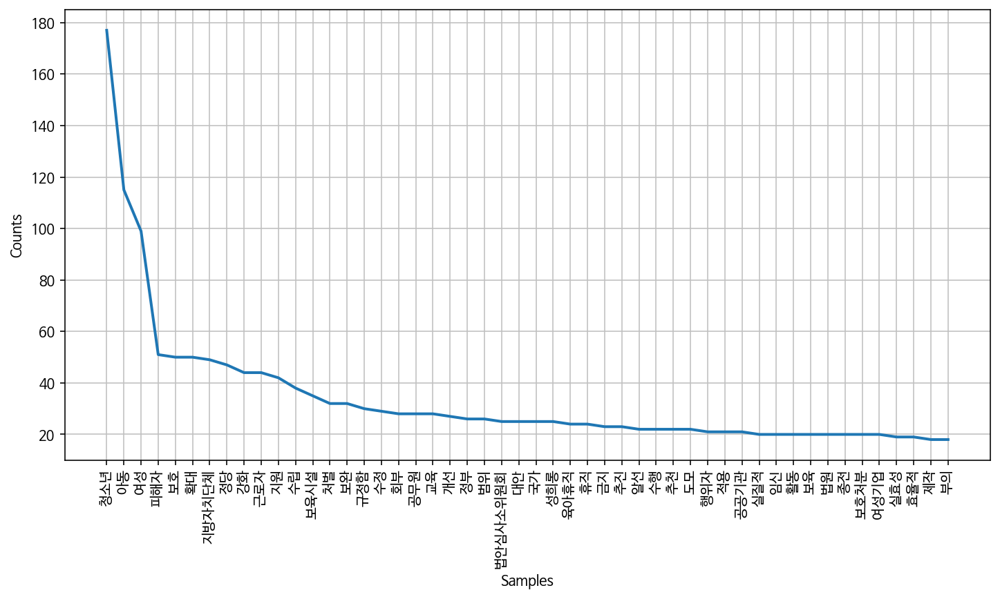

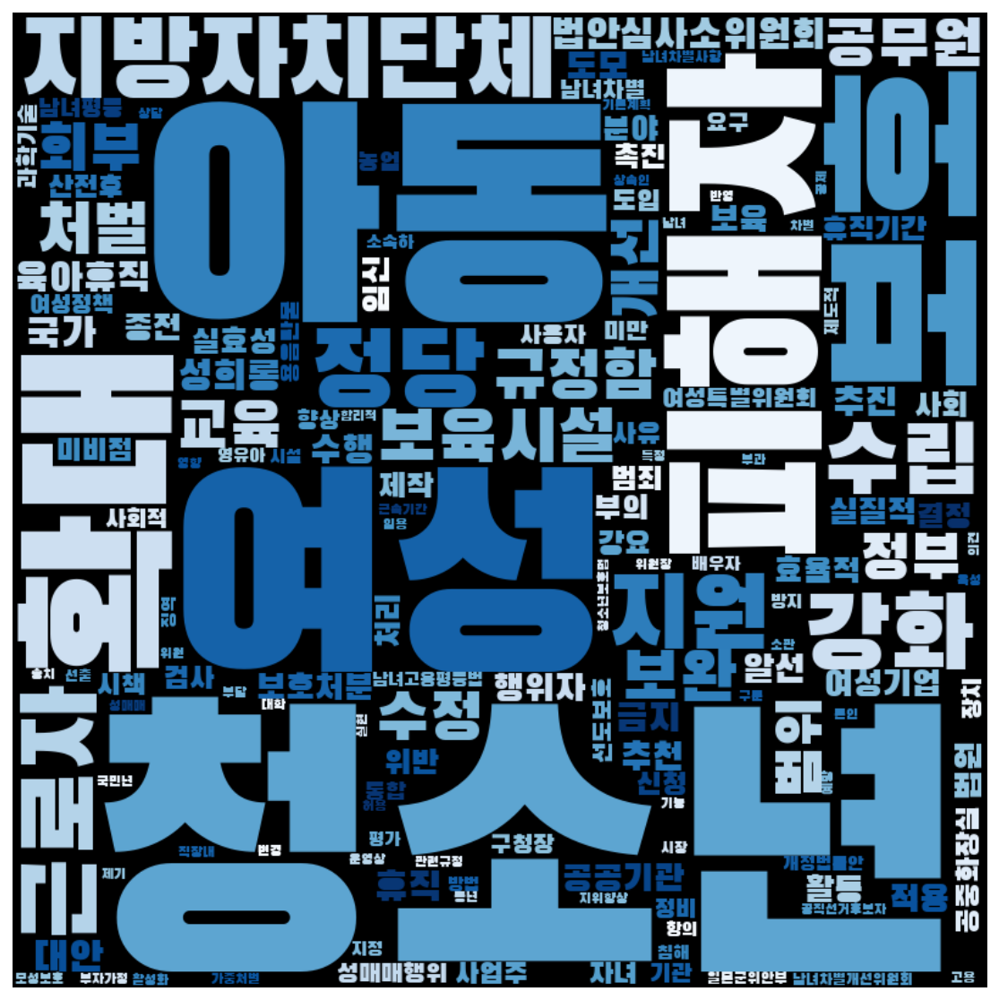

In [57]:
frewords_vis(government_word)
wordcloud_vis(government_word, 'Blues')

In [58]:
kimdaejoong['문장벡터'] = kimdaejoong['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))

/usr/local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
<ipython-input-58-9dc77c7374db>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  kimdaejoong['문장벡터'] = kimdaejoong['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))


In [59]:
kimdaejoong = kimdaejoong[kimdaejoong['명사수'] > 1]

In [60]:
# K means 수행 
word_vectors = kimdaejoong['문장벡터'].to_list()
num_clusters = 4

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors)
kimdaejoong['category'] = idx

In [61]:
kimdaejoong['category'].value_counts()

0    37
2    28
1    15
3    11
Name: category, dtype: int64

In [62]:
kimdaejoong_g1 = kimdaejoong[kimdaejoong['category'] == 0]
kimdaejoong_g2 = kimdaejoong[kimdaejoong['category'] == 1]
kimdaejoong_g3 = kimdaejoong[kimdaejoong['category'] == 2]
kimdaejoong_g4 = kimdaejoong[kimdaejoong['category'] == 3]

In [63]:
kimdaejoong_g1_tokens = total_tokens(kimdaejoong_g1['tokens'])
kimdaejoong_g2_tokens = total_tokens(kimdaejoong_g2['tokens'])
kimdaejoong_g3_tokens = total_tokens(kimdaejoong_g3['tokens'])
kimdaejoong_g4_tokens = total_tokens(kimdaejoong_g4['tokens'])

In [64]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
kimdaejoong_g1_tokens = [each_word for each_word in kimdaejoong_g1_tokens if each_word not in stopwords]
kimdaejoong_g2_tokens = [each_word for each_word in kimdaejoong_g2_tokens if each_word not in stopwords]
kimdaejoong_g3_tokens = [each_word for each_word in kimdaejoong_g3_tokens if each_word not in stopwords]
kimdaejoong_g4_tokens = [each_word for each_word in kimdaejoong_g4_tokens if each_word not in stopwords]

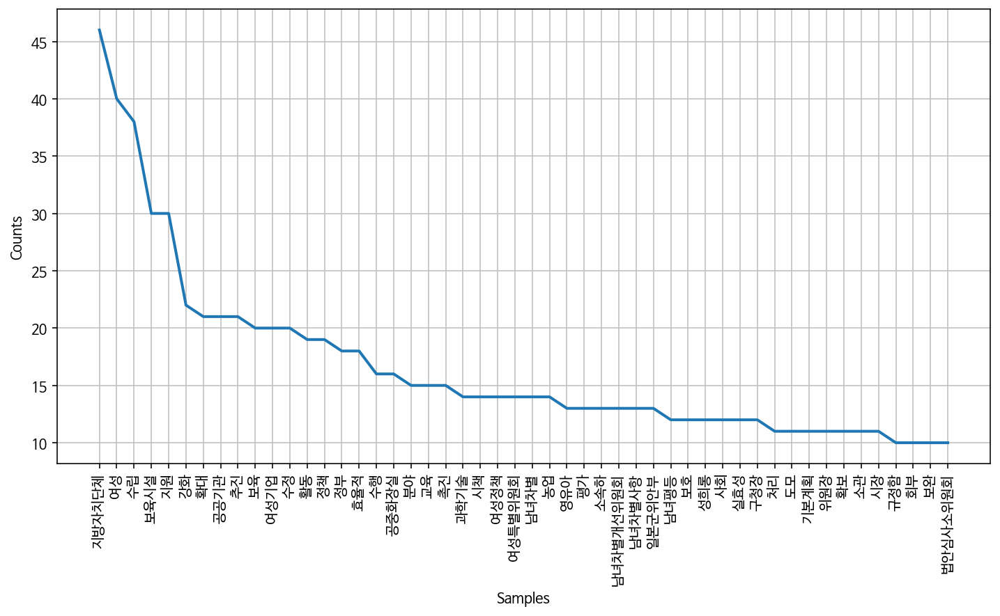

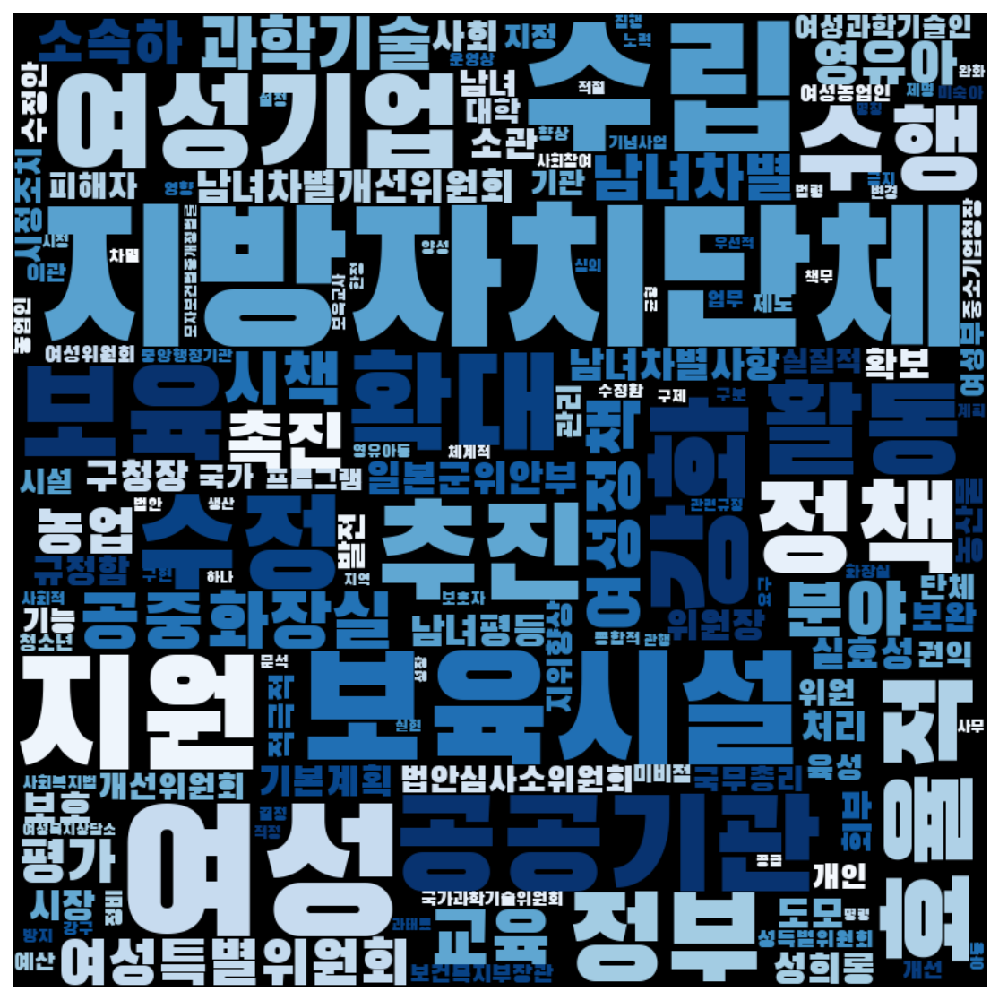

In [65]:
frewords_vis(kimdaejoong_g1_tokens)
wordcloud_vis(kimdaejoong_g1_tokens, 'Blues')

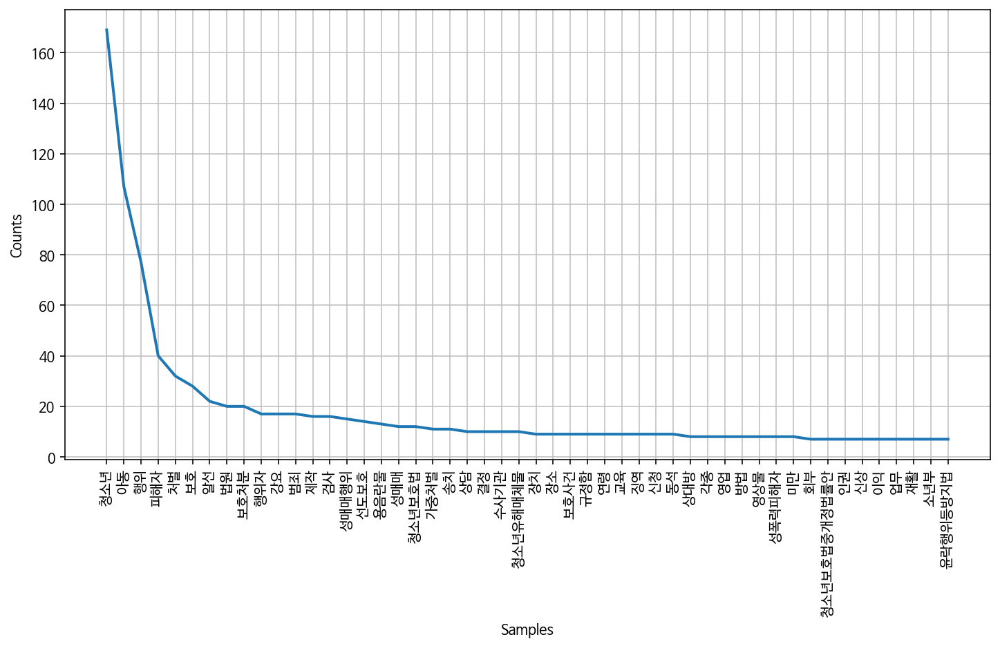

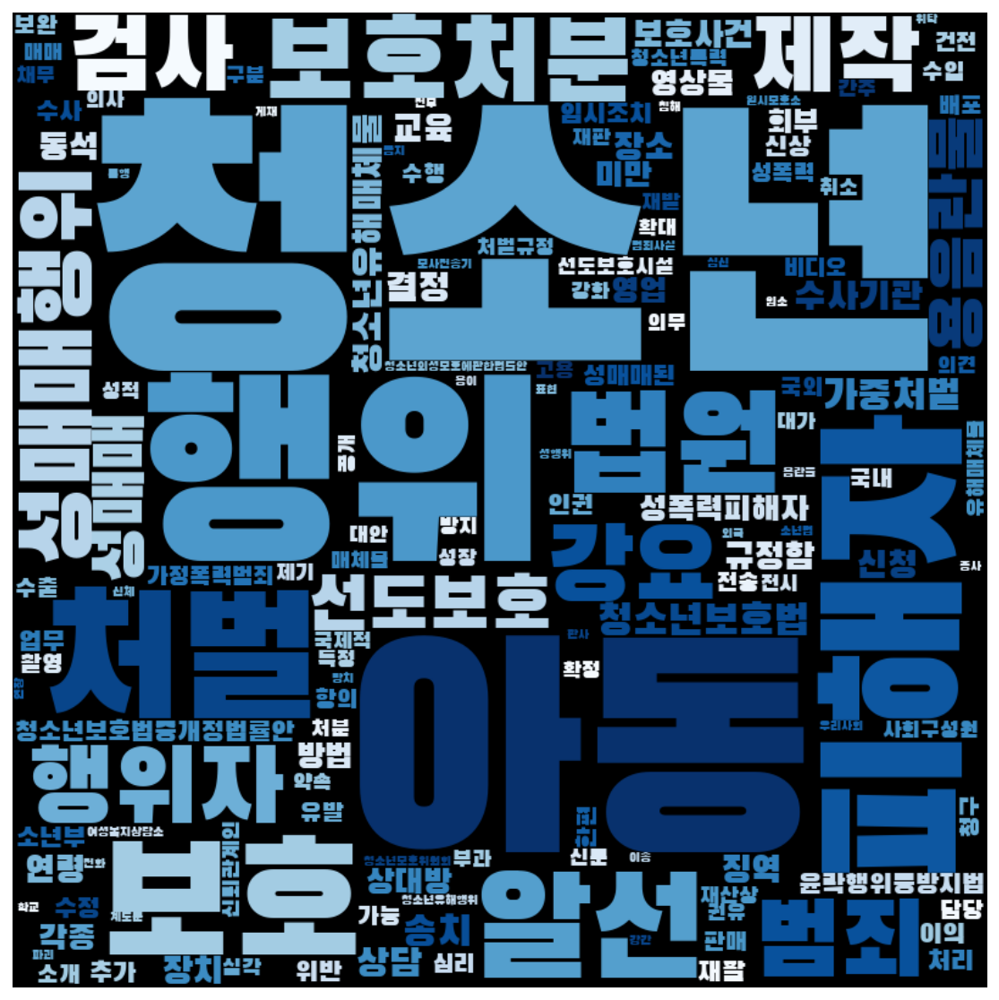

In [66]:
frewords_vis(kimdaejoong_g2_tokens)
wordcloud_vis(kimdaejoong_g2_tokens, 'Blues')

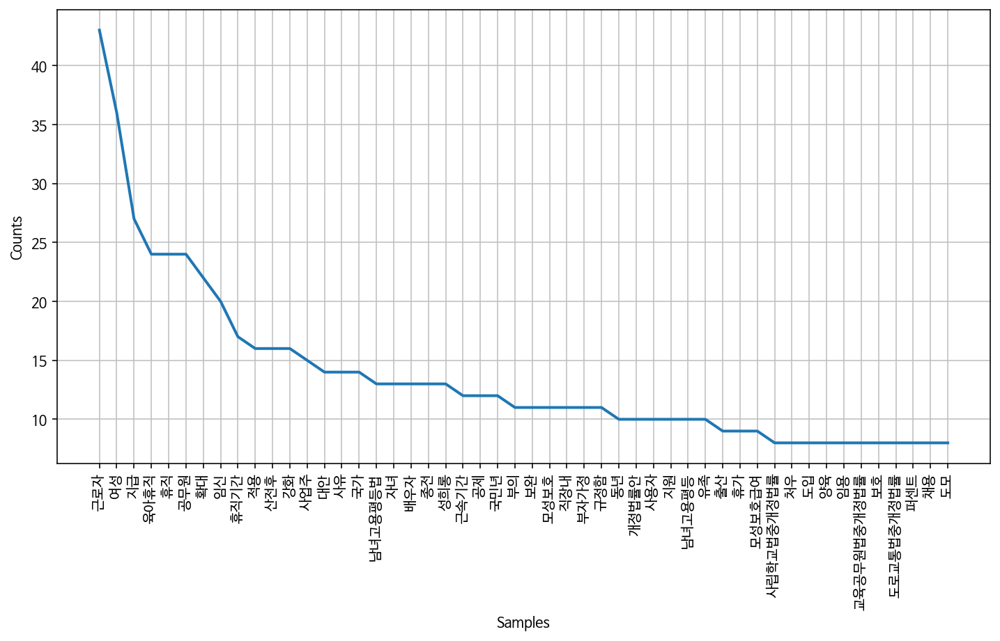

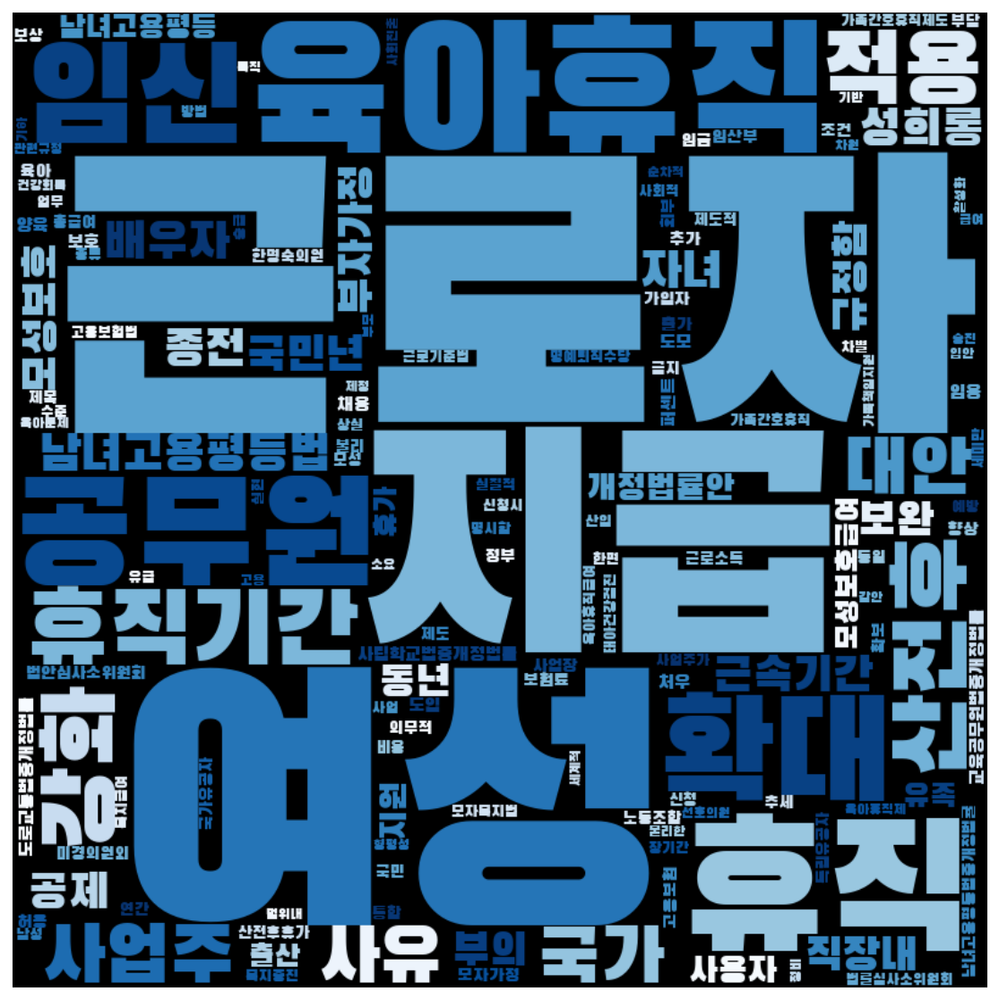

In [67]:
frewords_vis(kimdaejoong_g3_tokens)
wordcloud_vis(kimdaejoong_g3_tokens, 'Blues')

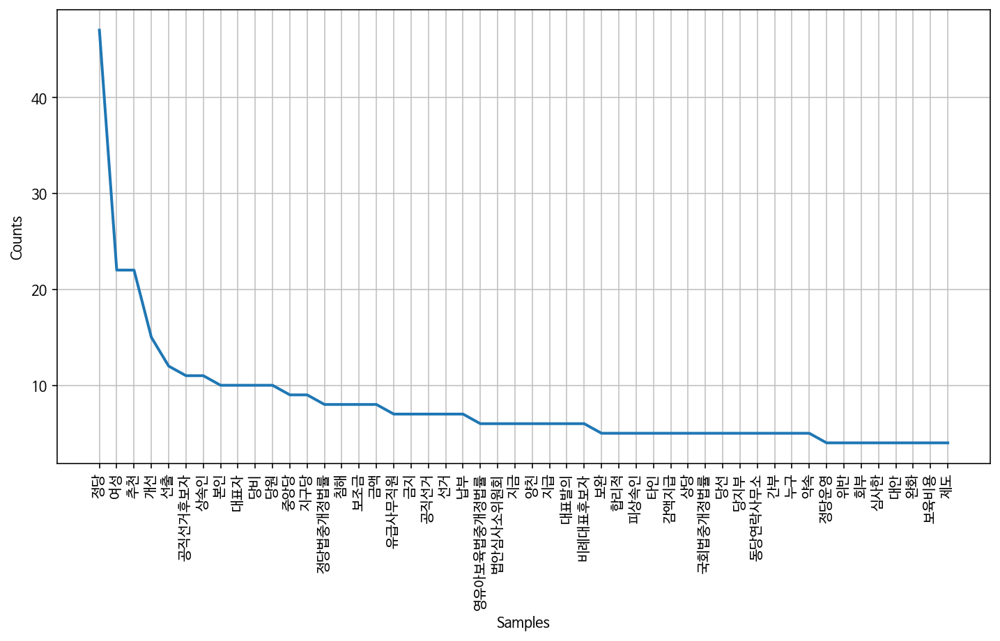

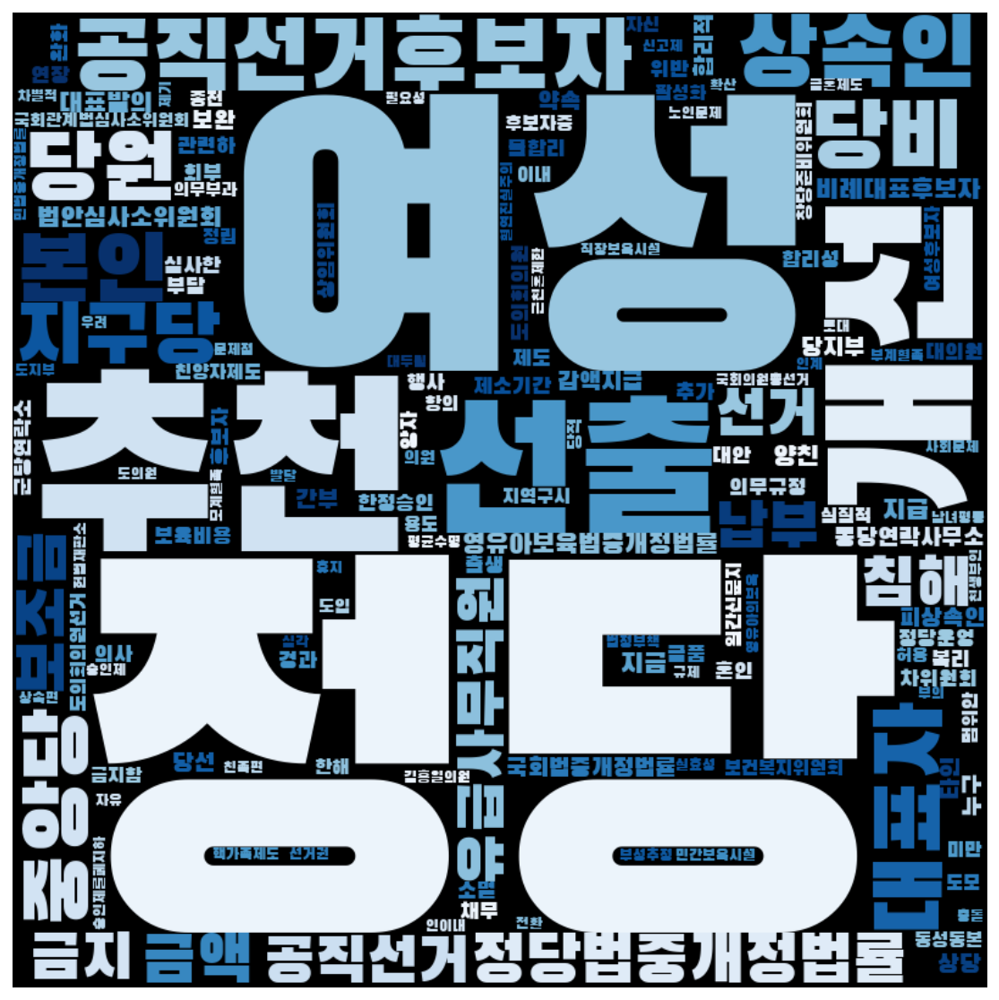

In [68]:
frewords_vis(kimdaejoong_g4_tokens)
wordcloud_vis(kimdaejoong_g4_tokens, 'Blues')

## 노무현 정권  
- 2003.02.25 ~ 2004.04.14

In [68]:
romoohyun = gender[(gender['제안일자'] >= datetime.date(2003,2,25)) & 
                   (gender['제안일자'] <= datetime.date(2008,2,24))]
romoohyun.shape

(447, 19)

In [69]:
romoohyun['소관위원회'].value_counts()

법제사법위원회        82
환경노동위원회        71
여성가족위원회        69
보건복지위원회        61
행정자치위원회        43
재정경제위원회        29
정무위원회          28
교육위원회          21
농림해양수산위원회      10
국방위원회           9
여성위원회           8
산업자원위원회         3
문화관광위원회         3
국회운영위원회         3
과학기술정보통신위원회     2
건설교통위원회         2
정치개혁특별위원회       1
통일외교통상위원회       1
국회개혁특별위원회       1
Name: 소관위원회, dtype: int64

<AxesSubplot:>

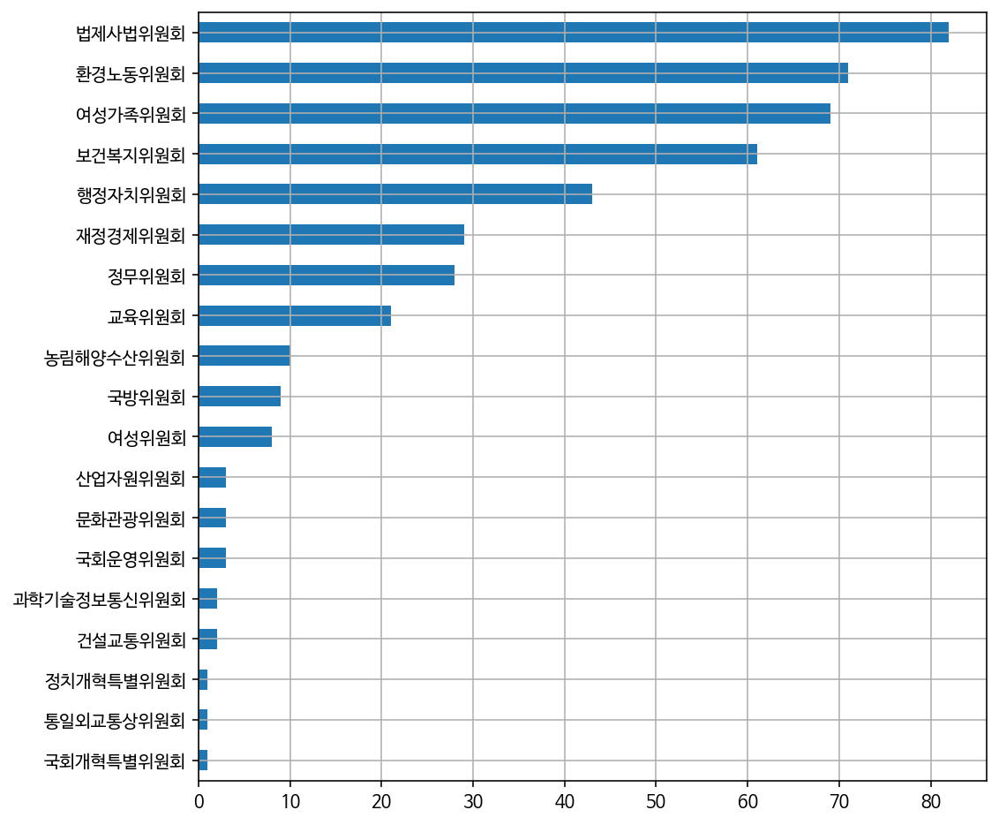

In [70]:
comm_df = romoohyun.copy()
comm_df = comm_df[comm_df['소관위원회'] != '미확정']

comm_df['소관위원회'].value_counts(ascending=True).plot(kind='barh', grid=True, figsize=(8,8))

In [71]:
model_government = Word2Vec(romoohyun['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-11-03 21:41:17,787 : INFO : collecting all words and their counts
2020-11-03 21:41:17,791 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-11-03 21:41:17,805 : INFO : collected 9043 word types from a corpus of 50712 raw words and 447 sentences
2020-11-03 21:41:17,806 : INFO : Loading a fresh vocabulary
2020-11-03 21:41:17,815 : INFO : effective_min_count=10 retains 1050 unique words (11% of original 9043, drops 7993)
2020-11-03 21:41:17,816 : INFO : effective_min_count=10 leaves 32428 word corpus (63% of original 50712, drops 18284)
2020-11-03 21:41:17,821 : INFO : deleting the raw counts dictionary of 9043 items
2020-11-03 21:41:17,822 : INFO : sample=0.001 downsamples 65 most-common words
2020-11-03 21:41:17,823 : INFO : downsampling leaves estimated 29199 word corpus (90.0% of prior 32428)
2020-11-03 21:41:17,826 : INFO : estimated required memory for 1050 words and 100 dimensions: 1365000 bytes
2020-11-03 21:41:17,827 : INFO : resetting layer wei

2020-11-03 21:41:19,877 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:19,882 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:19,913 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:41:19,914 : INFO : EPOCH - 15 : training on 50712 raw words (29224 effective words) took 0.1s, 258987 effective words/s
2020-11-03 21:41:19,990 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:41:19,995 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:19,998 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:20,020 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:41:20,020 : INFO : EPOCH - 16 : training on 50712 raw words (29164 effective words) took 0.1s, 279734 effective words/s
2020-11-03 21:41:20,104 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-11-03 21:41:22,098 : INFO : EPOCH - 31 : training on 50712 raw words (29158 effective words) took 0.1s, 211550 effective words/s
2020-11-03 21:41:22,175 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:41:22,176 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:22,180 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:22,209 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:41:22,210 : INFO : EPOCH - 32 : training on 50712 raw words (29209 effective words) took 0.1s, 270694 effective words/s
2020-11-03 21:41:22,291 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:41:22,293 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:22,296 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:22,334 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-11-03 21:41:24,238 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:24,240 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:24,270 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:41:24,271 : INFO : EPOCH - 48 : training on 50712 raw words (29153 effective words) took 0.1s, 275173 effective words/s
2020-11-03 21:41:24,371 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:41:24,377 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:24,383 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:24,413 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:41:24,414 : INFO : EPOCH - 49 : training on 50712 raw words (29196 effective words) took 0.1s, 216418 effective words/s
2020-11-03 21:41:24,491 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-11-03 21:41:26,492 : INFO : EPOCH - 64 : training on 50712 raw words (29231 effective words) took 0.1s, 264148 effective words/s
2020-11-03 21:41:26,579 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:41:26,580 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:26,583 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:26,629 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:41:26,630 : INFO : EPOCH - 65 : training on 50712 raw words (29194 effective words) took 0.1s, 220386 effective words/s
2020-11-03 21:41:26,709 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:41:26,711 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:26,715 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:26,748 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-11-03 21:41:28,684 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:28,693 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:28,748 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:41:28,749 : INFO : EPOCH - 81 : training on 50712 raw words (29157 effective words) took 0.2s, 178227 effective words/s
2020-11-03 21:41:28,826 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:41:28,829 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:28,834 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:28,875 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:41:28,876 : INFO : EPOCH - 82 : training on 50712 raw words (29229 effective words) took 0.1s, 236653 effective words/s
2020-11-03 21:41:28,949 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-11-03 21:41:30,865 : INFO : EPOCH - 97 : training on 50712 raw words (29242 effective words) took 0.2s, 191261 effective words/s
2020-11-03 21:41:30,945 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:41:30,947 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:30,950 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:30,984 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-11-03 21:41:30,984 : INFO : EPOCH - 98 : training on 50712 raw words (29152 effective words) took 0.1s, 258676 effective words/s
2020-11-03 21:41:31,065 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-11-03 21:41:31,067 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-11-03 21:41:31,072 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-11-03 21:41:31,132 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

In [72]:
print(model_government.wv.most_similar('여성'))

2020-11-03 21:41:31,282 : INFO : precomputing L2-norms of word weight vectors


[('남성', 0.5098027586936951), ('수준', 0.43274569511413574), ('노동', 0.4180731773376465), ('유산', 0.4026459753513336), ('사회참여', 0.3859573006629944), ('출산', 0.3832836449146271), ('합계출산율', 0.3735053539276123), ('임기만료', 0.35820597410202026), ('재혼', 0.35701191425323486), ('임신기간', 0.35451215505599976)]


In [73]:
government_word = total_tokens(romoohyun['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','문장',
            '범위','수립','대안','변경']
government_word = [each_word for each_word in government_word if each_word not in stopwords]

In [74]:
ko = nltk.Text(government_word, name='노무현 정권')
ko.vocab().most_common(20)

[('지원', 370),
 ('피해자', 323),
 ('지방자치단체', 318),
 ('보호', 292),
 ('여성', 244),
 ('근로자', 229),
 ('자녀', 216),
 ('청소년', 212),
 ('국가', 205),
 ('확대', 201),
 ('보육시설', 182),
 ('강화', 175),
 ('장애', 168),
 ('출산', 166),
 ('처벌', 156),
 ('차별', 136),
 ('아동', 133),
 ('성폭력범죄', 127),
 ('국민', 125),
 ('부담', 124)]

In [90]:
print(model_government.wv.most_similar('차별'))

[('조건', 0.6142877340316772), ('직장내', 0.48905178904533386), ('실현', 0.4889853596687317), ('예방', 0.48024916648864746), ('남녀평등', 0.4452191889286041), ('성희롱', 0.43695786595344543), ('사회적', 0.43523287773132324), ('남녀', 0.43008729815483093), ('개인', 0.39584317803382874), ('사업주', 0.38652244210243225)]


In [76]:

print('부녀 단어 수:', ko.count('부녀'))
print('여자 단어 수:', ko.count('여자'))
print('여성 단어 수:', ko.count('여성'))
print('젠더 단어 수:', ko.count('젠더'))
print()

print('남녀평등 단어 수:', ko.count('남녀평등'))
print('양성평등 단어 수:', ko.count('양성평등'))
print('성평등 단어 수:', ko.count('성평등'))
print('성인지적 단어 수:', ko.count('성인지적'))
print('성주류화 단어 수:', ko.count('성주류화'))
print()

print('청소년 단어 수:', ko.count('청소년'))
print('아동 단어 수:', ko.count('아동'))
print('저출산 단어 수:', ko.count('저출산'))

부녀 단어 수: 5
여자 단어 수: 24
여성 단어 수: 244
젠더 단어 수: 0

남녀평등 단어 수: 15
양성평등 단어 수: 32
성평등 단어 수: 0
성인지적 단어 수: 0
성주류화 단어 수: 0

청소년 단어 수: 212
아동 단어 수: 133
저출산 단어 수: 99


In [77]:
# 호주제
print('호주제 단어 수:', ko.count('호주제'))
print('가족법 단어 수:', ko.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko.count('저출산'))
print('육아휴직 단어 수:', ko.count('육아휴직'))
print('보육 단어 수:', ko.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko.count('위안부'))
print('일본군성노예제 단어 수:', ko.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko.count('성범죄'))
print('강간 단어 수:', ko.count('강간'))
print('성희롱 단어 수:', ko.count('성희롱'))
print('성폭력 단어 수:', ko.count('성폭력'))
print('성폭력범죄 단어 수:', ko.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko.count('윤락'))
print('윤락행위 단어 수:', ko.count('윤락행위'))
print('기생관광 단어 수:', ko.count('기생관광'))
print('성매매 단어 수:', ko.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko.count('낙태'))
print('임신중절 단어 수:', ko.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko.count('불법촬영'))
print('몰카 단어 수:', ko.count('몰카'))

호주제 단어 수: 12
가족법 단어 수: 0

저출산 단어 수: 99
육아휴직 단어 수: 115
보육 단어 수: 41

위안부 단어 수: 2
일본군성노예제 단어 수: 15

성범죄 단어 수: 78
강간 단어 수: 41
성희롱 단어 수: 36
성폭력 단어 수: 67
성폭력범죄 단어 수: 127

윤락 단어 수: 0
윤락행위 단어 수: 2
기생관광 단어 수: 0
성매매 단어 수: 94

가정폭력 단어 수: 79

낙태 단어 수: 1
임신중절 단어 수: 1

스토킹 단어 수: 37

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0


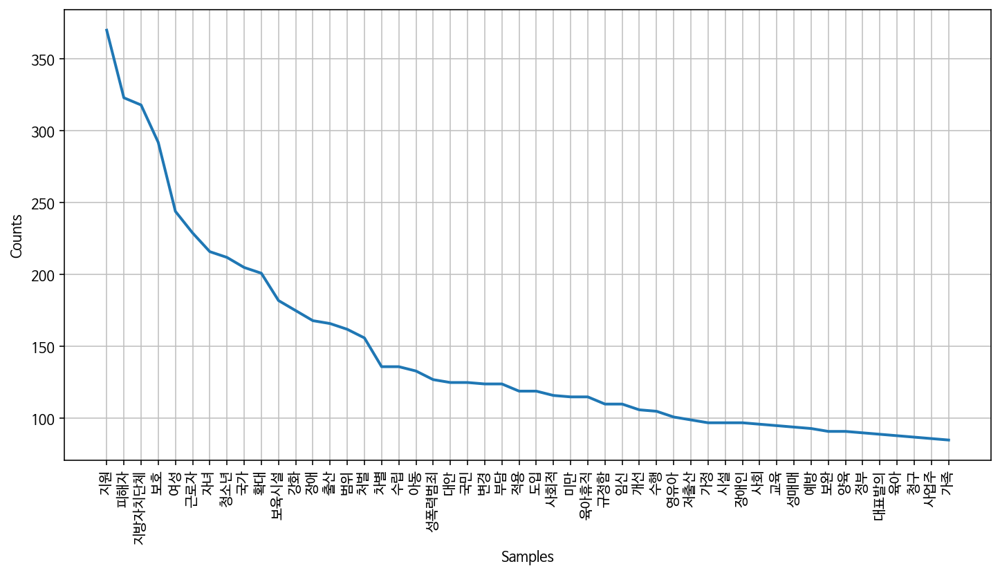

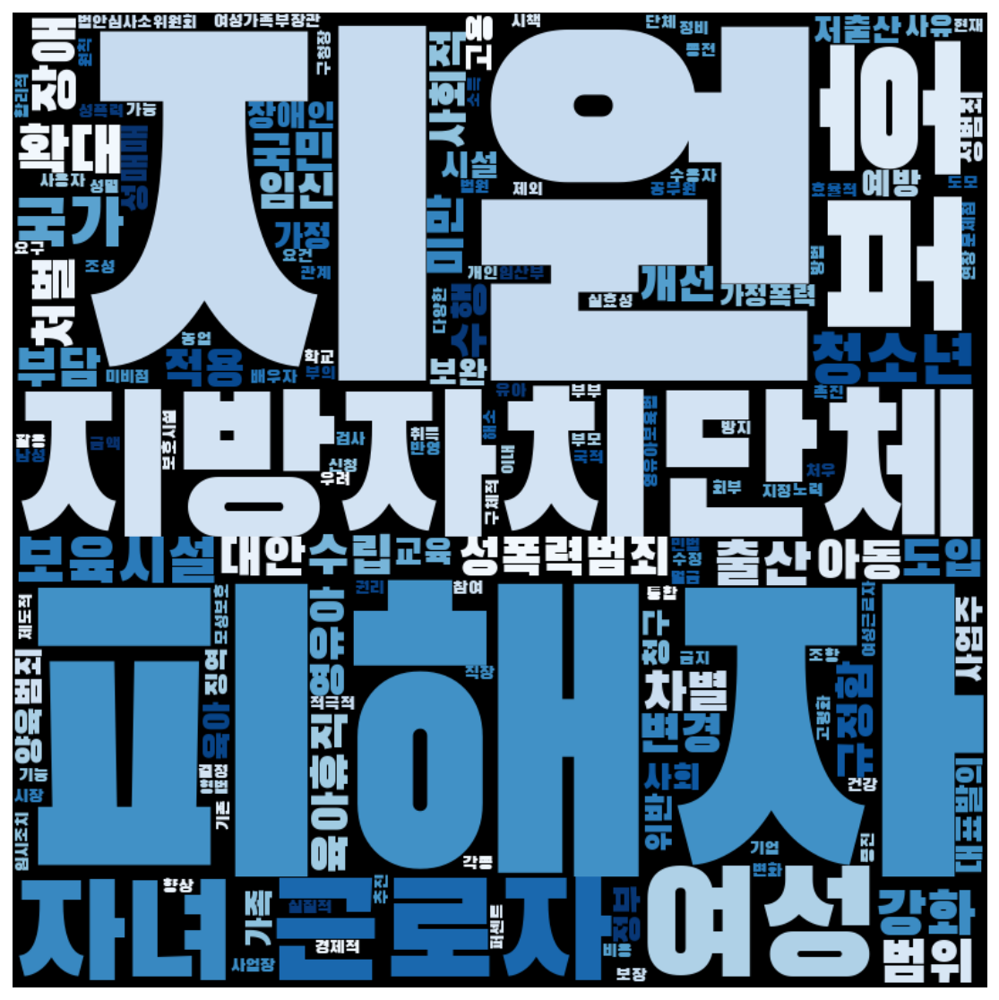

In [76]:
frewords_vis(government_word)
wordcloud_vis(government_word, 'Blues')

In [77]:
romoohyun['문장벡터'] = romoohyun['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))

<ipython-input-77-cf73c047fb1f>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  romoohyun['문장벡터'] = romoohyun['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))


In [78]:
romoohyun = romoohyun[romoohyun['명사수'] > 1]

# K means 수행 
word_vectors = romoohyun['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors)
romoohyun['category'] = idx

In [79]:
romoohyun['category'].value_counts()

5    179
1    119
2     98
3     31
0     13
4      7
Name: category, dtype: int64

In [80]:
romoohyun_g1 = romoohyun[romoohyun['category'] == 0]
romoohyun_g2 = romoohyun[romoohyun['category'] == 1]
romoohyun_g3 = romoohyun[romoohyun['category'] == 2]
romoohyun_g4 = romoohyun[romoohyun['category'] == 3]
romoohyun_g5 = romoohyun[romoohyun['category'] == 4]
romoohyun_g6 = romoohyun[romoohyun['category'] == 5]

In [81]:
romoohyun_g1_tokens = total_tokens(romoohyun_g1['tokens'])
romoohyun_g2_tokens = total_tokens(romoohyun_g2['tokens'])
romoohyun_g3_tokens = total_tokens(romoohyun_g3['tokens'])
romoohyun_g4_tokens = total_tokens(romoohyun_g4['tokens'])
romoohyun_g5_tokens = total_tokens(romoohyun_g5['tokens'])
romoohyun_g6_tokens = total_tokens(romoohyun_g6['tokens'])

In [82]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출', '수행','풀어쓰',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
romoohyun_g1_tokens = [each_word for each_word in romoohyun_g1_tokens if each_word not in stopwords]
romoohyun_g2_tokens = [each_word for each_word in romoohyun_g2_tokens if each_word not in stopwords]
romoohyun_g3_tokens = [each_word for each_word in romoohyun_g3_tokens if each_word not in stopwords]
romoohyun_g4_tokens = [each_word for each_word in romoohyun_g4_tokens if each_word not in stopwords]
romoohyun_g5_tokens = [each_word for each_word in romoohyun_g5_tokens if each_word not in stopwords]
romoohyun_g6_tokens = [each_word for each_word in romoohyun_g6_tokens if each_word not in stopwords]

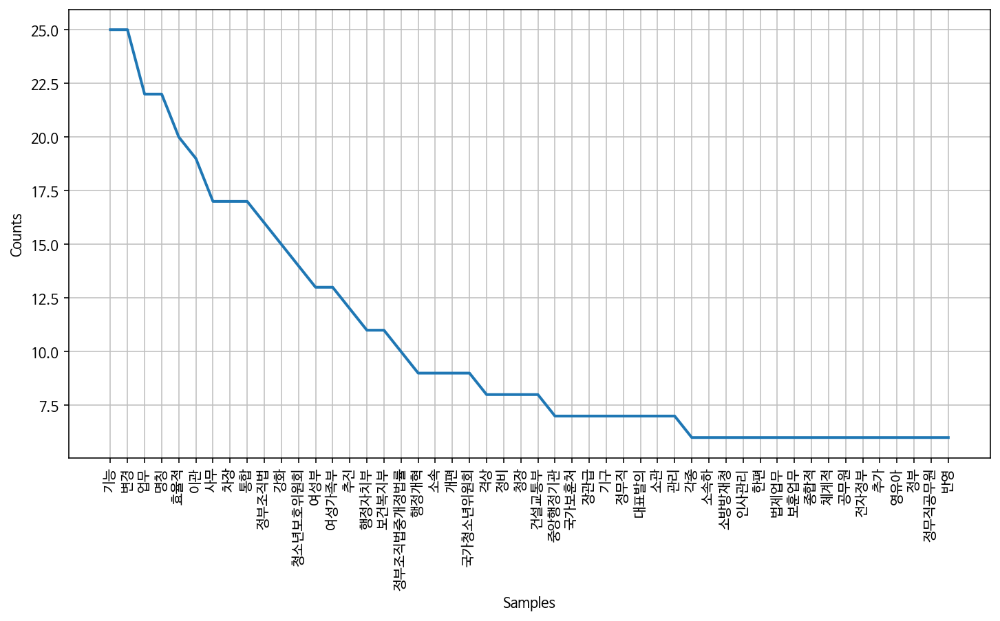

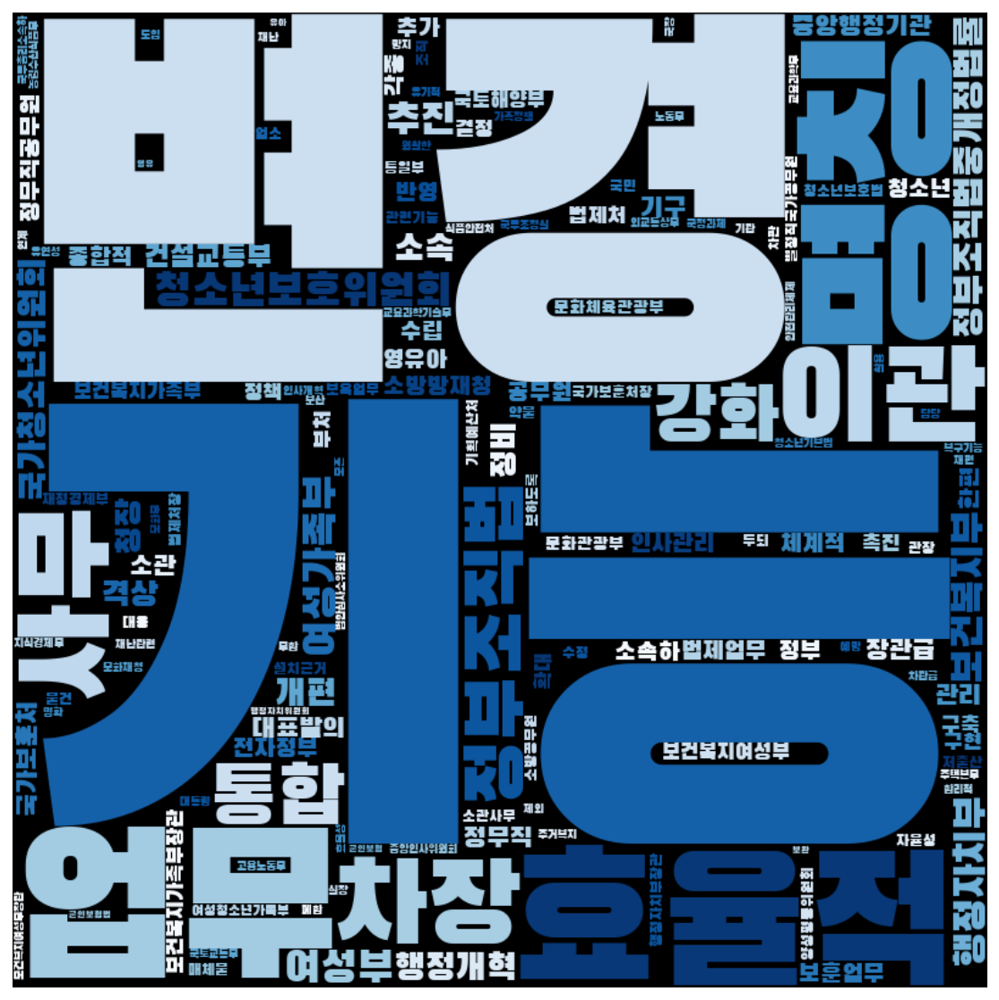

In [83]:
frewords_vis(romoohyun_g1_tokens)
wordcloud_vis(romoohyun_g1_tokens, 'Blues')

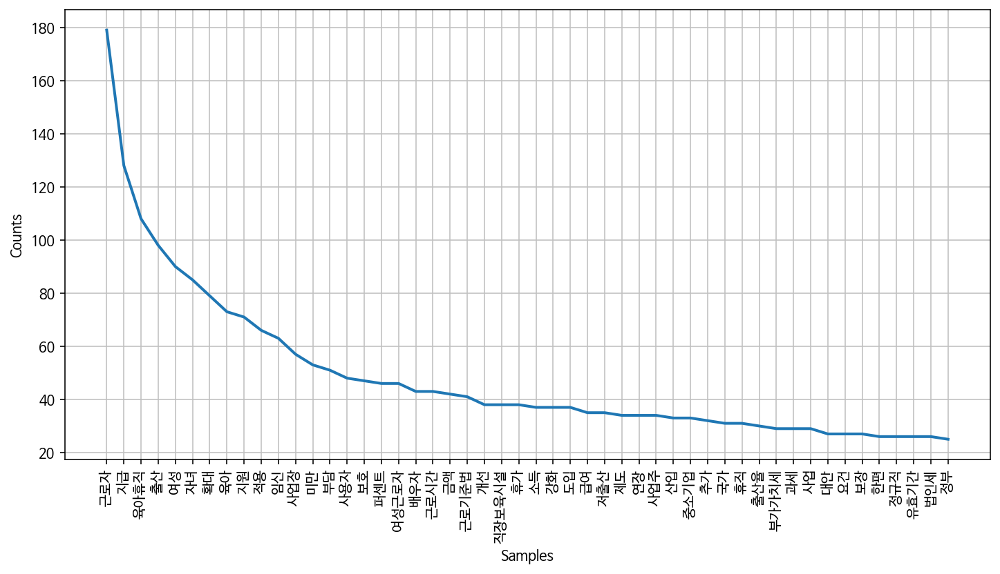

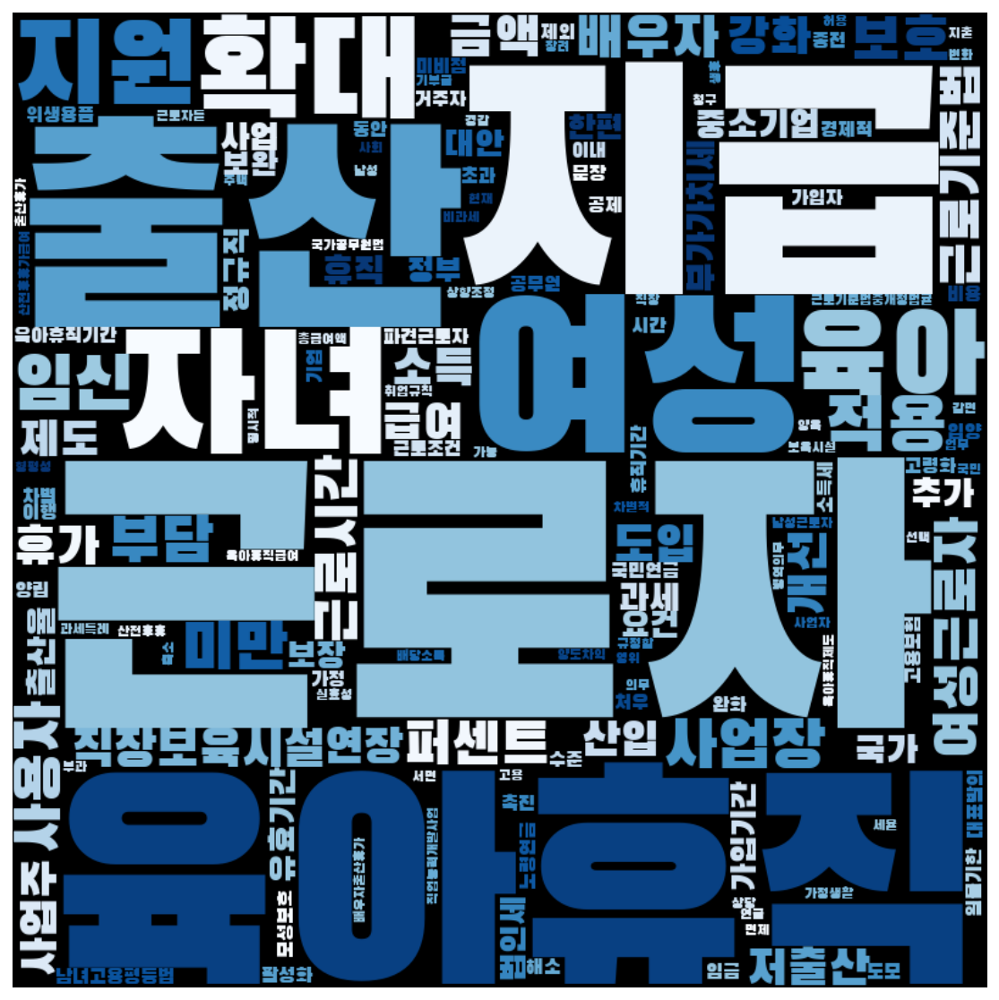

In [84]:
frewords_vis(romoohyun_g2_tokens)
wordcloud_vis(romoohyun_g2_tokens, 'Blues')

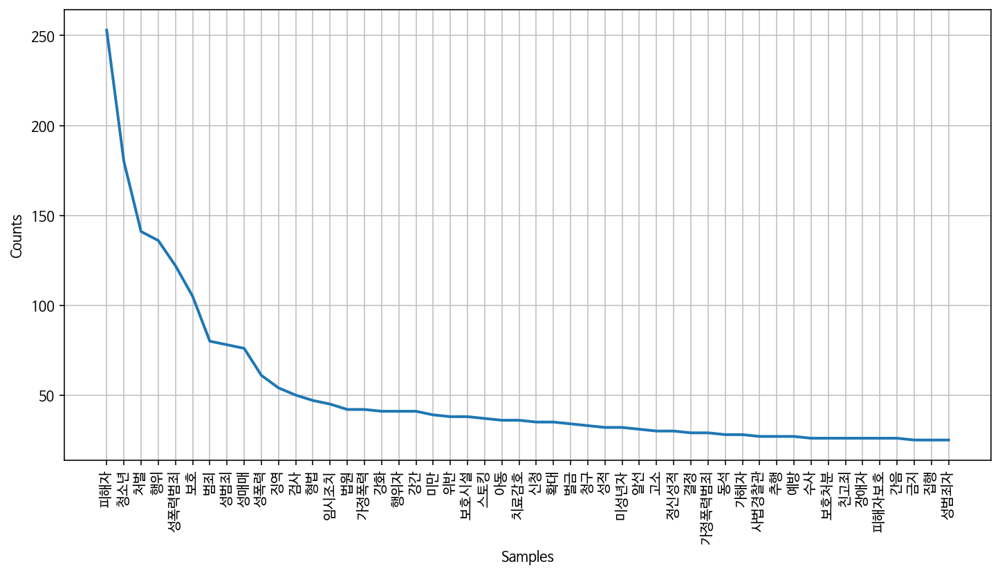

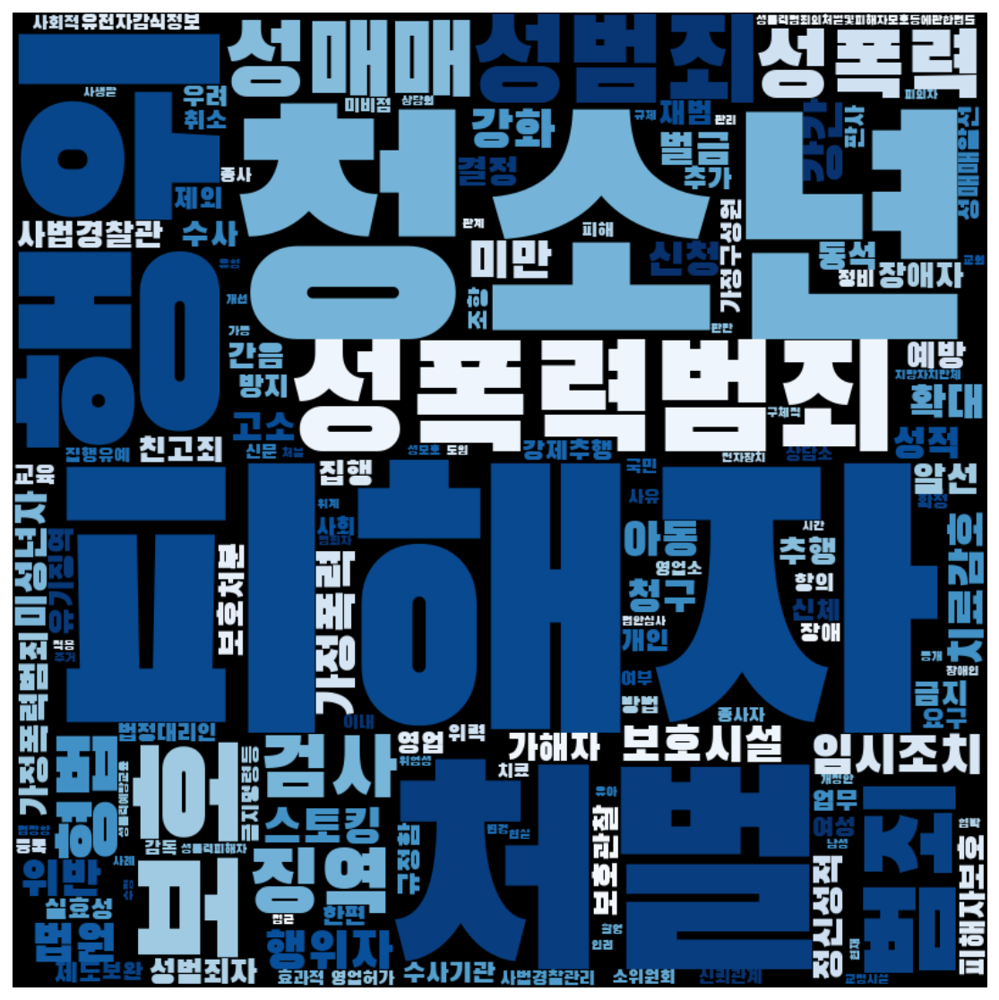

In [85]:
frewords_vis(romoohyun_g3_tokens)
wordcloud_vis(romoohyun_g3_tokens, 'Blues')

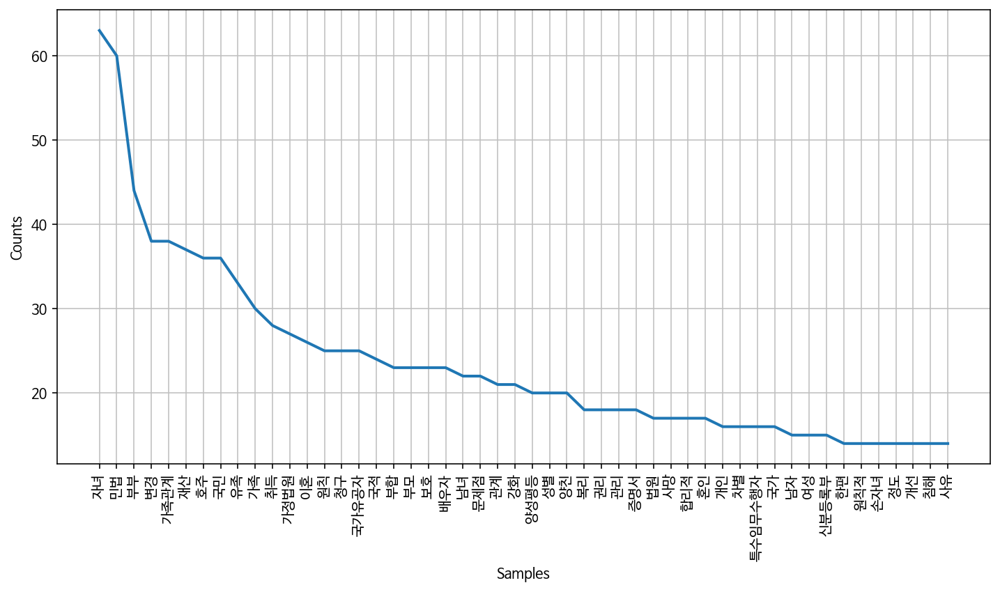

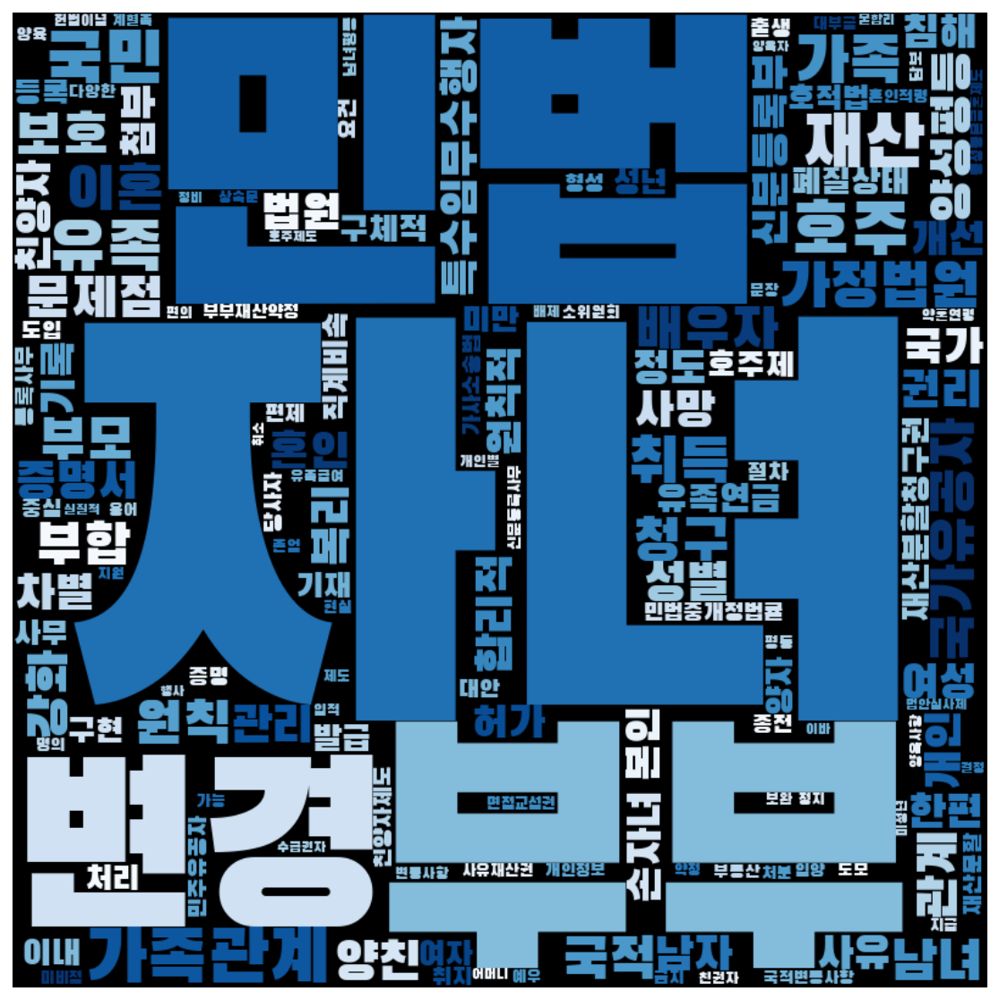

In [86]:
frewords_vis(romoohyun_g4_tokens)
wordcloud_vis(romoohyun_g4_tokens, 'Blues')

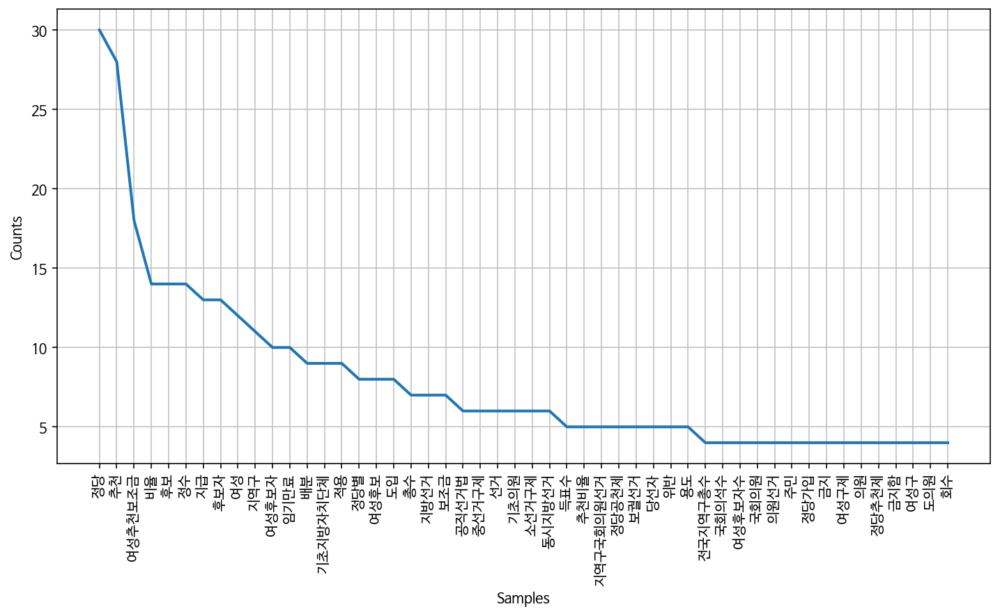

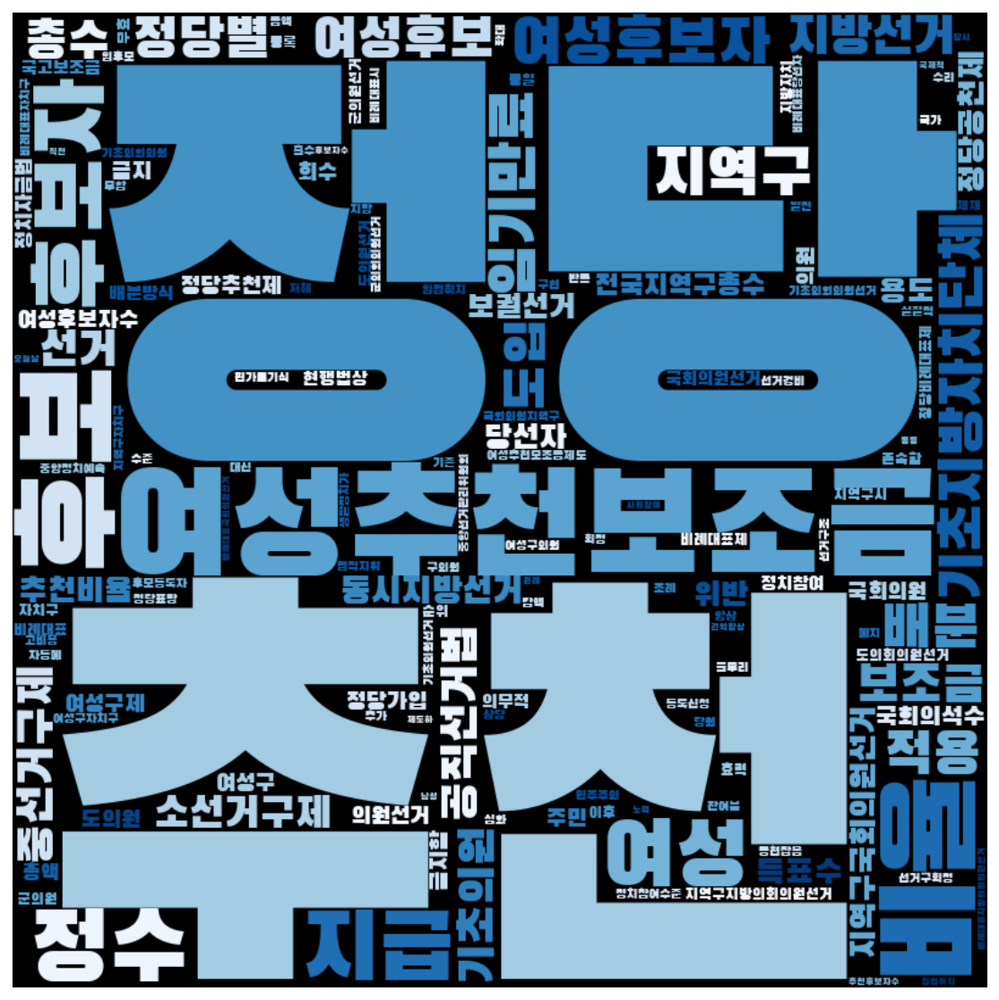

In [87]:
frewords_vis(romoohyun_g5_tokens)
wordcloud_vis(romoohyun_g5_tokens, 'Blues')

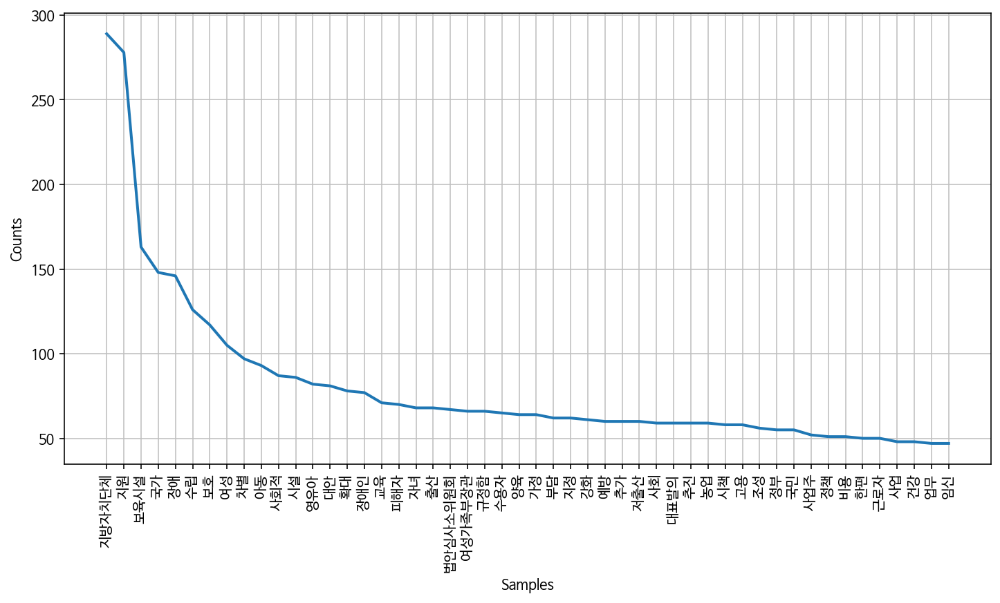

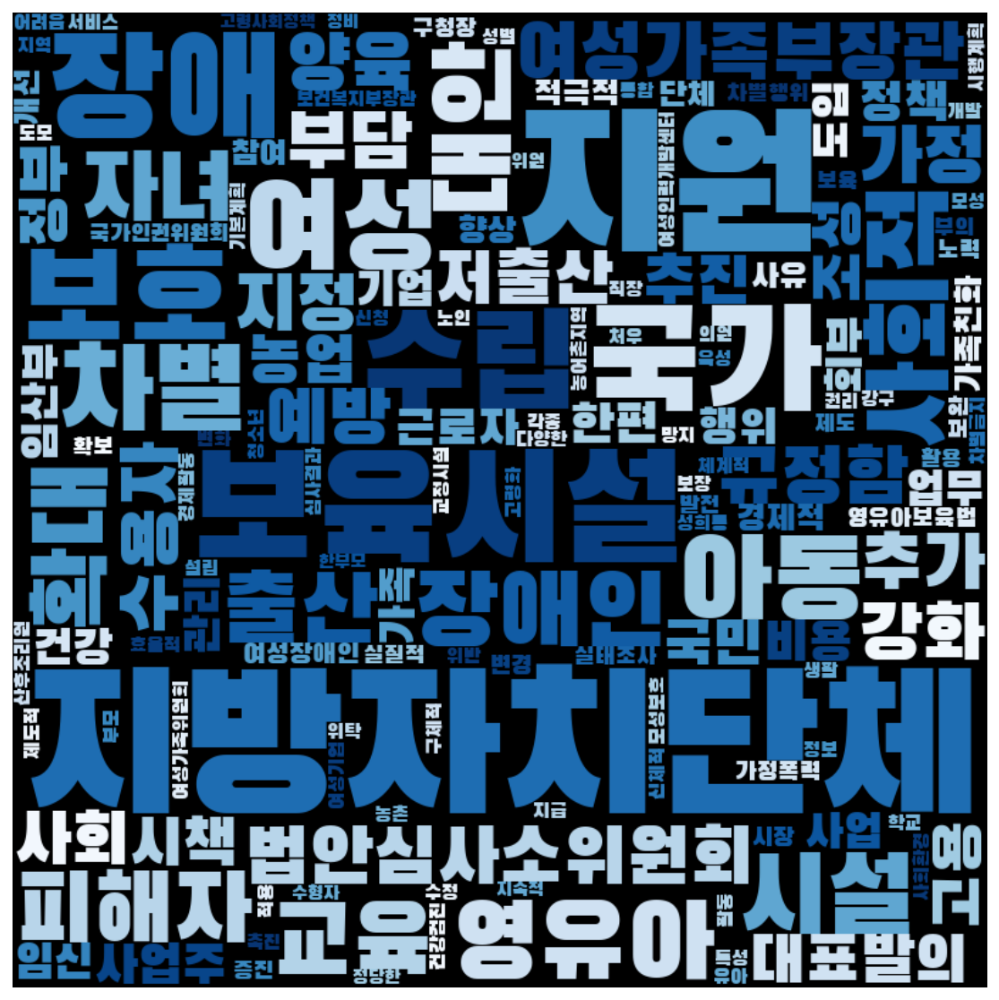

In [88]:
frewords_vis(romoohyun_g6_tokens)
wordcloud_vis(romoohyun_g6_tokens, 'Blues')

## 이명박 정권
- 2008.02.25 ~ 2013.02.24

In [15]:
leemyungbak = gender[(gender['제안일자'] >= datetime.date(2008,2,25)) & 
                        (gender['제안일자'] <= datetime.date(2013,2,24))]
leemyungbak.shape

(1131, 16)

In [16]:
leemyungbak['소관위원회'].value_counts()

법제사법위원회                         240
보건복지위원회                         228
여성가족위원회                         201
환경노동위원회                         117
교육과학기술위원회                        63
아동·여성대상 성폭력 대책 특별위원회             54
기획재정위원회                          49
행정안전위원회                          47
문화체육관광방송통신위원회                    16
보건복지가족위원회                        13
정치개혁특별위원회                        12
국방위원회                            12
농림수산식품위원회                        10
정무위원회                            10
안전행정위원회                           9
교육문화체육관광위원회                       9
여성위원회                             7
국회운영위원회                           6
지식경제위원회                           6
국토해양위원회                           6
농림축산식품해양수산위원회                     4
국토교통위원회                           3
사법제도개혁특별위원회                       3
미래창조과학방송통신위원회                     2
외교통상통일위원회                         1
장애인에 대한 성폭력 등 인권침해 방지대책특별위원회      1
산업통상자원위원회                         1
저출산고령화대책특별위원회               

<AxesSubplot:>

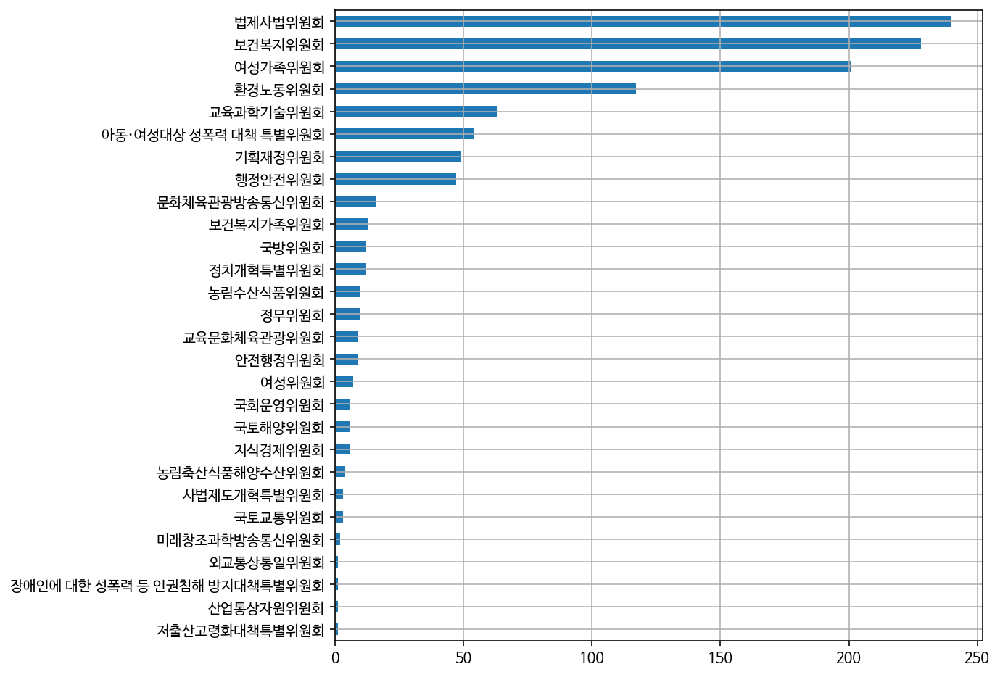

In [208]:
comm_df = leemyungbak.copy()
comm_df = comm_df[comm_df['소관위원회'] != '미확정']

comm_df['소관위원회'].value_counts(ascending=True).plot(kind='barh', grid=True, figsize=(8,8))

In [209]:
model_government = Word2Vec(leemyungbak['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-28 15:59:08,377 : INFO : collecting all words and their counts
2020-10-28 15:59:08,378 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-28 15:59:08,413 : INFO : collected 12054 word types from a corpus of 100761 raw words and 1131 sentences
2020-10-28 15:59:08,414 : INFO : Loading a fresh vocabulary
2020-10-28 15:59:08,423 : INFO : effective_min_count=10 retains 1797 unique words (14% of original 12054, drops 10257)
2020-10-28 15:59:08,424 : INFO : effective_min_count=10 leaves 76627 word corpus (76% of original 100761, drops 24134)
2020-10-28 15:59:08,430 : INFO : deleting the raw counts dictionary of 12054 items
2020-10-28 15:59:08,431 : INFO : sample=0.001 downsamples 52 most-common words
2020-10-28 15:59:08,433 : INFO : downsampling leaves estimated 69143 word corpus (90.2% of prior 76627)
2020-10-28 15:59:08,437 : INFO : estimated required memory for 1797 words and 100 dimensions: 2336100 bytes
2020-10-28 15:59:08,438 : INFO : resetting la

2020-10-28 15:59:12,947 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:13,006 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:13,016 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 15:59:13,017 : INFO : EPOCH - 15 : training on 100761 raw words (69152 effective words) took 0.3s, 269047 effective words/s
2020-10-28 15:59:13,206 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 15:59:13,216 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:13,279 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:13,286 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 15:59:13,287 : INFO : EPOCH - 16 : training on 100761 raw words (69094 effective words) took 0.3s, 261728 effective words/s
2020-10-28 15:59:13,478 : INFO : worker thread finished; awaiting finish of 3 more threads
20

2020-10-28 15:59:17,505 : INFO : EPOCH - 31 : training on 100761 raw words (69026 effective words) took 0.2s, 305056 effective words/s
2020-10-28 15:59:17,685 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 15:59:17,719 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:17,760 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:17,771 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 15:59:17,773 : INFO : EPOCH - 32 : training on 100761 raw words (69212 effective words) took 0.3s, 264919 effective words/s
2020-10-28 15:59:17,939 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 15:59:17,958 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:18,015 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:18,030 : INFO : worker thread finished; awaiting finish of 0 more threads
20

2020-10-28 15:59:22,399 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:22,471 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:22,476 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 15:59:22,477 : INFO : EPOCH - 48 : training on 100761 raw words (69097 effective words) took 0.3s, 225614 effective words/s
2020-10-28 15:59:22,721 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 15:59:22,724 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:22,783 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:22,786 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 15:59:22,787 : INFO : EPOCH - 49 : training on 100761 raw words (69178 effective words) took 0.3s, 226815 effective words/s
2020-10-28 15:59:22,988 : INFO : worker thread finished; awaiting finish of 3 more threads
20

2020-10-28 15:59:27,438 : INFO : EPOCH - 64 : training on 100761 raw words (69134 effective words) took 0.3s, 217329 effective words/s
2020-10-28 15:59:27,654 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 15:59:27,682 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:27,686 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:27,746 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 15:59:27,746 : INFO : EPOCH - 65 : training on 100761 raw words (69100 effective words) took 0.3s, 232369 effective words/s
2020-10-28 15:59:27,950 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 15:59:27,974 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:28,024 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:28,054 : INFO : worker thread finished; awaiting finish of 0 more threads
20

2020-10-28 15:59:32,356 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:32,418 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:32,427 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 15:59:32,428 : INFO : EPOCH - 81 : training on 100761 raw words (69046 effective words) took 0.3s, 230838 effective words/s
2020-10-28 15:59:32,641 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 15:59:32,663 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:32,731 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:32,732 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 15:59:32,733 : INFO : EPOCH - 82 : training on 100761 raw words (69151 effective words) took 0.3s, 229231 effective words/s
2020-10-28 15:59:32,901 : INFO : worker thread finished; awaiting finish of 3 more threads
20

2020-10-28 15:59:37,058 : INFO : EPOCH - 97 : training on 100761 raw words (69169 effective words) took 0.3s, 234028 effective words/s
2020-10-28 15:59:37,264 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 15:59:37,271 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:37,280 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:37,328 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 15:59:37,328 : INFO : EPOCH - 98 : training on 100761 raw words (69228 effective words) took 0.3s, 262731 effective words/s
2020-10-28 15:59:37,543 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 15:59:37,565 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 15:59:37,634 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 15:59:37,643 : INFO : worker thread finished; awaiting finish of 0 more threads
20

In [210]:
print(model_government.wv.most_similar('여성'))

2020-10-28 15:59:37,905 : INFO : precomputing L2-norms of word weight vectors


[('남성', 0.6177535057067871), ('여성비하적', 0.46839115023612976), ('우리나라', 0.4627379775047302), ('내포', 0.4583374857902527), ('남성근로자', 0.44417330622673035), ('고정관념', 0.443206250667572), ('정치참여', 0.43140360713005066), ('생물학적', 0.42564326524734497), ('관념', 0.41715502738952637), ('촉진법', 0.4156559109687805)]


In [214]:
government_word = total_tokens(leemyungbak['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','문장',
            '대표발의','대안']
government_word = [each_word for each_word in government_word if each_word not in stopwords]

In [215]:
ko = nltk.Text(government_word, name='이명박 정권')
ko.vocab().most_common(20)

[('아동', 1345),
 ('청소년', 953),
 ('지원', 827),
 ('피해자', 688),
 ('처벌', 683),
 ('성범죄', 636),
 ('성폭력범죄', 562),
 ('보호', 545),
 ('여성', 477),
 ('성폭력', 439),
 ('국가', 427),
 ('지방자치단체', 425),
 ('자녀', 415),
 ('범죄', 391),
 ('근로자', 346),
 ('확대', 338),
 ('출산', 314),
 ('교육', 288),
 ('양육비', 280),
 ('신상정보', 276)]

In [216]:
print('부녀 단어 수:', ko.count('부녀'))
print('여자 단어 수:', ko.count('여자'))
print('여성 단어 수:', ko.count('여성'))
print('젠더 단어 수:', ko.count('젠더'))
print()

print('남녀평등 단어 수:', ko.count('남녀평등'))
print('양성평등 단어 수:', ko.count('양성평등'))
print('성평등 단어 수:', ko.count('성평등'))
print('성인지적 단어 수:', ko.count('성인지적'))
print('성주류화 단어 수:', ko.count('성주류화'))
print()

print('청소년 단어 수:', ko.count('청소년'))
print('아동 단어 수:', ko.count('아동'))

부녀 단어 수: 60
여자 단어 수: 110
여성 단어 수: 477
젠더 단어 수: 0

남녀평등 단어 수: 5
양성평등 단어 수: 28
성평등 단어 수: 38
성인지적 단어 수: 17
성주류화 단어 수: 0

청소년 단어 수: 953
아동 단어 수: 1345


In [96]:
# 호주제
print('호주제 단어 수:', ko.count('호주제'))
print('가족법 단어 수:', ko.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko.count('저출산'))
print('육아휴직 단어 수:', ko.count('육아휴직'))
print('보육 단어 수:', ko.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko.count('위안부'))
print('일본군성노예제 단어 수:', ko.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko.count('성범죄'))
print('강간 단어 수:', ko.count('강간'))
print('성희롱 단어 수:', ko.count('성희롱'))
print('성폭력 단어 수:', ko.count('성폭력'))
print('성폭력범죄 단어 수:', ko.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko.count('윤락'))
print('윤락행위 단어 수:', ko.count('윤락행위'))
print('기생관광 단어 수:', ko.count('기생관광'))
print('성매매 단어 수:', ko.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko.count('낙태'))
print('임신중절 단어 수:', ko.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko.count('불법촬영'))
print('몰카 단어 수:', ko.count('몰카'))

호주제 단어 수: 34
가족법 단어 수: 0

저출산 단어 수: 236
육아휴직 단어 수: 174
보육 단어 수: 165

위안부 단어 수: 7
일본군성노예제 단어 수: 37

성범죄 단어 수: 636
강간 단어 수: 118
성희롱 단어 수: 77
성폭력 단어 수: 439
성폭력범죄 단어 수: 562

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 113

가정폭력 단어 수: 203

낙태 단어 수: 35
임신중절 단어 수: 0

스토킹 단어 수: 26

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 0


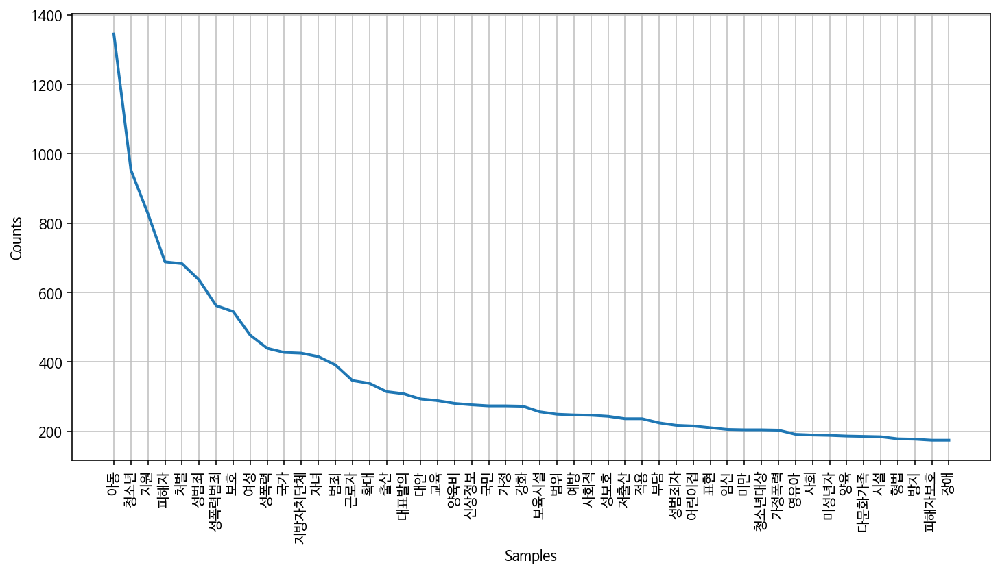

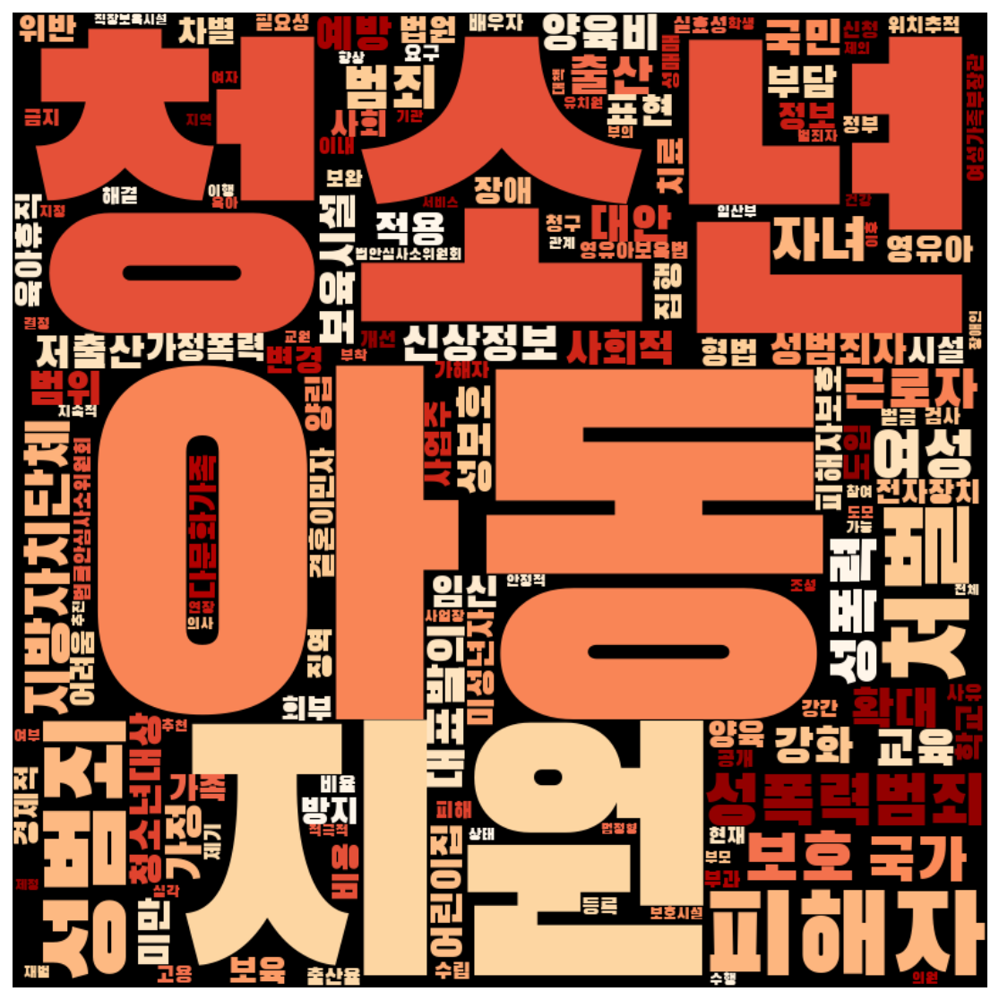

In [97]:
frewords_vis(government_word)
wordcloud_vis(government_word, 'OrRd')

In [98]:
leemyungbak['문장벡터'] = leemyungbak['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))

<ipython-input-98-f19e4b6205eb>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  leemyungbak['문장벡터'] = leemyungbak['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))


In [99]:
leemyungbak = leemyungbak[leemyungbak['명사수'] > 1]

# K means 수행 
word_vectors = leemyungbak['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors)
leemyungbak['category'] = idx

In [100]:
leemyungbak['category'].value_counts()

1    384
5    321
0    209
2    155
4     38
3     24
Name: category, dtype: int64

In [101]:
leemyungbak_g1 = leemyungbak[leemyungbak['category'] == 0]
leemyungbak_g2 = leemyungbak[leemyungbak['category'] == 1]
leemyungbak_g3 = leemyungbak[leemyungbak['category'] == 2]
leemyungbak_g4 = leemyungbak[leemyungbak['category'] == 3]
leemyungbak_g5 = leemyungbak[leemyungbak['category'] == 4]
leemyungbak_g6 = leemyungbak[leemyungbak['category'] == 5]

In [102]:
leemyungbak_g1_tokens = total_tokens(leemyungbak_g1['tokens'])
leemyungbak_g2_tokens = total_tokens(leemyungbak_g2['tokens'])
leemyungbak_g3_tokens = total_tokens(leemyungbak_g3['tokens'])
leemyungbak_g4_tokens = total_tokens(leemyungbak_g4['tokens'])
leemyungbak_g5_tokens = total_tokens(leemyungbak_g5['tokens'])
leemyungbak_g6_tokens = total_tokens(leemyungbak_g6['tokens'])

In [103]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출', '수행','풀어쓰','대안','대표발의',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
leemyungbak_g1_tokens = [each_word for each_word in leemyungbak_g1_tokens if each_word not in stopwords]
leemyungbak_g2_tokens = [each_word for each_word in leemyungbak_g2_tokens if each_word not in stopwords]
leemyungbak_g3_tokens = [each_word for each_word in leemyungbak_g3_tokens if each_word not in stopwords]
leemyungbak_g4_tokens = [each_word for each_word in leemyungbak_g4_tokens if each_word not in stopwords]
leemyungbak_g5_tokens = [each_word for each_word in leemyungbak_g5_tokens if each_word not in stopwords]
leemyungbak_g6_tokens = [each_word for each_word in leemyungbak_g6_tokens if each_word not in stopwords]

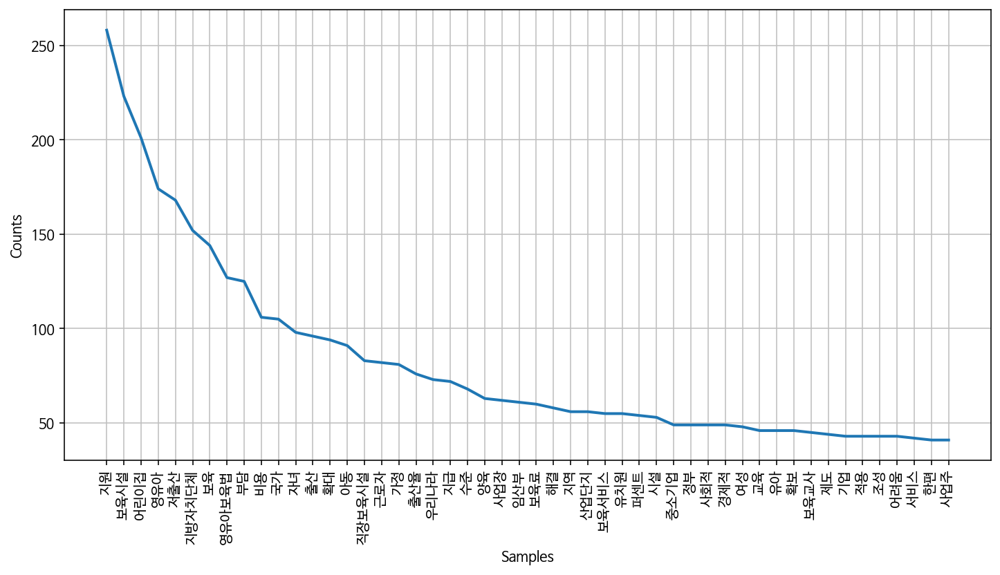

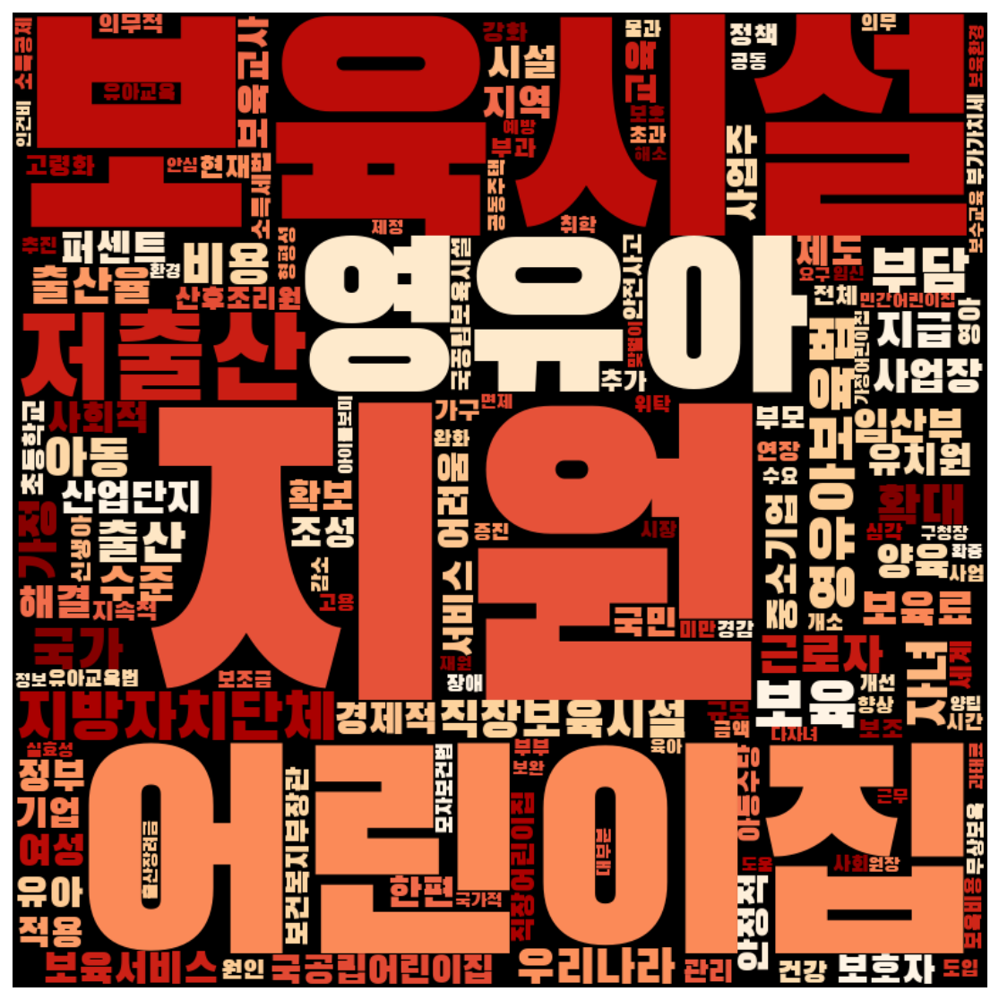

In [104]:
frewords_vis(leemyungbak_g1_tokens)
wordcloud_vis(leemyungbak_g1_tokens, 'OrRd')

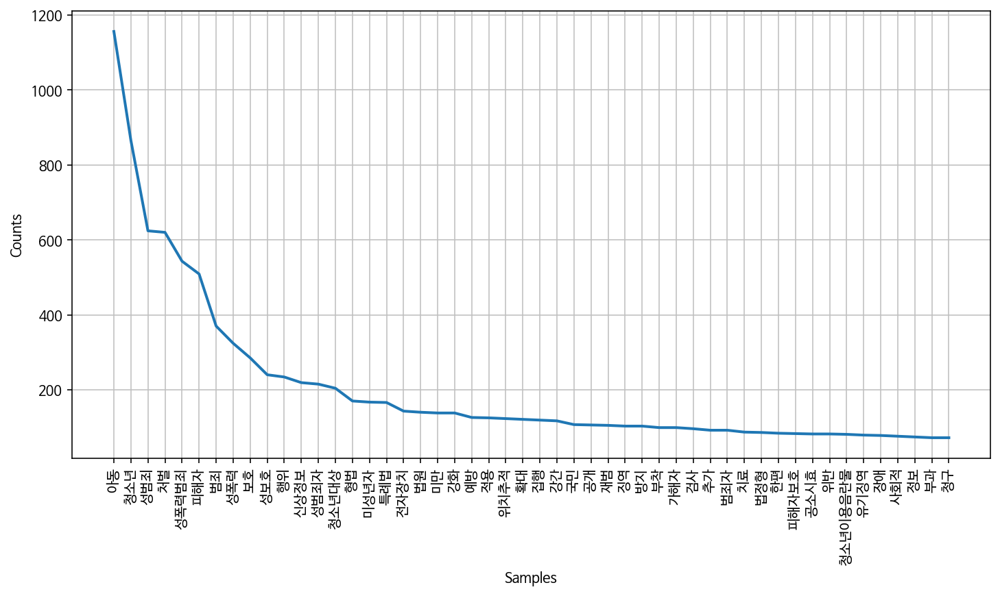

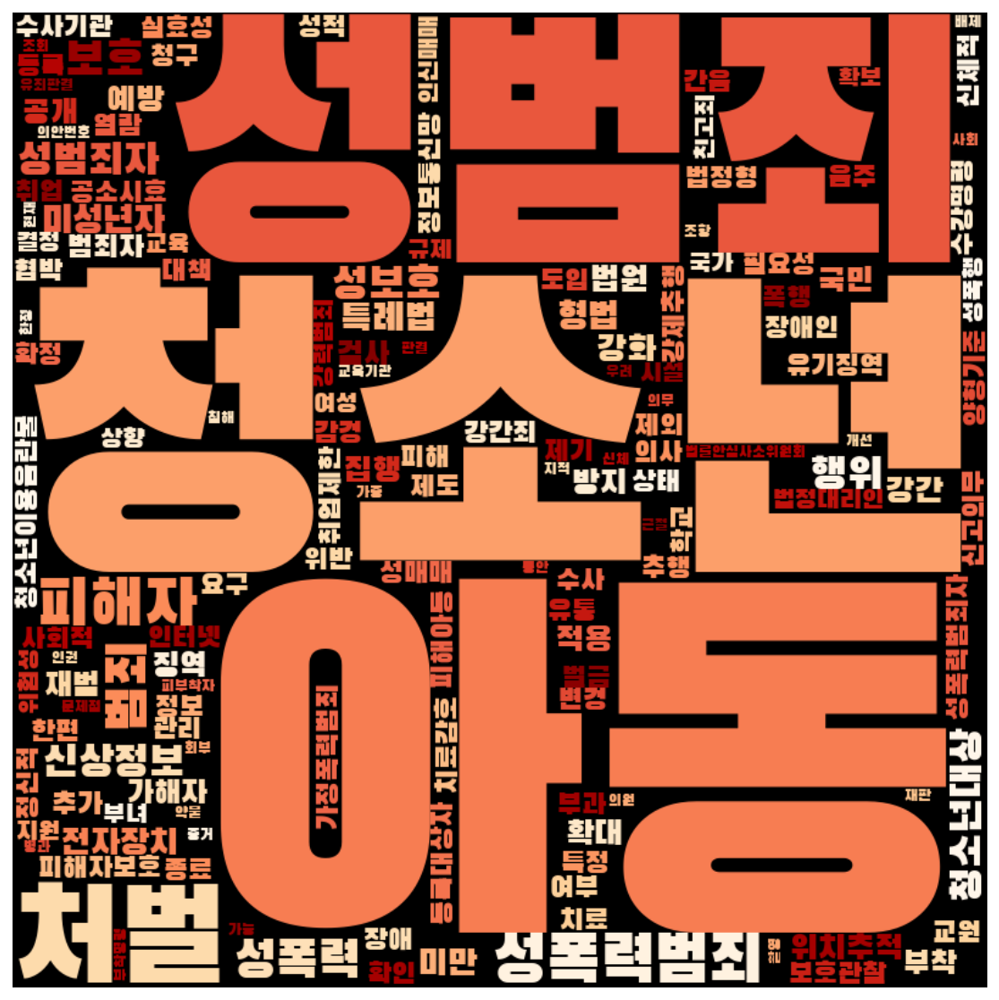

In [105]:
frewords_vis(leemyungbak_g2_tokens)
wordcloud_vis(leemyungbak_g2_tokens, 'OrRd')

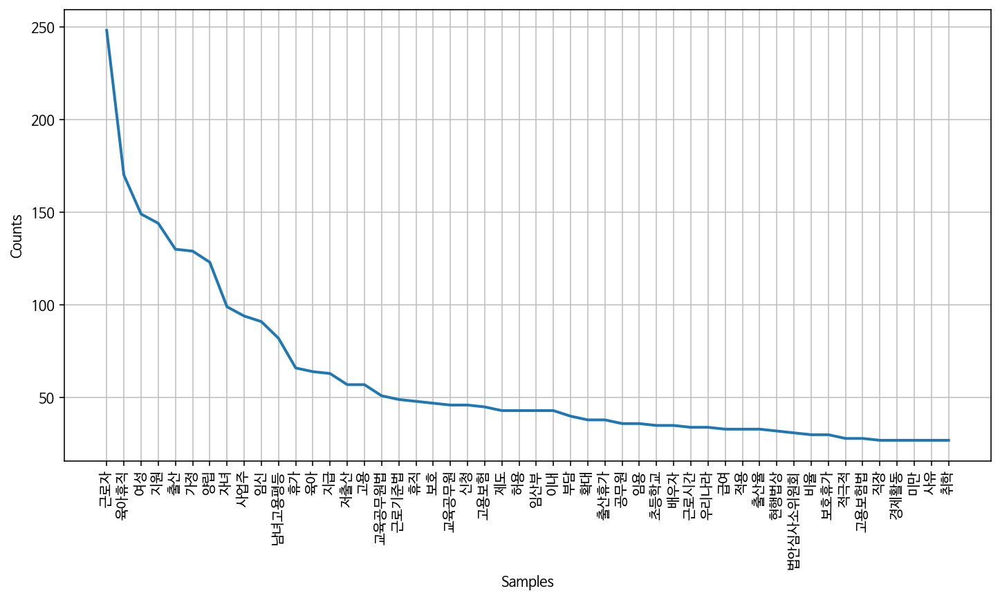

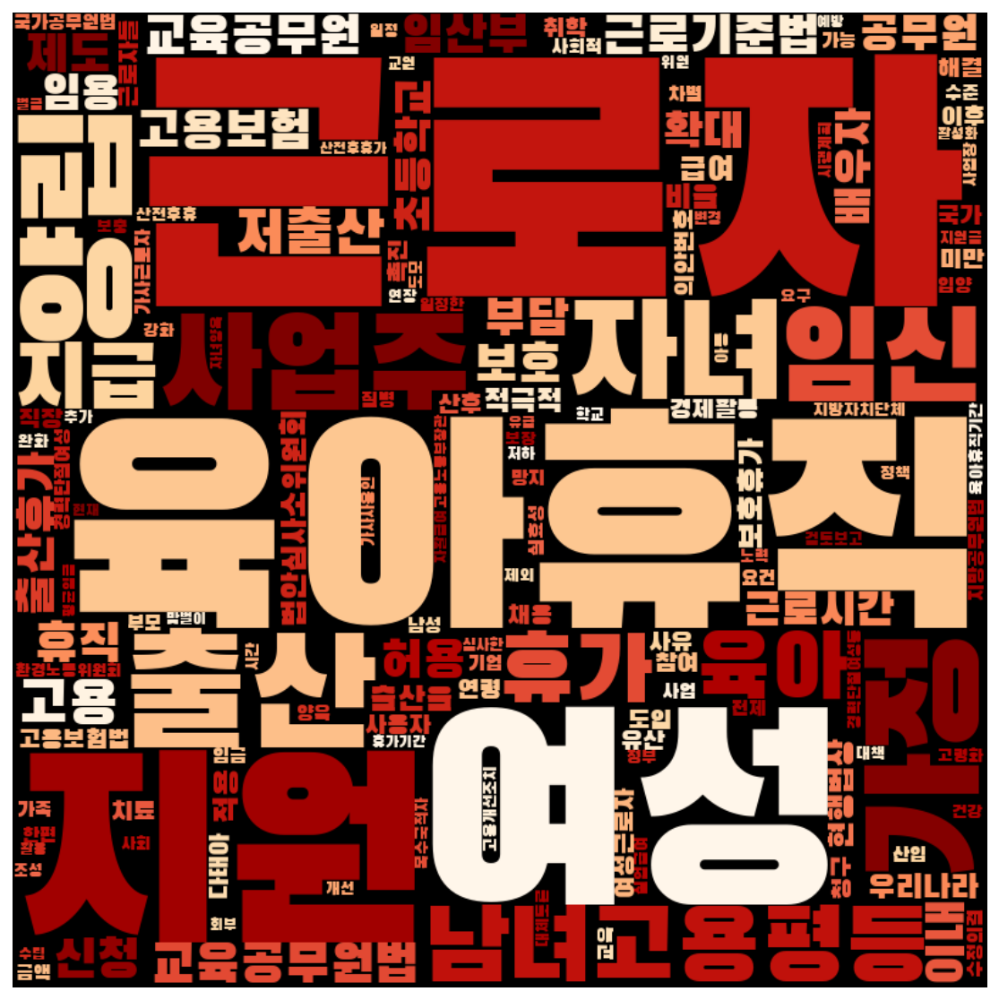

In [106]:
frewords_vis(leemyungbak_g3_tokens)
wordcloud_vis(leemyungbak_g3_tokens, 'OrRd')

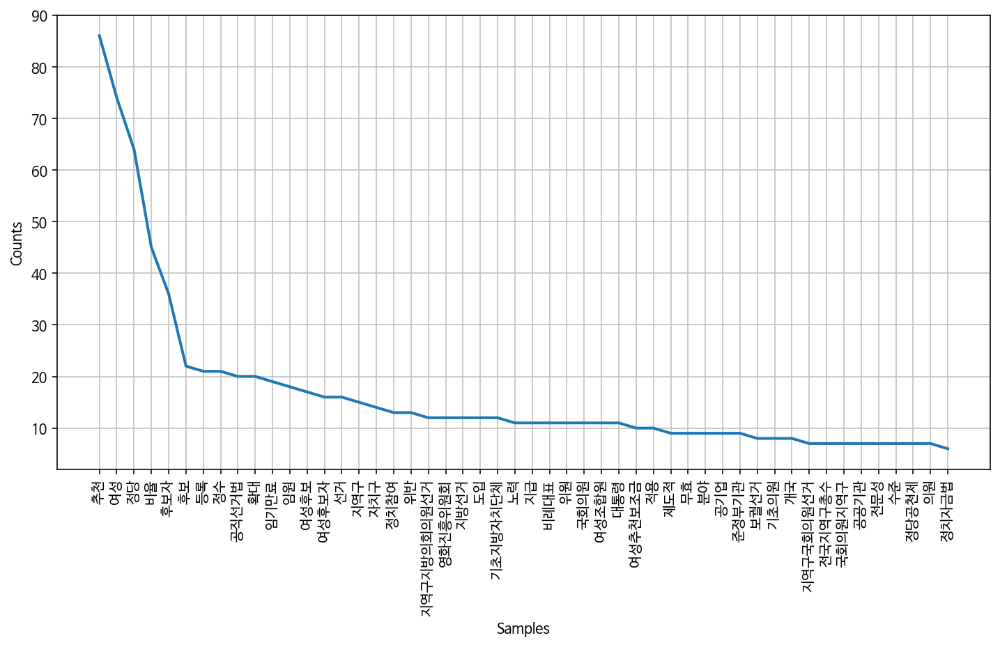

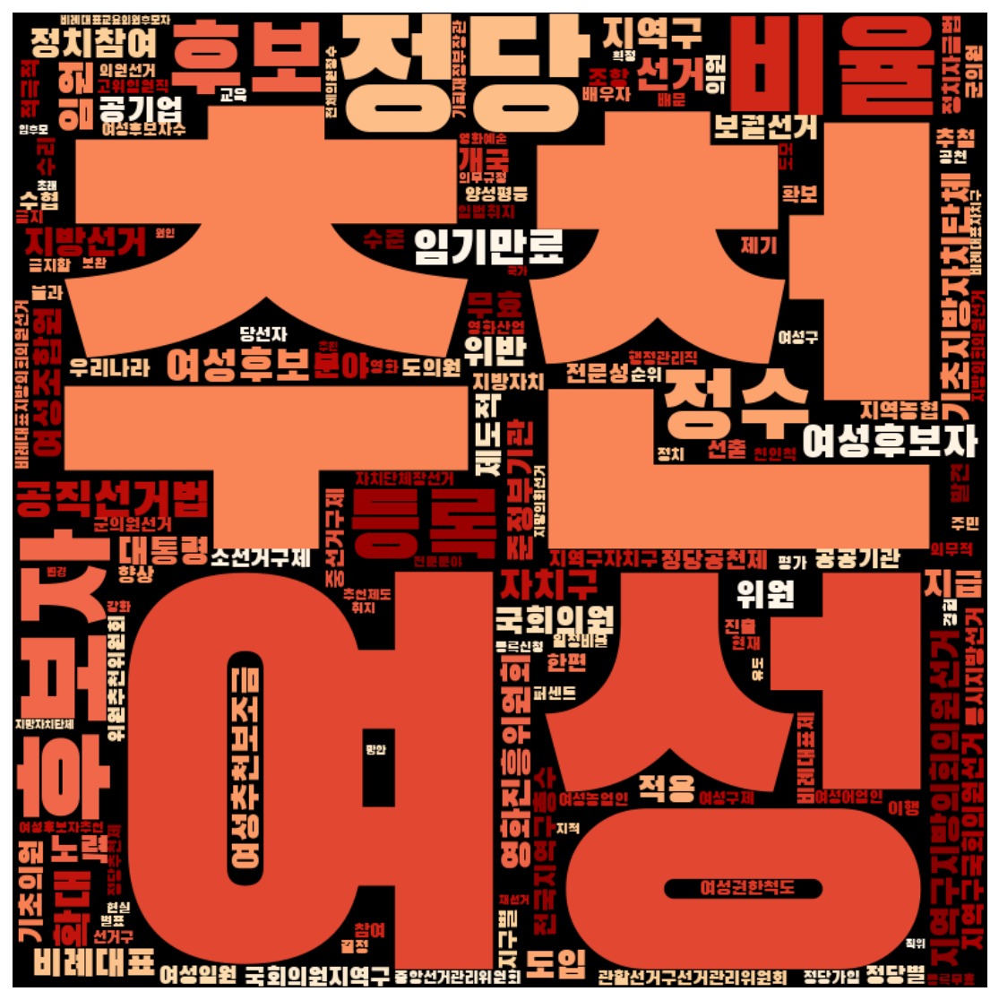

In [107]:
frewords_vis(leemyungbak_g4_tokens)
wordcloud_vis(leemyungbak_g4_tokens, 'OrRd')

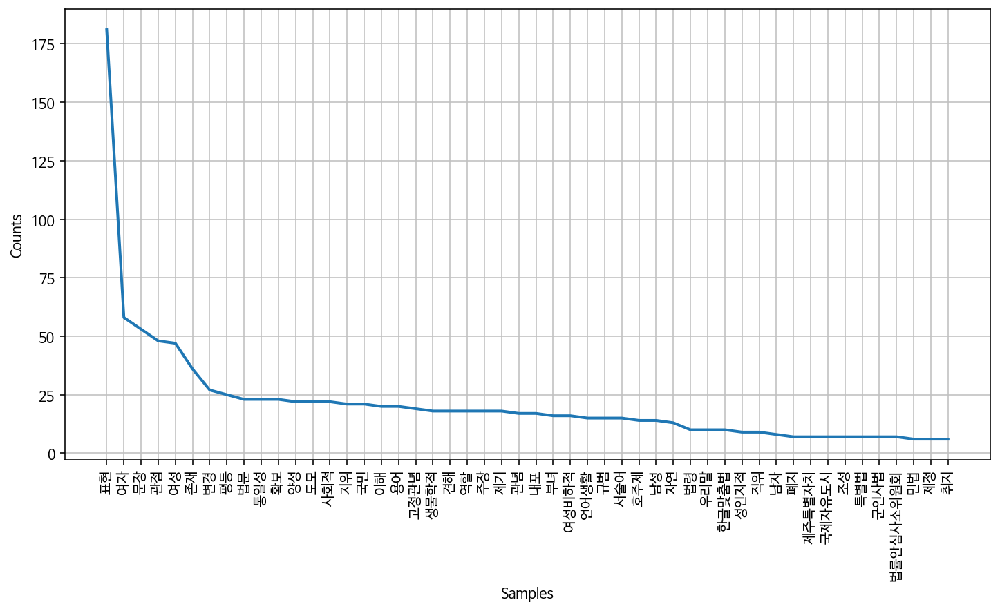

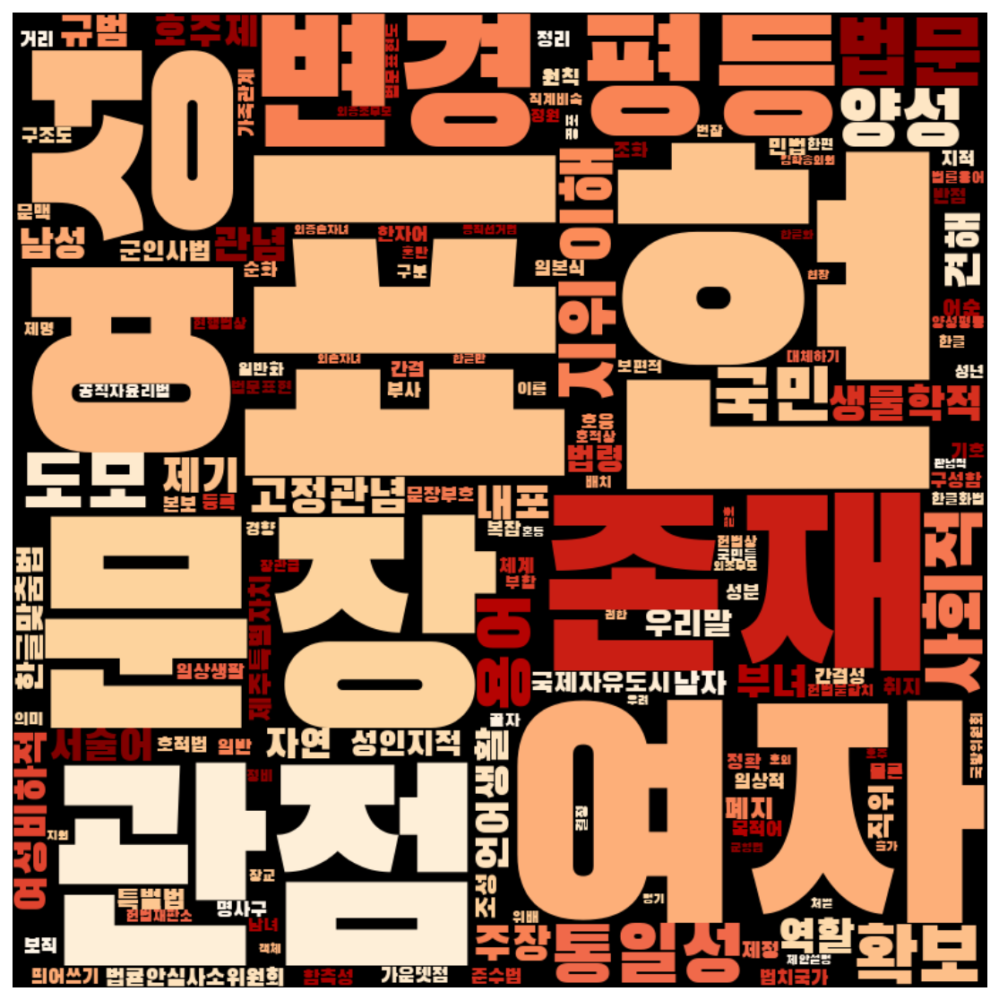

In [108]:
frewords_vis(leemyungbak_g5_tokens)
wordcloud_vis(leemyungbak_g5_tokens, 'OrRd')

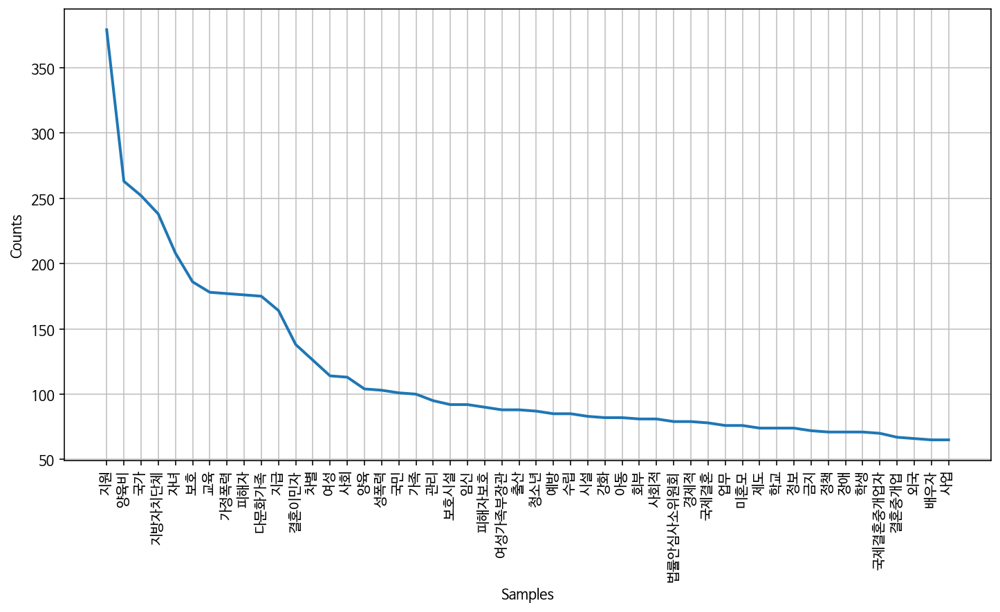

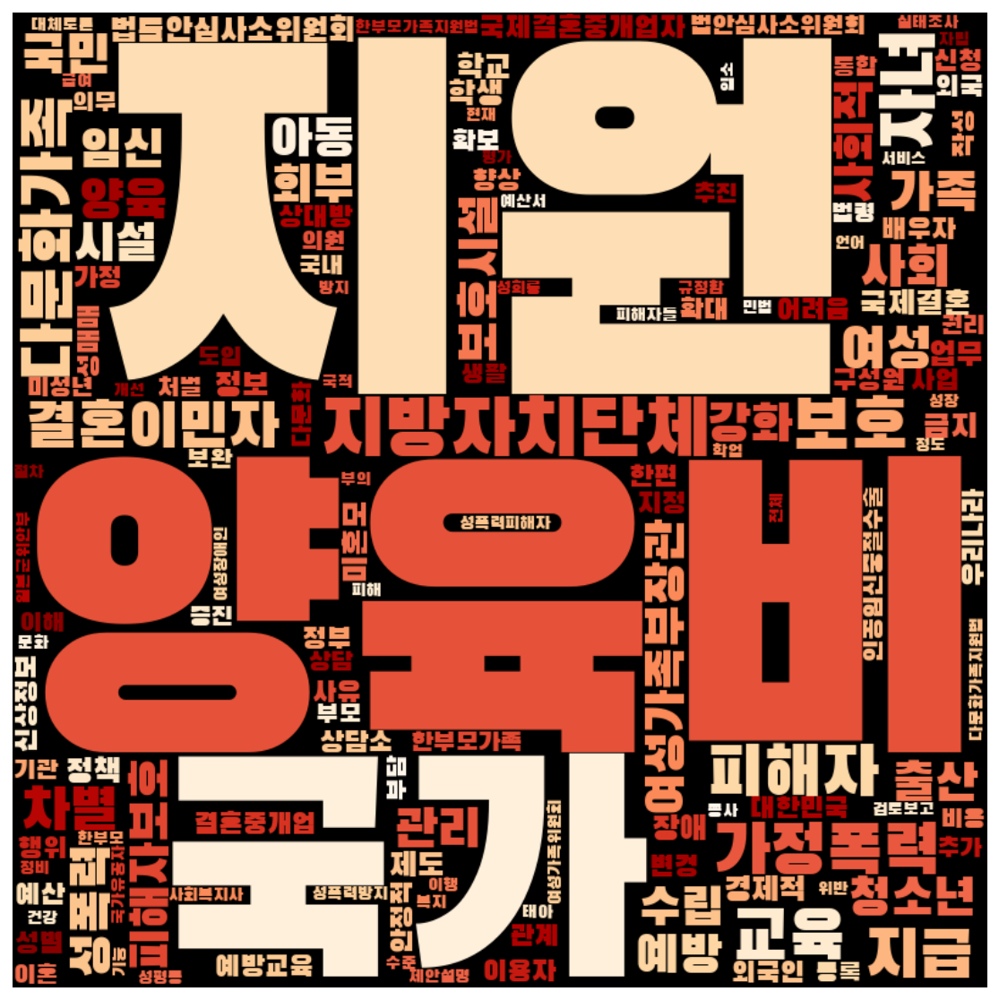

In [109]:
frewords_vis(leemyungbak_g6_tokens)
wordcloud_vis(leemyungbak_g6_tokens, 'OrRd')

## 박근혜 정권
- 2013.02.25 ~ 2017.03.13

In [18]:
parkkeunhye = gender[(gender['제안일자'] >= datetime.date(2013,2,25)) & 
                        (gender['제안일자'] <= datetime.date(2017,5,10))]
parkkeunhye.shape

(1123, 16)

In [19]:
parkkeunhye['소관위원회'].value_counts()

여성가족위원회            269
보건복지위원회            198
법제사법위원회            169
환경노동위원회            168
교육문화체육관광위원회         54
안전행정위원회             50
기획재정위원회             45
행정안전위원회             33
교육위원회               27
국방위원회               18
정무위원회               17
국토교통위원회             16
국회운영위원회             12
정치개혁 특별위원회          11
농림축산식품해양수산위원회        9
미래창조과학방송통신위원회        9
산업통상자원위원회            6
과학기술정보방송통신위원회        5
외교통일위원회              4
문화체육관광위원회            1
산업통상자원중소벤처기업위원회      1
Name: 소관위원회, dtype: int64

<AxesSubplot:>

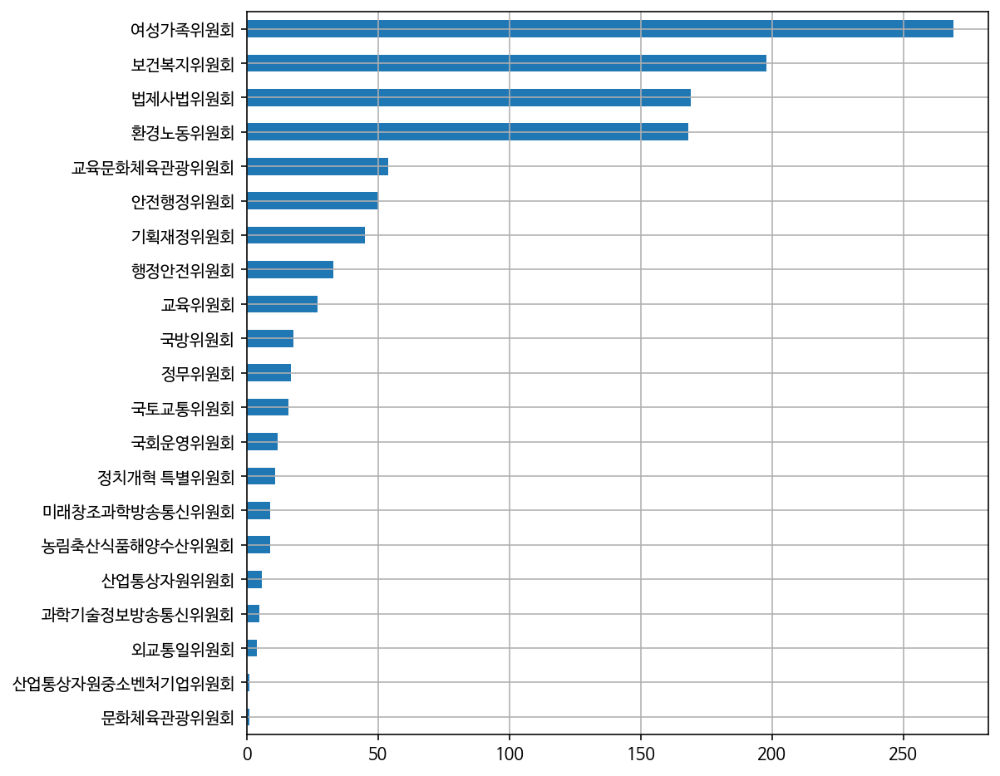

In [218]:
comm_df = parkkeunhye.copy()
comm_df = comm_df[comm_df['소관위원회'] != '미확정']

comm_df['소관위원회'].value_counts(ascending=True).plot(kind='barh', grid=True, figsize=(8,8))

In [219]:
model_government = Word2Vec(parkkeunhye['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-28 16:02:43,498 : INFO : collecting all words and their counts
2020-10-28 16:02:43,500 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-28 16:02:43,526 : INFO : collected 10189 word types from a corpus of 83741 raw words and 1123 sentences
2020-10-28 16:02:43,526 : INFO : Loading a fresh vocabulary
2020-10-28 16:02:43,534 : INFO : effective_min_count=10 retains 1540 unique words (15% of original 10189, drops 8649)
2020-10-28 16:02:43,535 : INFO : effective_min_count=10 leaves 63391 word corpus (75% of original 83741, drops 20350)
2020-10-28 16:02:43,542 : INFO : deleting the raw counts dictionary of 10189 items
2020-10-28 16:02:43,543 : INFO : sample=0.001 downsamples 52 most-common words
2020-10-28 16:02:43,545 : INFO : downsampling leaves estimated 56958 word corpus (89.9% of prior 63391)
2020-10-28 16:02:43,549 : INFO : estimated required memory for 1540 words and 100 dimensions: 2002000 bytes
2020-10-28 16:02:43,550 : INFO : resetting layer

2020-10-28 16:02:47,224 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:02:47,228 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:02:47,252 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:02:47,253 : INFO : EPOCH - 15 : training on 83741 raw words (56880 effective words) took 0.2s, 259913 effective words/s
2020-10-28 16:02:47,417 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:02:47,428 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:02:47,438 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:02:47,452 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:02:47,453 : INFO : EPOCH - 16 : training on 83741 raw words (56928 effective words) took 0.2s, 293101 effective words/s
2020-10-28 16:02:47,678 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-28 16:02:51,024 : INFO : EPOCH - 31 : training on 83741 raw words (56918 effective words) took 0.2s, 250106 effective words/s
2020-10-28 16:02:51,201 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:02:51,212 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:02:51,214 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:02:51,238 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:02:51,238 : INFO : EPOCH - 32 : training on 83741 raw words (57001 effective words) took 0.2s, 272140 effective words/s
2020-10-28 16:02:51,393 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:02:51,403 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:02:51,406 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:02:51,417 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-28 16:02:54,784 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:02:54,788 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:02:54,816 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:02:54,817 : INFO : EPOCH - 48 : training on 83741 raw words (56891 effective words) took 0.2s, 265054 effective words/s
2020-10-28 16:02:55,021 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:02:55,025 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:02:55,041 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:02:55,057 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:02:55,058 : INFO : EPOCH - 49 : training on 83741 raw words (57089 effective words) took 0.2s, 245387 effective words/s
2020-10-28 16:02:55,243 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-28 16:02:58,555 : INFO : EPOCH - 64 : training on 83741 raw words (56955 effective words) took 0.2s, 255470 effective words/s
2020-10-28 16:02:58,713 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:02:58,724 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:02:58,732 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:02:58,739 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:02:58,741 : INFO : EPOCH - 65 : training on 83741 raw words (57015 effective words) took 0.2s, 315271 effective words/s
2020-10-28 16:02:58,921 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:02:58,929 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:02:58,936 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:02:58,944 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-28 16:03:02,183 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:03:02,186 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:03:02,208 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:03:02,209 : INFO : EPOCH - 81 : training on 83741 raw words (56888 effective words) took 0.2s, 279760 effective words/s
2020-10-28 16:03:02,363 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:03:02,369 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:03:02,377 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:03:02,384 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:03:02,385 : INFO : EPOCH - 82 : training on 83741 raw words (56939 effective words) took 0.2s, 340322 effective words/s
2020-10-28 16:03:02,587 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-28 16:03:05,613 : INFO : EPOCH - 97 : training on 83741 raw words (56947 effective words) took 0.2s, 282347 effective words/s
2020-10-28 16:03:05,805 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:03:05,818 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:03:05,819 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:03:05,833 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:03:05,834 : INFO : EPOCH - 98 : training on 83741 raw words (56876 effective words) took 0.2s, 264584 effective words/s
2020-10-28 16:03:06,012 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:03:06,018 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:03:06,019 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:03:06,028 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

In [220]:
print(model_government.wv.most_similar('여성'))

2020-10-28 16:03:06,269 : INFO : precomputing L2-norms of word weight vectors


[('성별', 0.5342626571655273), ('남성', 0.5194200277328491), ('남녀', 0.5067768692970276), ('격차', 0.5001689195632935), ('경력단절', 0.4930318593978882), ('정치참여', 0.4927247166633606), ('임금격차', 0.4799318313598633), ('정당별', 0.47221970558166504), ('국회의원선거', 0.469513475894928), ('지역구', 0.46756526827812195)]


In [221]:
government_word = total_tokens(parkkeunhye['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','문장']
government_word = [each_word for each_word in government_word if each_word not in stopwords]

In [223]:
ko = nltk.Text(government_word, name='박근혜 정권')
ko.vocab().most_common(20)

[('지원', 1129),
 ('여성', 687),
 ('아동', 632),
 ('피해자', 622),
 ('청소년', 569),
 ('보호', 567),
 ('근로자', 540),
 ('지방자치단체', 469),
 ('자녀', 422),
 ('국가', 393),
 ('처벌', 365),
 ('가정', 356),
 ('어린이집', 353),
 ('성희롱', 335),
 ('성범죄', 326),
 ('범죄', 301),
 ('출산', 299),
 ('성폭력범죄', 292),
 ('육아휴직', 276),
 ('확대', 269)]

In [224]:

print('부녀 단어 수:', ko.count('부녀'))
print('여자 단어 수:', ko.count('여자'))
print('여성 단어 수:', ko.count('여성'))
print('젠더 단어 수:', ko.count('젠더'))
print()

print('남녀평등 단어 수:', ko.count('남녀평등'))
print('양성평등 단어 수:', ko.count('양성평등'))
print('성평등 단어 수:', ko.count('성평등'))
print('성인지적 단어 수:', ko.count('성인지적'))
print('성주류화 단어 수:', ko.count('성주류화'))
print()

print('청소년 단어 수:', ko.count('청소년'))
print('아동 단어 수:', ko.count('아동'))

부녀 단어 수: 9
여자 단어 수: 16
여성 단어 수: 687
젠더 단어 수: 0

남녀평등 단어 수: 9
양성평등 단어 수: 61
성평등 단어 수: 63
성인지적 단어 수: 6
성주류화 단어 수: 3

청소년 단어 수: 569
아동 단어 수: 632


In [116]:
# 호주제
print('호주제 단어 수:', ko.count('호주제'))
print('가족법 단어 수:', ko.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko.count('저출산'))
print('육아휴직 단어 수:', ko.count('육아휴직'))
print('보육 단어 수:', ko.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko.count('위안부'))
print('일본군성노예제 단어 수:', ko.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko.count('성범죄'))
print('강간 단어 수:', ko.count('강간'))
print('성희롱 단어 수:', ko.count('성희롱'))
print('성폭력 단어 수:', ko.count('성폭력'))
print('성폭력범죄 단어 수:', ko.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko.count('윤락'))
print('윤락행위 단어 수:', ko.count('윤락행위'))
print('기생관광 단어 수:', ko.count('기생관광'))
print('성매매 단어 수:', ko.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko.count('낙태'))
print('임신중절 단어 수:', ko.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko.count('불법촬영'))
print('몰카 단어 수:', ko.count('몰카'))

호주제 단어 수: 0
가족법 단어 수: 0

저출산 단어 수: 241
육아휴직 단어 수: 276
보육 단어 수: 122

위안부 단어 수: 51
일본군성노예제 단어 수: 105

성범죄 단어 수: 326
강간 단어 수: 39
성희롱 단어 수: 335
성폭력 단어 수: 227
성폭력범죄 단어 수: 292

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 241

가정폭력 단어 수: 177

낙태 단어 수: 2
임신중절 단어 수: 0

스토킹 단어 수: 73

미투 단어 수: 0

불법촬영 단어 수: 0
몰카 단어 수: 5


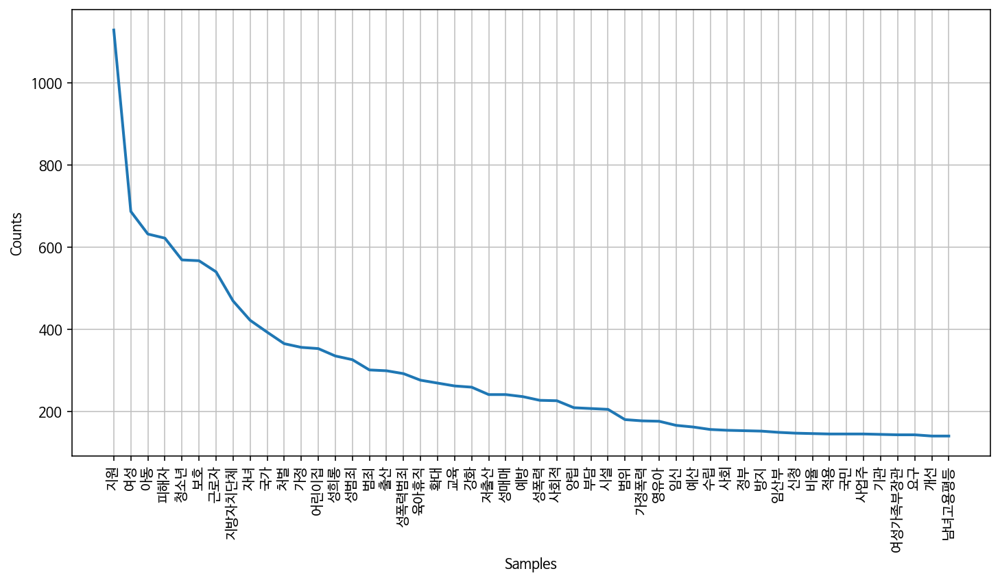

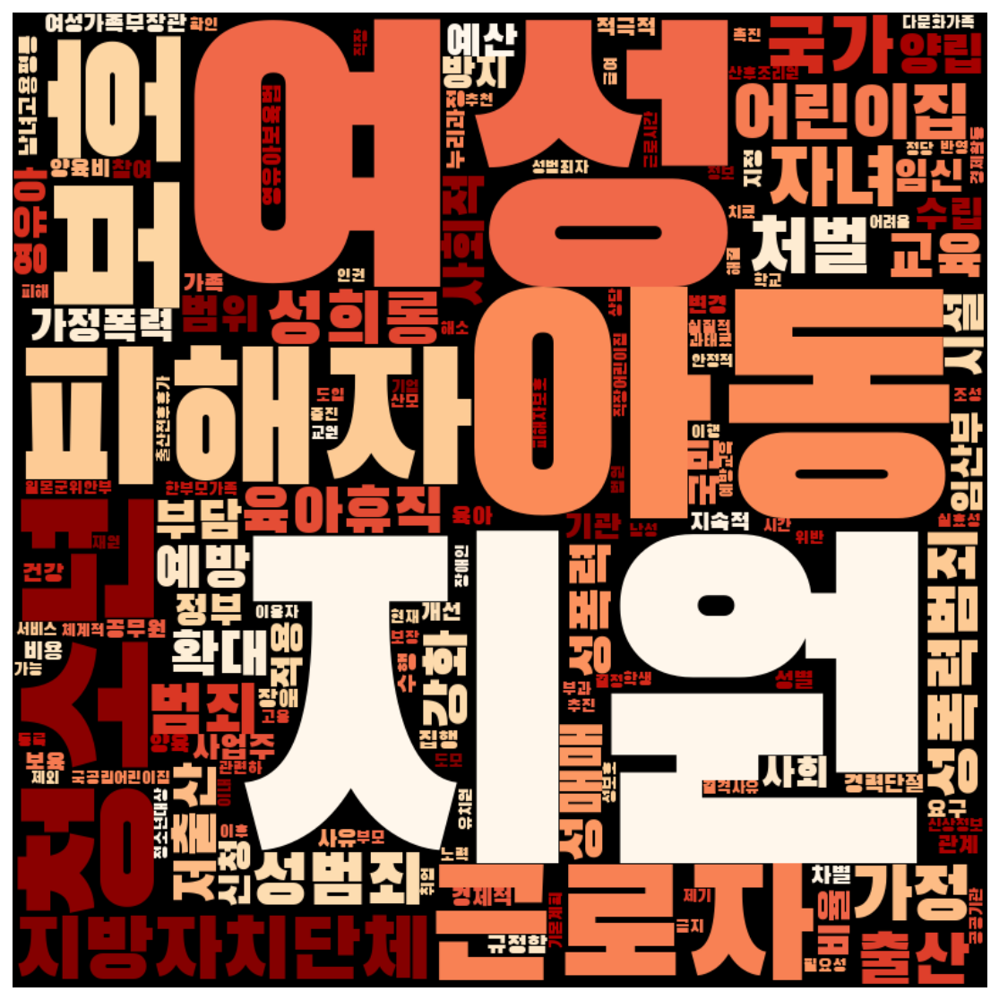

In [117]:
frewords_vis(government_word)
wordcloud_vis(government_word, 'OrRd')

In [118]:
parkkeunhye['문장벡터'] = parkkeunhye['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))

<ipython-input-118-7cf294260f1b>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  parkkeunhye['문장벡터'] = parkkeunhye['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))


In [119]:
parkkeunhye = parkkeunhye[parkkeunhye['명사수'] > 1]

# K means 수행 
word_vectors = parkkeunhye['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors)
parkkeunhye['category'] = idx

In [120]:
parkkeunhye['category'].value_counts()

0    315
2    250
1    221
4    176
5    133
3     28
Name: category, dtype: int64

In [121]:
parkkeunhye_g1 = parkkeunhye[parkkeunhye['category'] == 0]
parkkeunhye_g2 = parkkeunhye[parkkeunhye['category'] == 1]
parkkeunhye_g3 = parkkeunhye[parkkeunhye['category'] == 2]
parkkeunhye_g4 = parkkeunhye[parkkeunhye['category'] == 3]
parkkeunhye_g5 = parkkeunhye[parkkeunhye['category'] == 4]
parkkeunhye_g6 = parkkeunhye[parkkeunhye['category'] == 5]

In [122]:
parkkeunhye_g1_tokens = total_tokens(parkkeunhye_g1['tokens'])
parkkeunhye_g2_tokens = total_tokens(parkkeunhye_g2['tokens'])
parkkeunhye_g3_tokens = total_tokens(parkkeunhye_g3['tokens'])
parkkeunhye_g4_tokens = total_tokens(parkkeunhye_g4['tokens'])
parkkeunhye_g5_tokens = total_tokens(parkkeunhye_g5['tokens'])
parkkeunhye_g6_tokens = total_tokens(parkkeunhye_g6['tokens'])

In [123]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
parkkeunhye_g1_tokens = [each_word for each_word in parkkeunhye_g1_tokens if each_word not in stopwords]
parkkeunhye_g2_tokens = [each_word for each_word in parkkeunhye_g2_tokens if each_word not in stopwords]
parkkeunhye_g3_tokens = [each_word for each_word in parkkeunhye_g3_tokens if each_word not in stopwords]
parkkeunhye_g4_tokens = [each_word for each_word in parkkeunhye_g4_tokens if each_word not in stopwords]
parkkeunhye_g5_tokens = [each_word for each_word in parkkeunhye_g5_tokens if each_word not in stopwords]
parkkeunhye_g6_tokens = [each_word for each_word in parkkeunhye_g6_tokens if each_word not in stopwords]

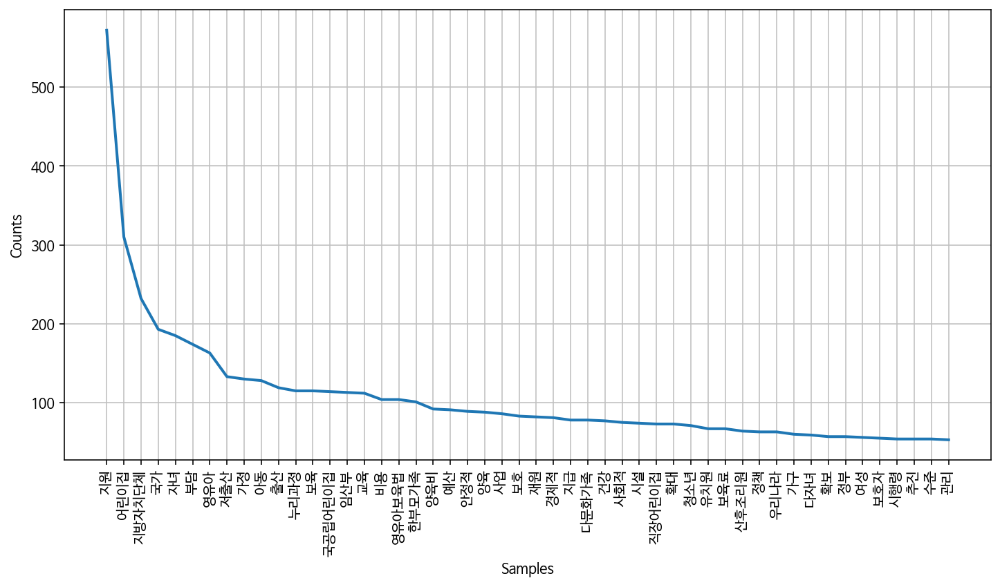

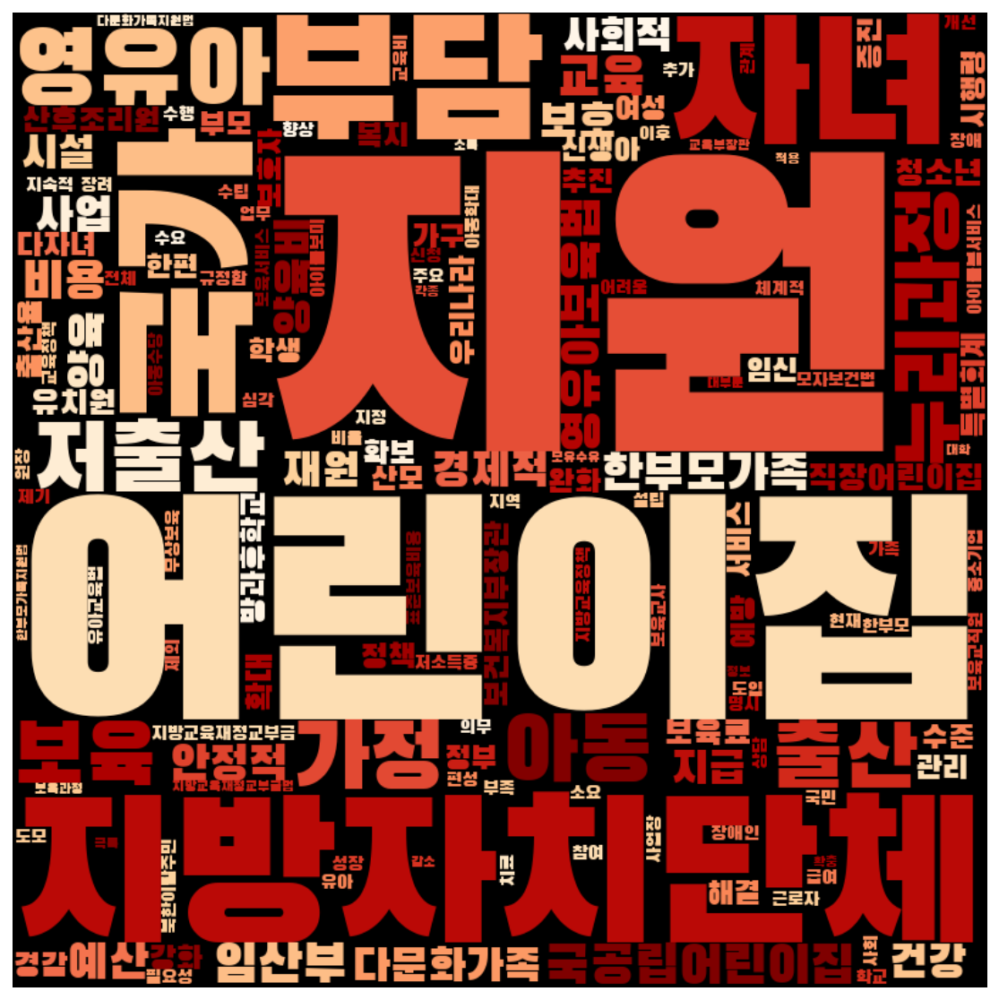

In [124]:
frewords_vis(parkkeunhye_g1_tokens)
wordcloud_vis(parkkeunhye_g1_tokens, 'OrRd')

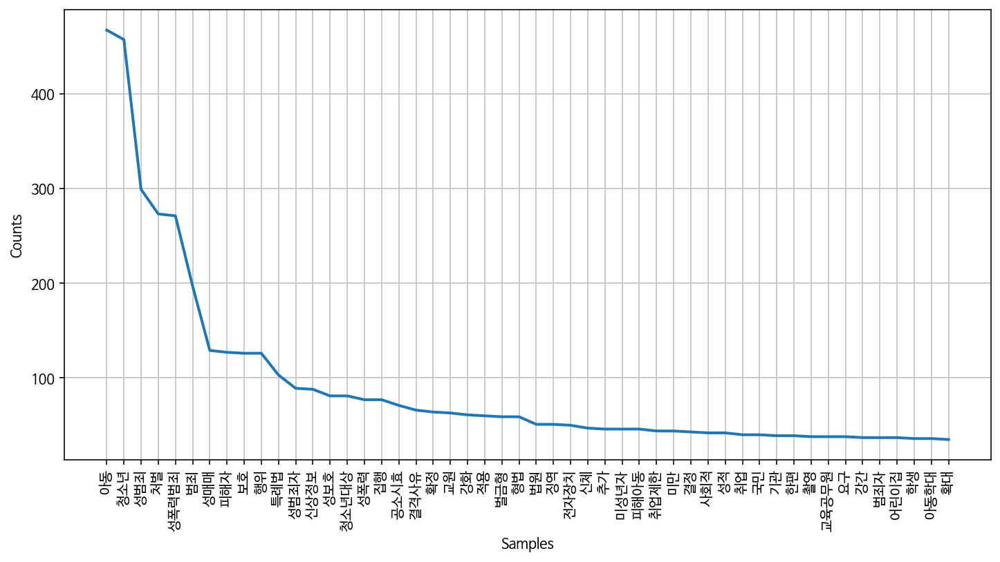

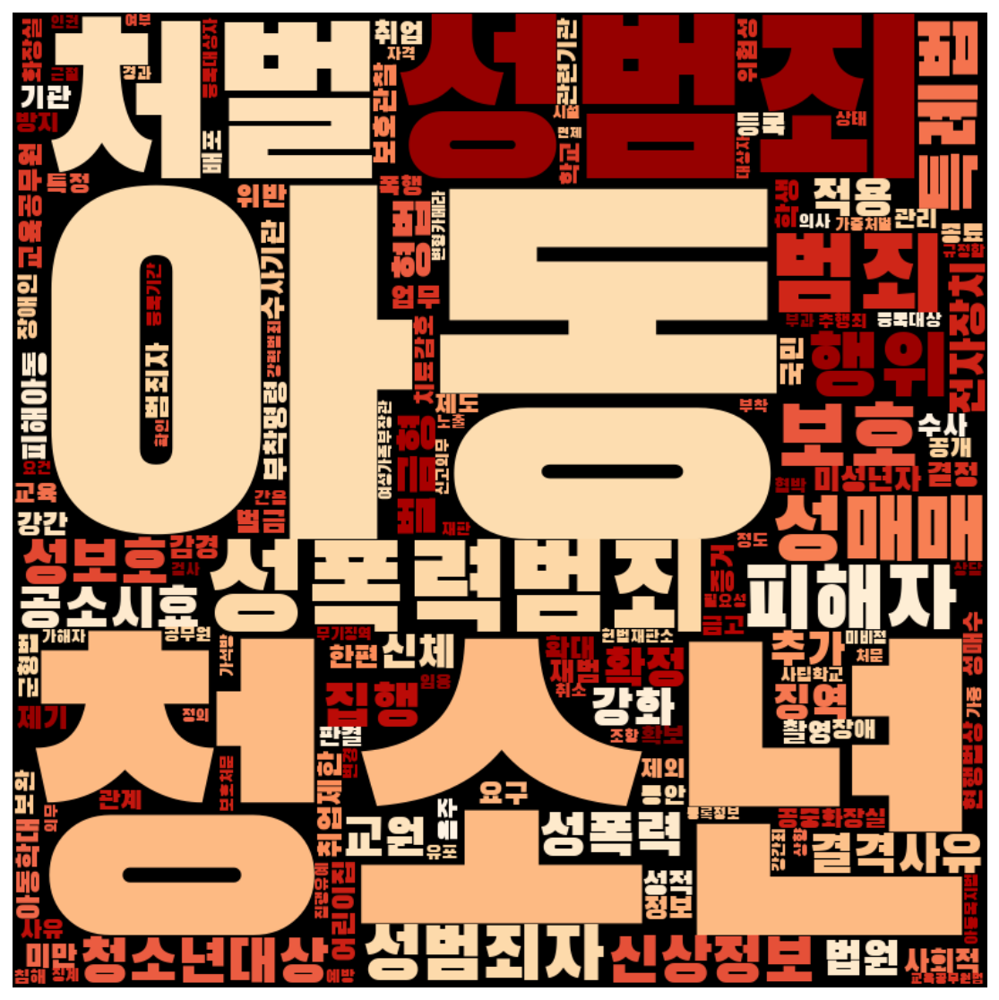

In [125]:
frewords_vis(parkkeunhye_g2_tokens)
wordcloud_vis(parkkeunhye_g2_tokens, 'OrRd')

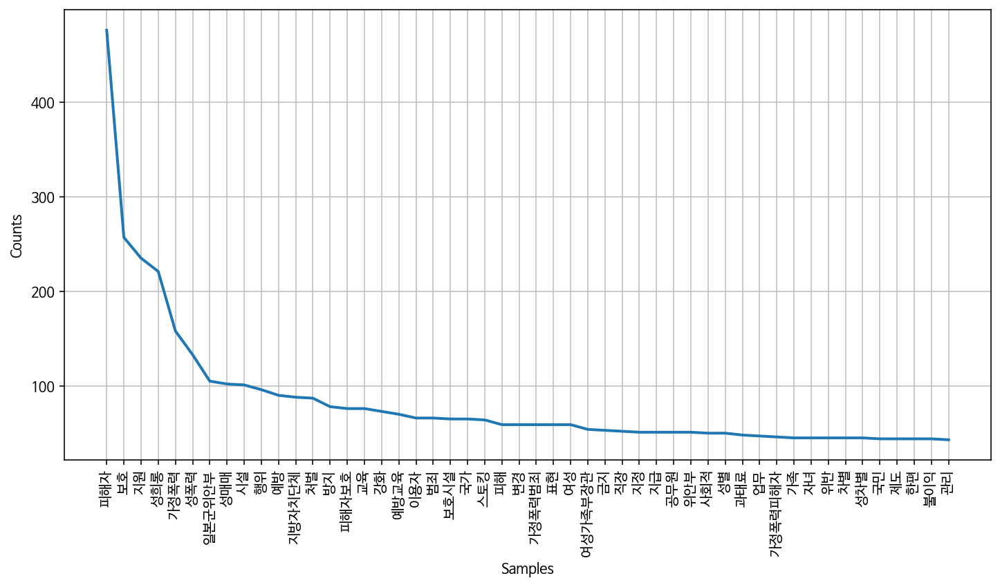

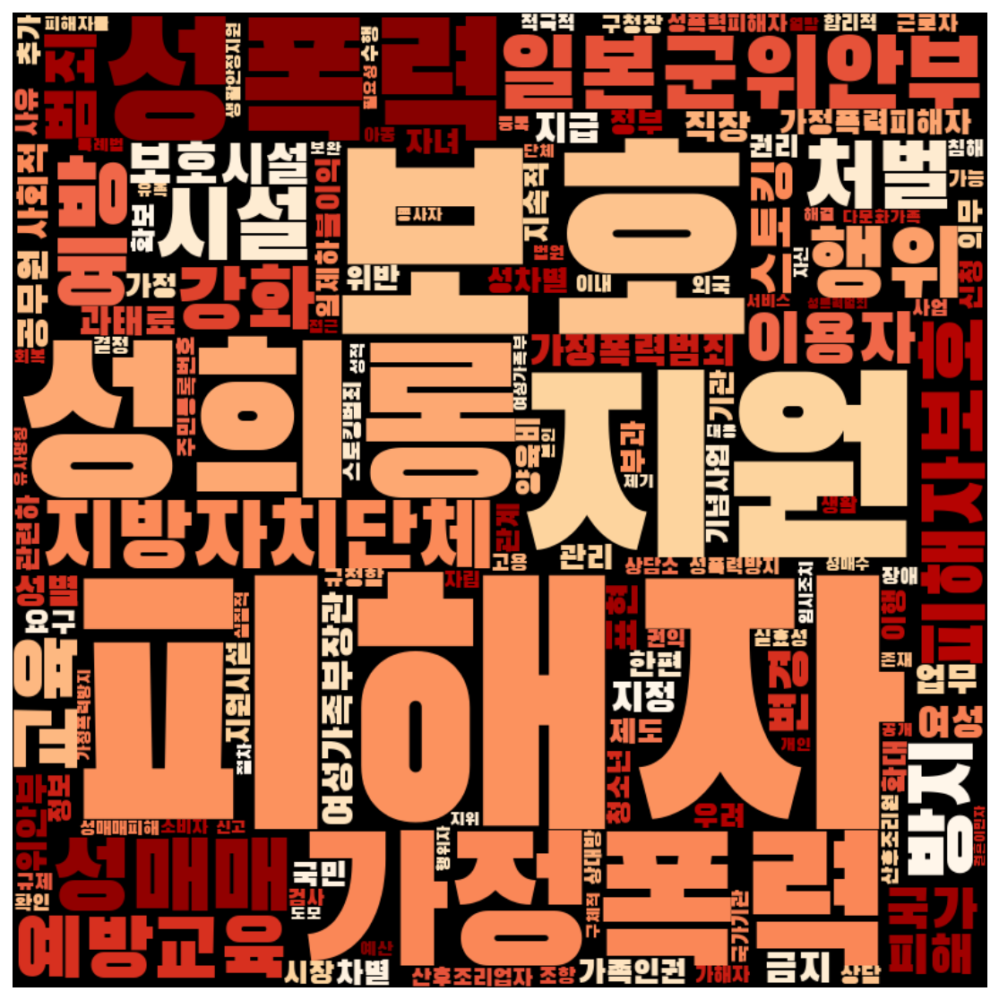

In [126]:
frewords_vis(parkkeunhye_g3_tokens)
wordcloud_vis(parkkeunhye_g3_tokens, 'OrRd')

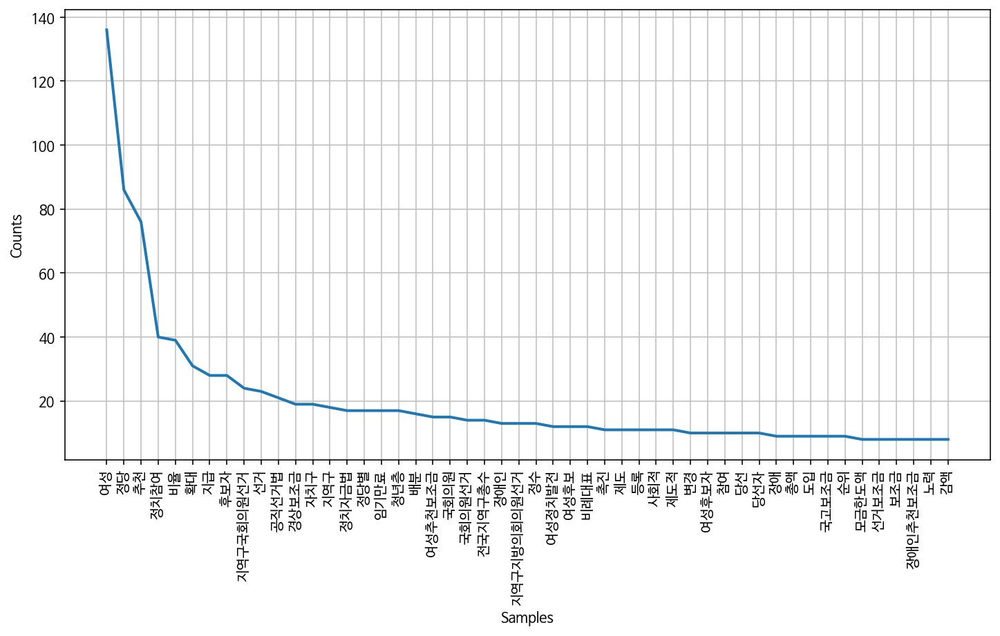

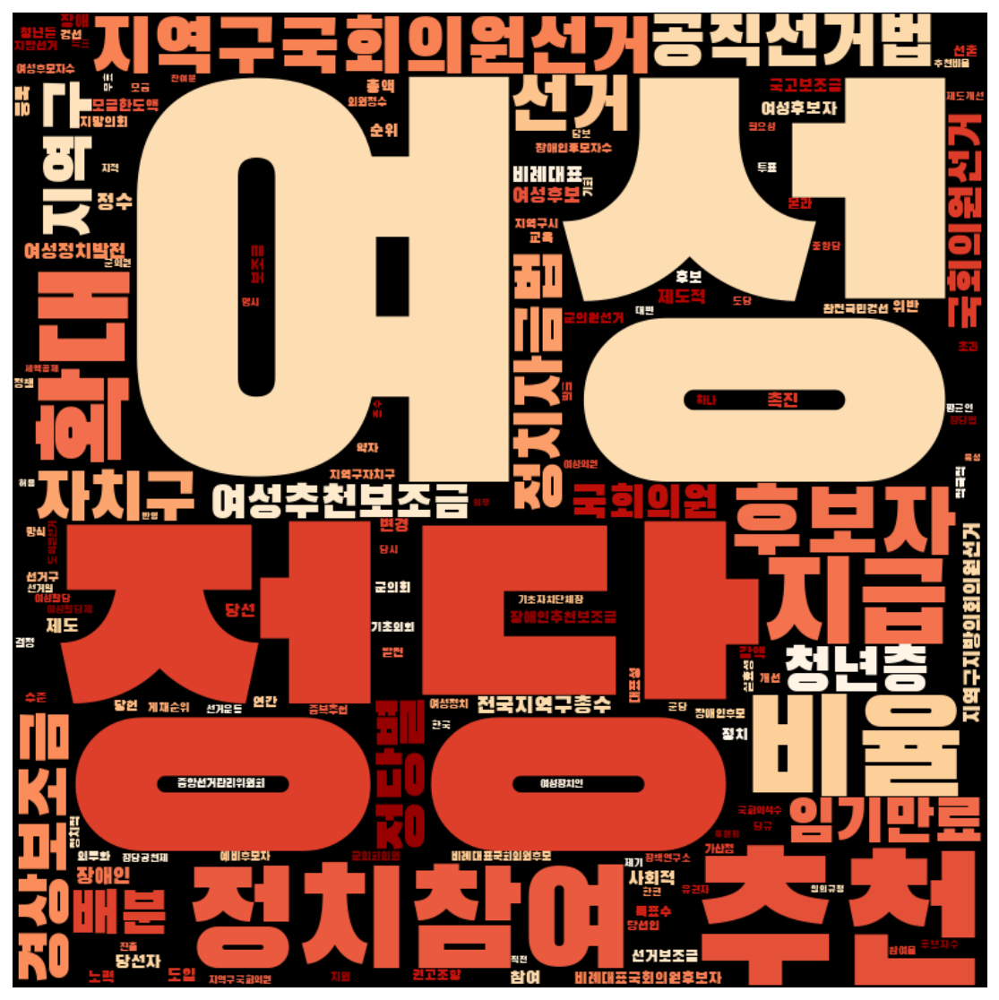

In [127]:
frewords_vis(parkkeunhye_g4_tokens)
wordcloud_vis(parkkeunhye_g4_tokens, 'OrRd')

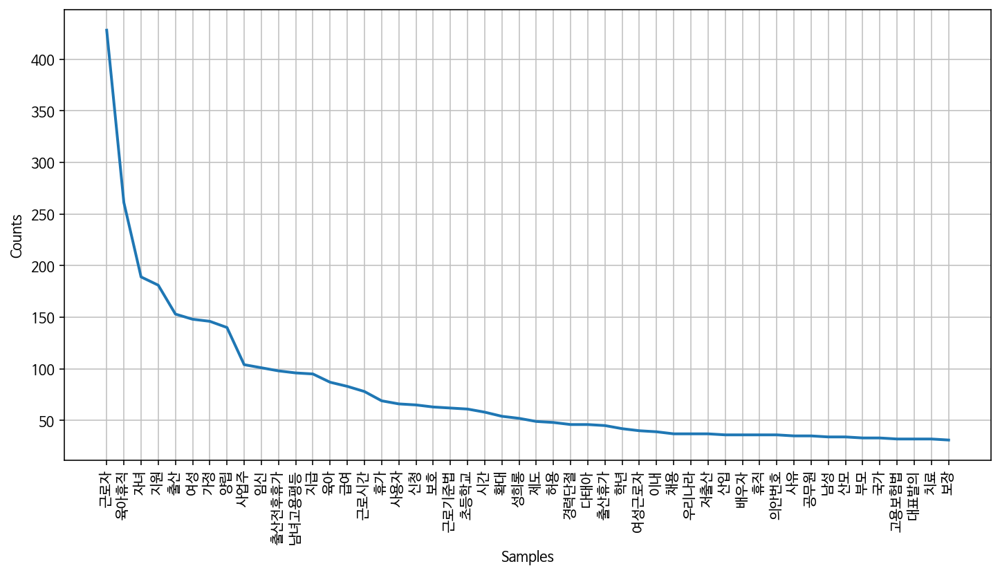

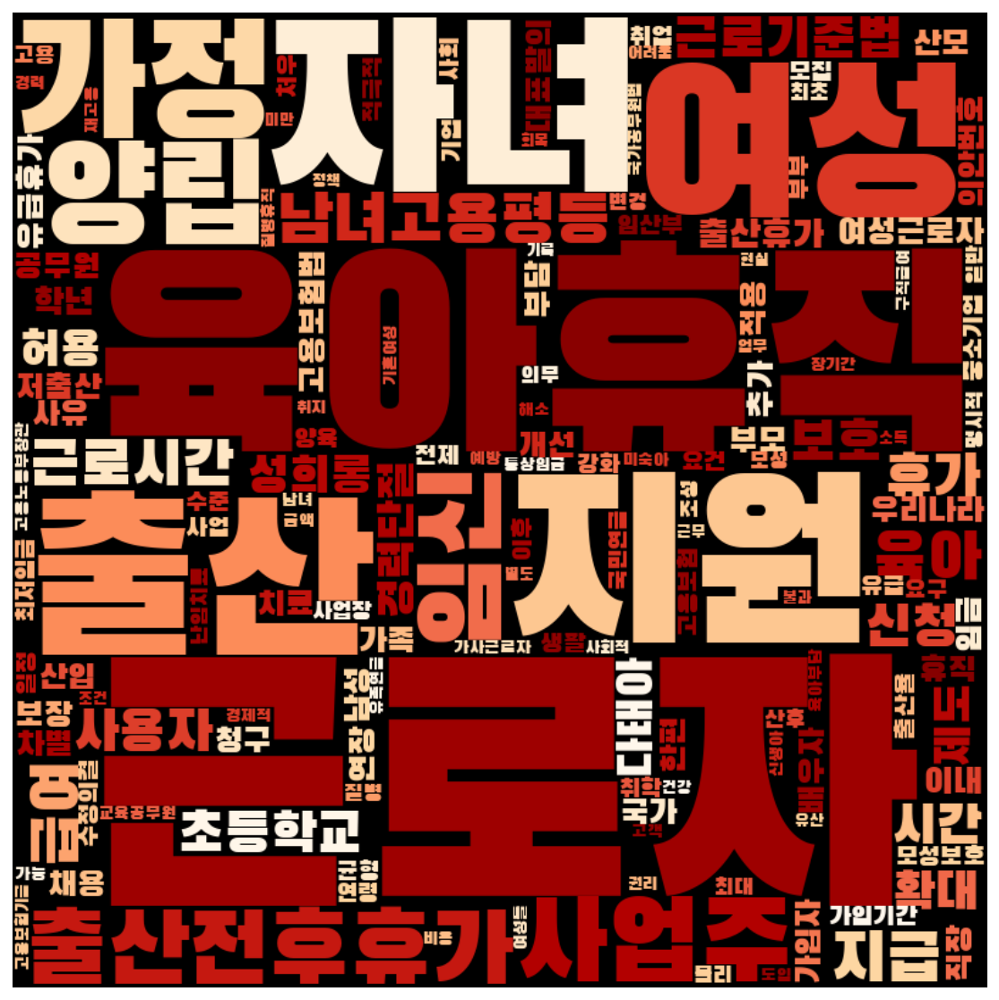

In [128]:
frewords_vis(parkkeunhye_g5_tokens)
wordcloud_vis(parkkeunhye_g5_tokens, 'OrRd')

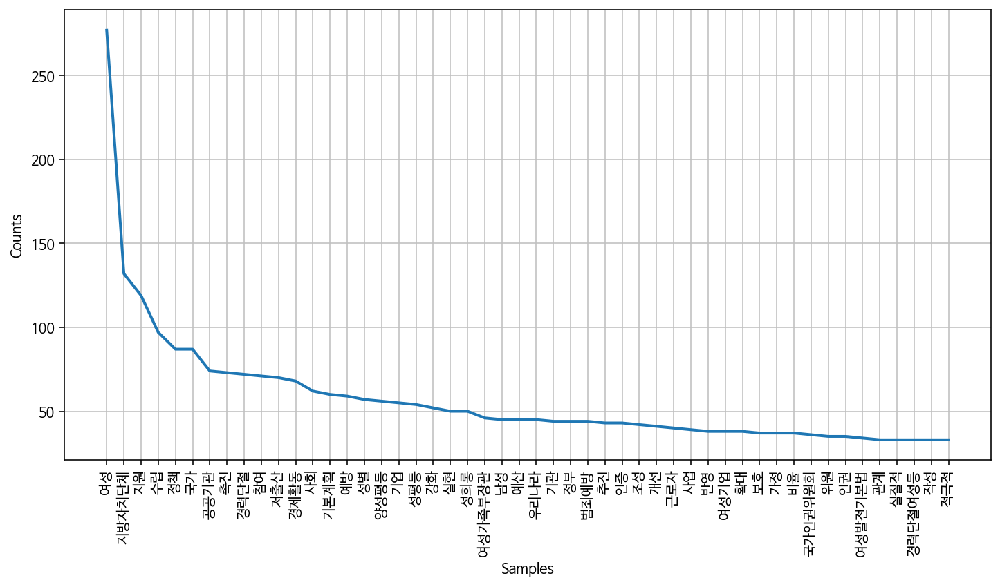

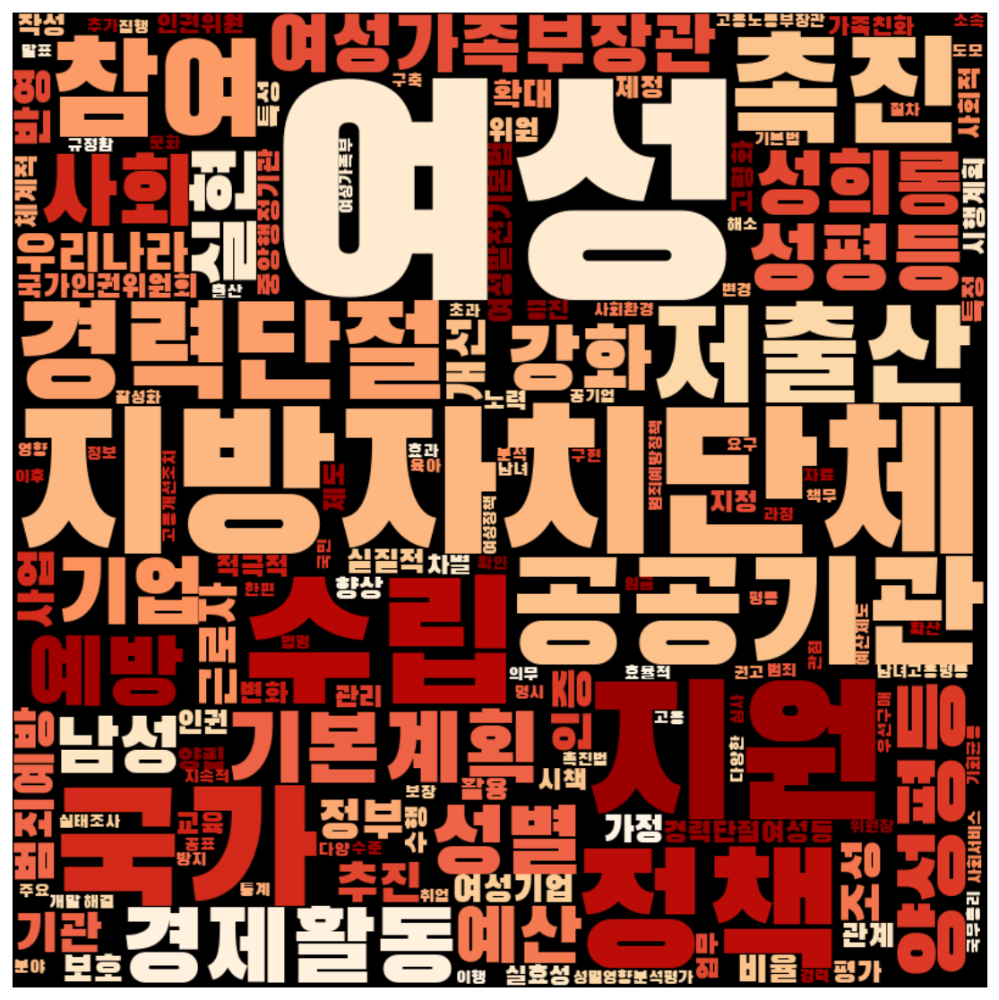

In [129]:
frewords_vis(parkkeunhye_g6_tokens)
wordcloud_vis(parkkeunhye_g6_tokens, 'OrRd')

## 문재인 정권 
- 2017.05.10 ~

In [20]:
moonjaein = gender[(gender['제안일자'] > datetime.date(2017,5,10))]
moonjaein.shape

(1636, 16)

In [21]:
moonjaein['소관위원회'].value_counts()

법제사법위원회              316
여성가족위원회              270
보건복지위원회              216
환경노동위원회              216
행정안전위원회              108
교육위원회                 76
과학기술정보방송통신위원회         70
농림축산식품해양수산위원회         62
기획재정위원회               59
문화체육관광위원회             55
정무위원회                 39
국방위원회                 35
산업통상자원중소벤처기업위원회       35
국토교통위원회               27
국회운영위원회               19
외교통일위원회               16
정치개혁 특별위원회             9
교육문화체육관광위원회            4
헌법개정 및 정치개혁 특별위원회      2
2019-06-28             1
정보위원회                  1
Name: 소관위원회, dtype: int64

In [22]:
moonjaein[moonjaein['소관위원회'] == '2019-06-28']

,의안번호,의안명,제안일자,제안자구분,의결일자,의결결과,제안회기,제안이유,소관위원회,제안자,발의자,제안정당,성별,여성의원 수,정당성향,국회회기
258,2021191,여성가족위원장,2019-06-28,의원,2019-06-28,원안가결,제20대 (2016~2020) 제369회,,2019-06-28,['전혜숙'],전혜숙,더불어민주당,여성,1,진보,20


<AxesSubplot:>

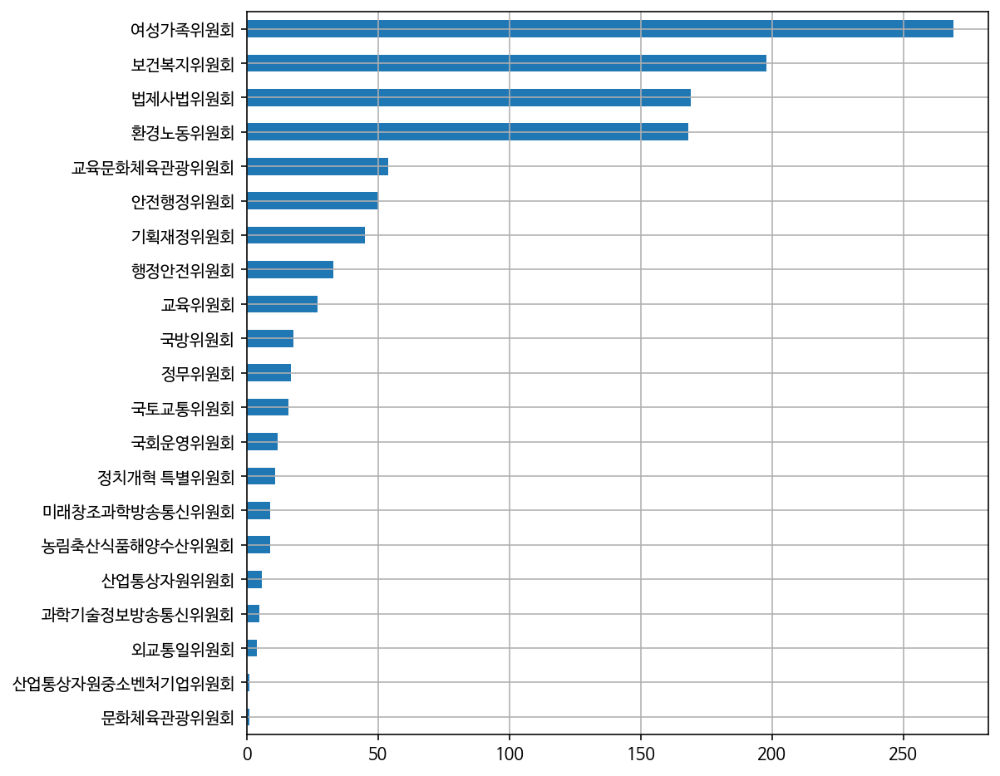

In [226]:
comm_df = parkkeunhye.copy()
comm_df = comm_df[comm_df['소관위원회'] != '미확정']

comm_df['소관위원회'].value_counts(ascending=True).plot(kind='barh', grid=True, figsize=(8,8))

In [227]:
model_government = Word2Vec(moonjaein['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-28 16:06:20,406 : INFO : collecting all words and their counts
2020-10-28 16:06:20,407 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-28 16:06:20,445 : INFO : collected 11131 word types from a corpus of 111477 raw words and 1636 sentences
2020-10-28 16:06:20,446 : INFO : Loading a fresh vocabulary
2020-10-28 16:06:20,455 : INFO : effective_min_count=10 retains 1666 unique words (14% of original 11131, drops 9465)
2020-10-28 16:06:20,456 : INFO : effective_min_count=10 leaves 89659 word corpus (80% of original 111477, drops 21818)
2020-10-28 16:06:20,462 : INFO : deleting the raw counts dictionary of 11131 items
2020-10-28 16:06:20,464 : INFO : sample=0.001 downsamples 74 most-common words
2020-10-28 16:06:20,465 : INFO : downsampling leaves estimated 77373 word corpus (86.3% of prior 89659)
2020-10-28 16:06:20,469 : INFO : estimated required memory for 1666 words and 100 dimensions: 2165800 bytes
2020-10-28 16:06:20,470 : INFO : resetting lay

2020-10-28 16:06:25,359 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:25,386 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:25,393 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:06:25,394 : INFO : EPOCH - 15 : training on 111477 raw words (77230 effective words) took 0.3s, 246812 effective words/s
2020-10-28 16:06:25,675 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:06:25,747 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:25,749 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:25,751 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:06:25,752 : INFO : EPOCH - 16 : training on 111477 raw words (77348 effective words) took 0.3s, 221107 effective words/s
2020-10-28 16:06:26,002 : INFO : worker thread finished; awaiting finish of 3 more threads
20

2020-10-28 16:06:30,224 : INFO : EPOCH - 31 : training on 111477 raw words (77442 effective words) took 0.3s, 284856 effective words/s
2020-10-28 16:06:30,444 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:06:30,497 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:30,498 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:30,506 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:06:30,506 : INFO : EPOCH - 32 : training on 111477 raw words (77383 effective words) took 0.3s, 280382 effective words/s
2020-10-28 16:06:30,711 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:06:30,763 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:30,768 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:30,778 : INFO : worker thread finished; awaiting finish of 0 more threads
20

2020-10-28 16:06:35,244 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:35,265 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:35,268 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:06:35,268 : INFO : EPOCH - 48 : training on 111477 raw words (77451 effective words) took 0.3s, 256135 effective words/s
2020-10-28 16:06:35,481 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:06:35,543 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:35,549 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:35,552 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:06:35,553 : INFO : EPOCH - 49 : training on 111477 raw words (77507 effective words) took 0.3s, 278572 effective words/s
2020-10-28 16:06:35,732 : INFO : worker thread finished; awaiting finish of 3 more threads
20

2020-10-28 16:06:39,991 : INFO : EPOCH - 64 : training on 111477 raw words (77316 effective words) took 0.3s, 298295 effective words/s
2020-10-28 16:06:40,246 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:06:40,322 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:40,335 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:40,343 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:06:40,344 : INFO : EPOCH - 65 : training on 111477 raw words (77427 effective words) took 0.3s, 224299 effective words/s
2020-10-28 16:06:40,576 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:06:40,633 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:40,640 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:40,650 : INFO : worker thread finished; awaiting finish of 0 more threads
20

2020-10-28 16:06:45,197 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:45,203 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:45,205 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:06:45,206 : INFO : EPOCH - 81 : training on 111477 raw words (77320 effective words) took 0.3s, 279279 effective words/s
2020-10-28 16:06:45,407 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:06:45,450 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:45,474 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:45,476 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:06:45,476 : INFO : EPOCH - 82 : training on 111477 raw words (77346 effective words) took 0.3s, 293016 effective words/s
2020-10-28 16:06:45,755 : INFO : worker thread finished; awaiting finish of 3 more threads
20

2020-10-28 16:06:50,028 : INFO : EPOCH - 97 : training on 111477 raw words (77392 effective words) took 0.3s, 263245 effective words/s
2020-10-28 16:06:50,257 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:06:50,306 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:50,307 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:50,317 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-28 16:06:50,318 : INFO : EPOCH - 98 : training on 111477 raw words (77314 effective words) took 0.3s, 273639 effective words/s
2020-10-28 16:06:50,582 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-28 16:06:50,635 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-28 16:06:50,642 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-28 16:06:50,659 : INFO : worker thread finished; awaiting finish of 0 more threads
20

In [228]:
print(model_government.wv.most_similar('여성'))

2020-10-28 16:06:50,961 : INFO : precomputing L2-norms of word weight vectors


[('유리천장', 0.7341282367706299), ('승진', 0.7193487882614136), ('인사상', 0.6747081875801086), ('현상', 0.6363937258720398), ('전보', 0.6000239253044128), ('무형적', 0.5705368518829346), ('처우', 0.5548141002655029), ('비중', 0.5498653650283813), ('차별', 0.5417735576629639), ('충분함', 0.5332843661308289)]


In [234]:
government_word = total_tokens(moonjaein['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무','문장',
            '현상','인사상']
government_word = [each_word for each_word in government_word if each_word not in stopwords]

In [235]:
ko = nltk.Text(government_word, name='문재인 정권')
ko.vocab().most_common(20)

[('여성', 2765),
 ('피해자', 962),
 ('지원', 941),
 ('차별', 820),
 ('처벌', 811),
 ('유리천장', 691),
 ('아동', 683),
 ('보호', 655),
 ('성범죄', 603),
 ('성희롱', 588),
 ('공공기관', 580),
 ('성폭력', 578),
 ('성폭력범죄', 564),
 ('범죄', 557),
 ('처우', 532),
 ('해소', 518),
 ('청소년', 494),
 ('능력', 482),
 ('직장', 463),
 ('승진', 461)]

In [236]:
print('부녀 단어 수:', ko.count('부녀'))
print('여자 단어 수:', ko.count('여자'))
print('여성 단어 수:', ko.count('여성'))
print('젠더 단어 수:', ko.count('젠더'))
print()

print('남녀평등 단어 수:', ko.count('남녀평등'))
print('양성평등 단어 수:', ko.count('양성평등'))
print('성평등 단어 수:', ko.count('성평등'))
print('성인지적 단어 수:', ko.count('성인지적'))
print('성주류화 단어 수:', ko.count('성주류화'))
print()

print('청소년 단어 수:', ko.count('청소년'))
print('아동 단어 수:', ko.count('아동'))


부녀 단어 수: 12
여자 단어 수: 19
여성 단어 수: 2765
젠더 단어 수: 4

남녀평등 단어 수: 2
양성평등 단어 수: 84
성평등 단어 수: 39
성인지적 단어 수: 8
성주류화 단어 수: 2

청소년 단어 수: 494
아동 단어 수: 683


In [137]:
# 호주제
print('호주제 단어 수:', ko.count('호주제'))
print('가족법 단어 수:', ko.count('가족법'))
print()

# 가족
print('저출산 단어 수:', ko.count('저출산'))
print('육아휴직 단어 수:', ko.count('육아휴직'))
print('보육 단어 수:', ko.count('보육'))
print()

# 위안부
print('위안부 단어 수:', ko.count('위안부'))
print('일본군성노예제 단어 수:', ko.count('일본군위안부'))
print()

# 성폭력
print('성범죄 단어 수:', ko.count('성범죄'))
print('강간 단어 수:', ko.count('강간'))
print('성희롱 단어 수:', ko.count('성희롱'))
print('성폭력 단어 수:', ko.count('성폭력'))
print('성폭력범죄 단어 수:', ko.count('성폭력범죄'))
print()

# 성매매
print('윤락 단어 수:', ko.count('윤락'))
print('윤락행위 단어 수:', ko.count('윤락행위'))
print('기생관광 단어 수:', ko.count('기생관광'))
print('성매매 단어 수:', ko.count('성매매'))
print()

# 가정폭력
print('가정폭력 단어 수:', ko.count('가정폭력'))
print()

# 임신중절
print('낙태 단어 수:', ko.count('낙태'))
print('임신중절 단어 수:', ko.count('임신중절'))
print()

# 스토킹 
print('스토킹 단어 수:', ko.count('스토킹'))
print()

# 미투
print('미투 단어 수:', ko.count('미투'))
print()

# 불법촬영
print('불법촬영 단어 수:', ko.count('불법촬영'))
print('몰카 단어 수:', ko.count('몰카'))

호주제 단어 수: 3
가족법 단어 수: 0

저출산 단어 수: 161
육아휴직 단어 수: 245
보육 단어 수: 55

위안부 단어 수: 23
일본군성노예제 단어 수: 53

성범죄 단어 수: 603
강간 단어 수: 97
성희롱 단어 수: 588
성폭력 단어 수: 578
성폭력범죄 단어 수: 564

윤락 단어 수: 0
윤락행위 단어 수: 0
기생관광 단어 수: 0
성매매 단어 수: 135

가정폭력 단어 수: 179

낙태 단어 수: 9
임신중절 단어 수: 2

스토킹 단어 수: 44

미투 단어 수: 61

불법촬영 단어 수: 14
몰카 단어 수: 4


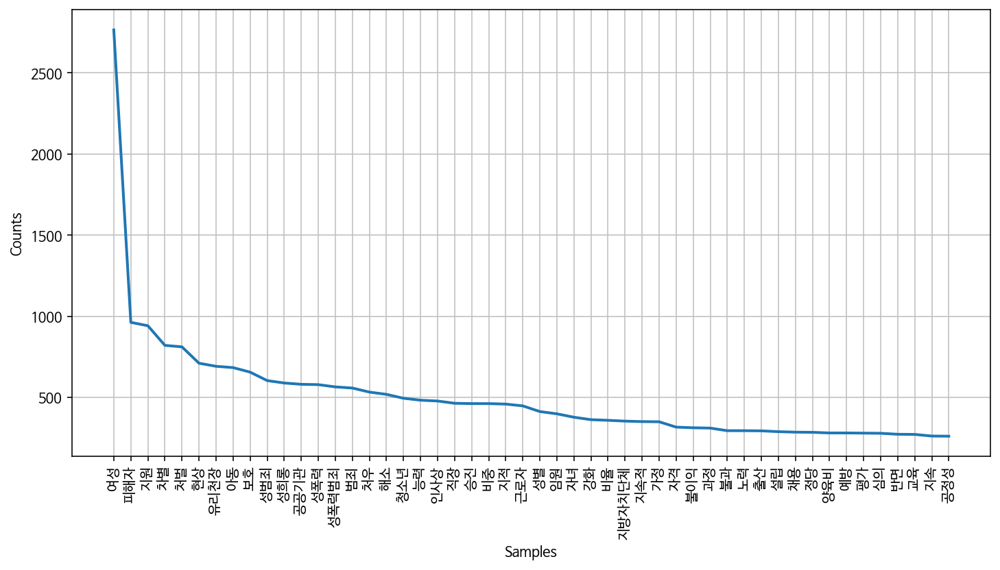

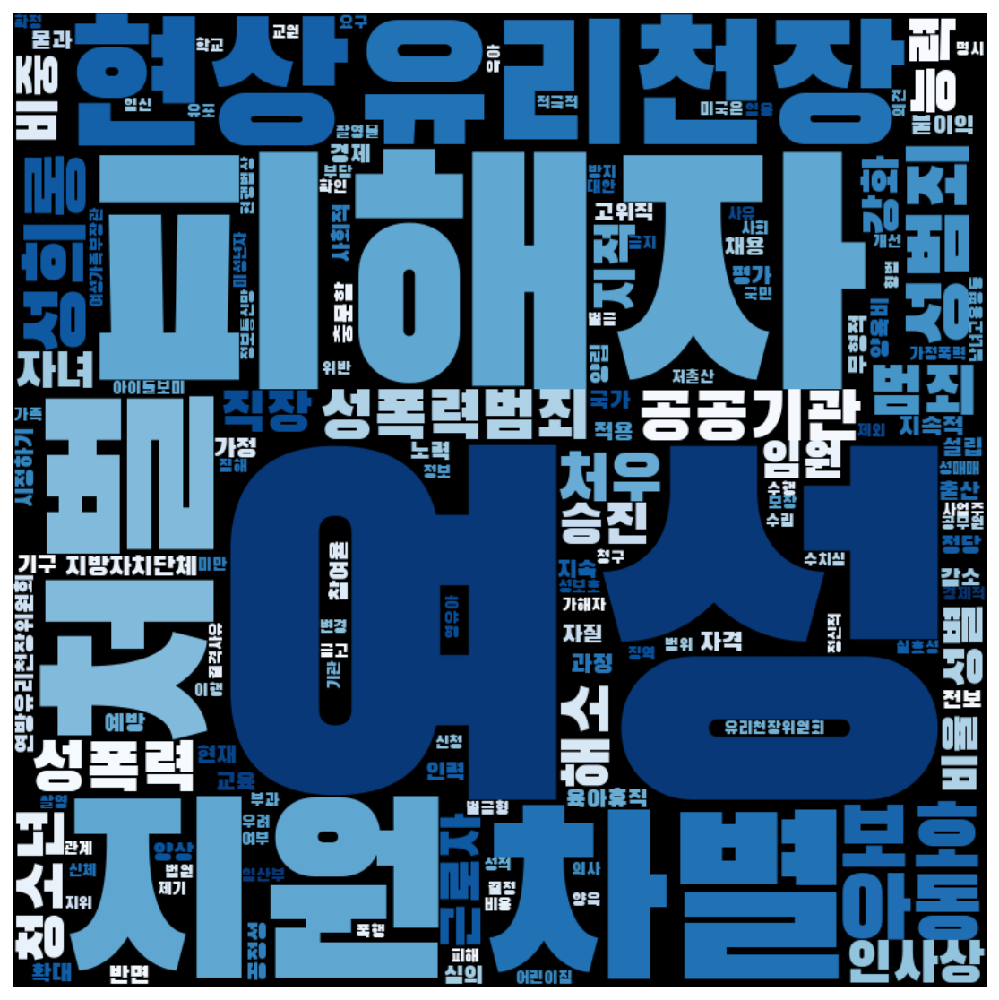

In [138]:
frewords_vis(government_word)
wordcloud_vis(government_word, 'Blues')

In [139]:
moonjaein['문장벡터'] = moonjaein['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))

/usr/local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
<ipython-input-139-0c4647f9f87a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  moonjaein['문장벡터'] = moonjaein['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_government))


In [140]:
moonjaein = moonjaein[moonjaein['명사수'] > 1]

# K means 수행 
word_vectors = moonjaein['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors)
moonjaein['category'] = idx

In [141]:
moonjaein['category'].value_counts()

1    410
3    406
0    315
4    230
5    193
2     80
Name: category, dtype: int64

In [142]:
moonjaein_g1 = moonjaein[moonjaein['category'] == 0]
moonjaein_g2 = moonjaein[moonjaein['category'] == 1]
moonjaein_g3 = moonjaein[moonjaein['category'] == 2]
moonjaein_g4 = moonjaein[moonjaein['category'] == 3]
moonjaein_g5 = moonjaein[moonjaein['category'] == 4]
moonjaein_g6 = moonjaein[moonjaein['category'] == 5]
#moonjaein_g7 = moonjaein[moonjaein['category'] == 6]

In [143]:
moonjaein_g1_tokens = total_tokens(moonjaein_g1['tokens'])
moonjaein_g2_tokens = total_tokens(moonjaein_g2['tokens'])
moonjaein_g3_tokens = total_tokens(moonjaein_g3['tokens'])
moonjaein_g4_tokens = total_tokens(moonjaein_g4['tokens'])
moonjaein_g5_tokens = total_tokens(moonjaein_g5['tokens'])
moonjaein_g6_tokens = total_tokens(moonjaein_g6['tokens'])
#moonjaein_g7_tokens = total_tokens(moonjaein_g7['tokens'])

In [144]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
moonjaein_g1_tokens = [each_word for each_word in moonjaein_g1_tokens if each_word not in stopwords]
moonjaein_g2_tokens = [each_word for each_word in moonjaein_g2_tokens if each_word not in stopwords]
moonjaein_g3_tokens = [each_word for each_word in moonjaein_g3_tokens if each_word not in stopwords]
moonjaein_g4_tokens = [each_word for each_word in moonjaein_g4_tokens if each_word not in stopwords]
moonjaein_g5_tokens = [each_word for each_word in moonjaein_g5_tokens if each_word not in stopwords]
moonjaein_g6_tokens = [each_word for each_word in moonjaein_g6_tokens if each_word not in stopwords]
#moonjaein_g7_tokens = [each_word for each_word in moonjaein_g7_tokens if each_word not in stopwords]



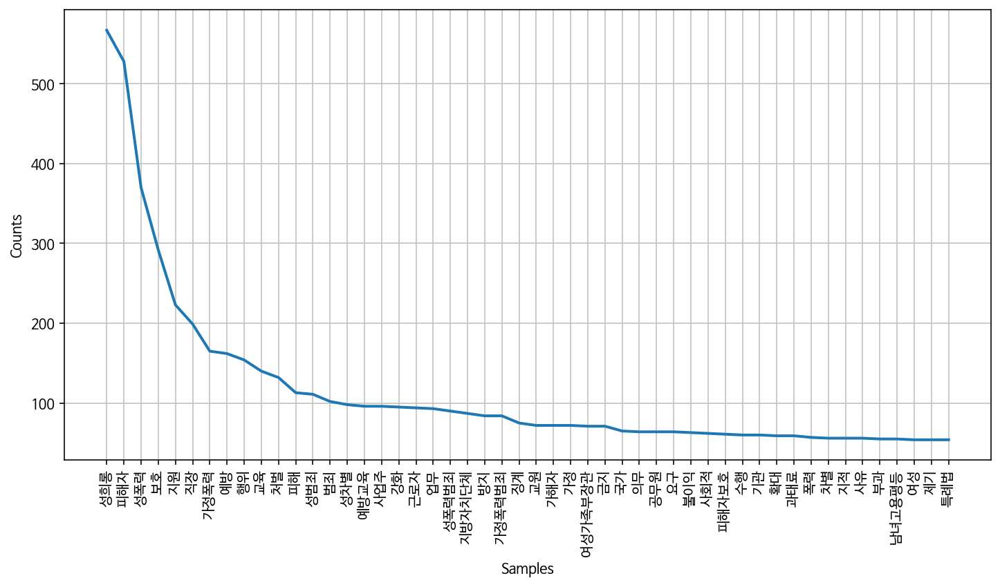

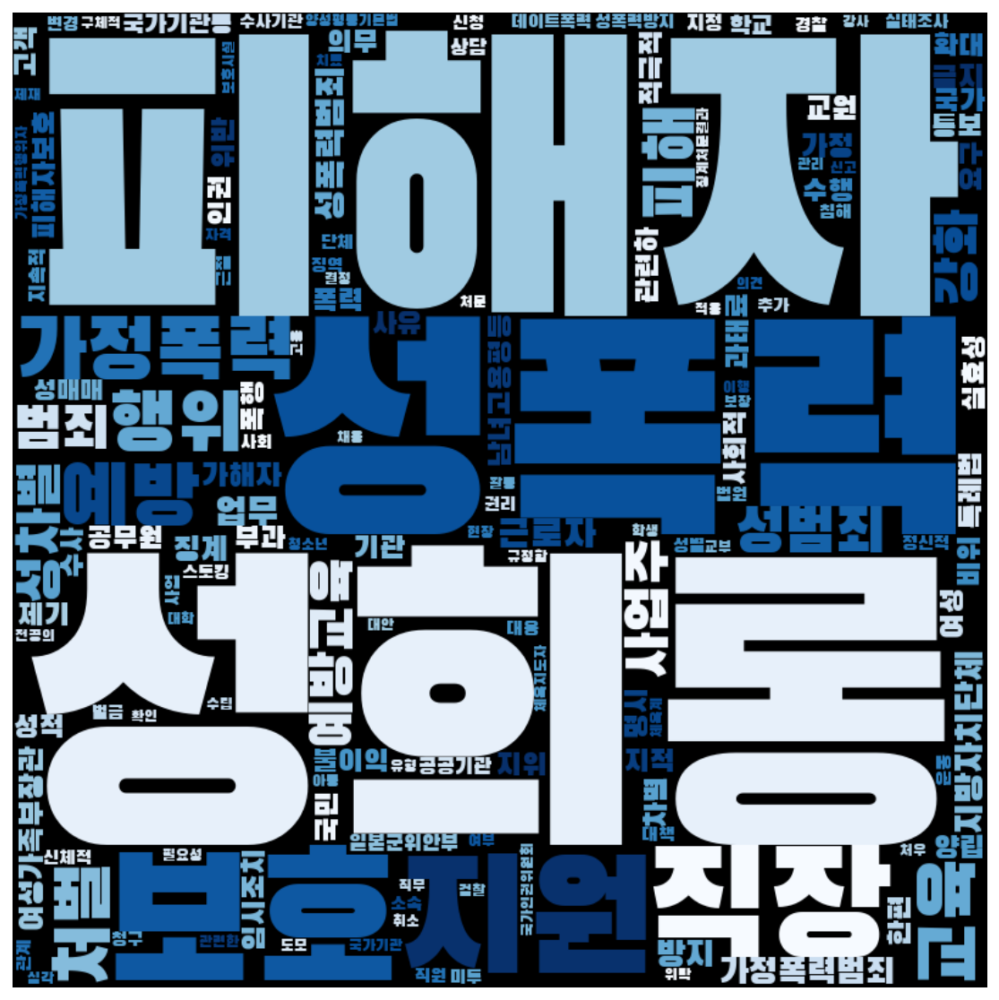

In [145]:
frewords_vis(moonjaein_g1_tokens)
wordcloud_vis(moonjaein_g1_tokens, 'Blues')

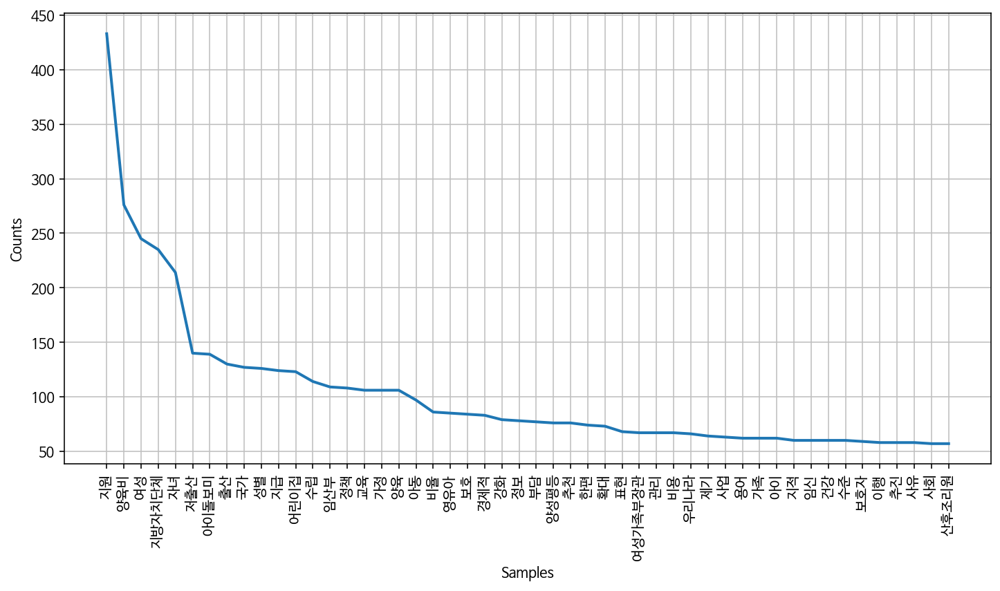

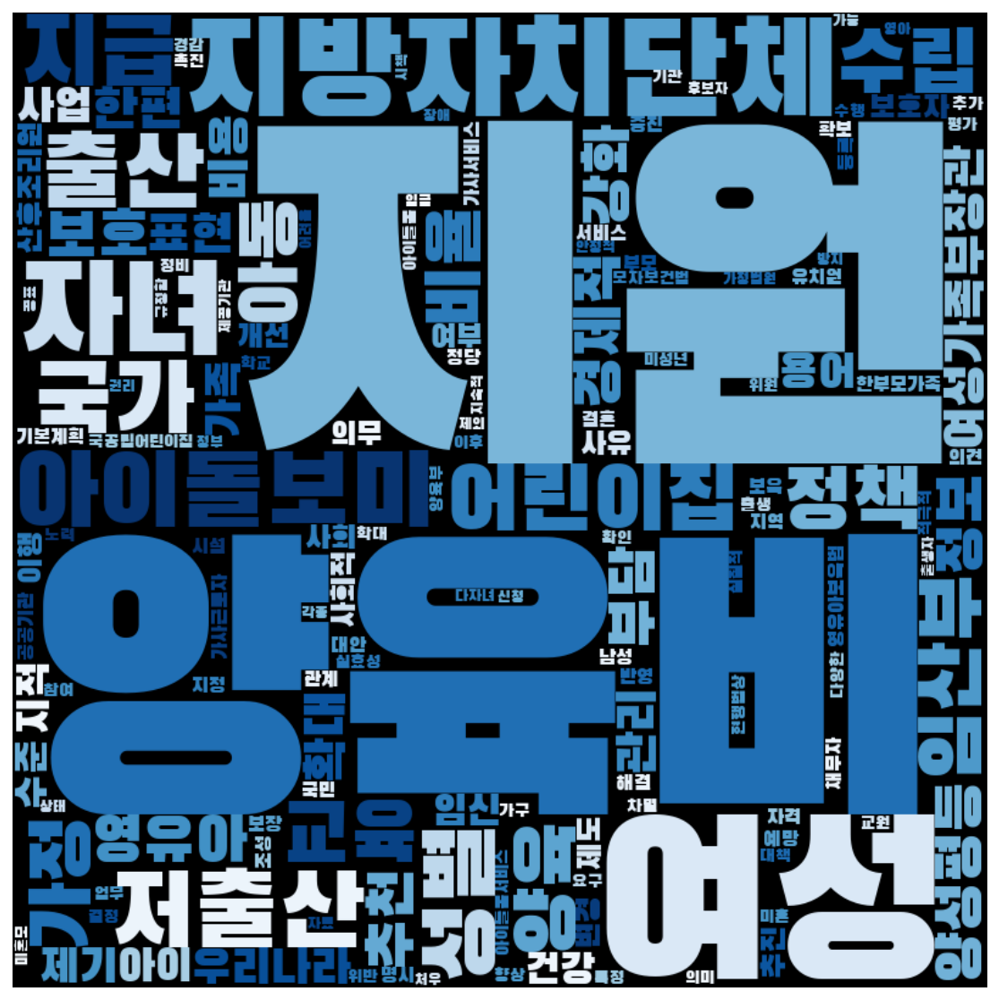

In [146]:
frewords_vis(moonjaein_g2_tokens)
wordcloud_vis(moonjaein_g2_tokens, 'Blues')

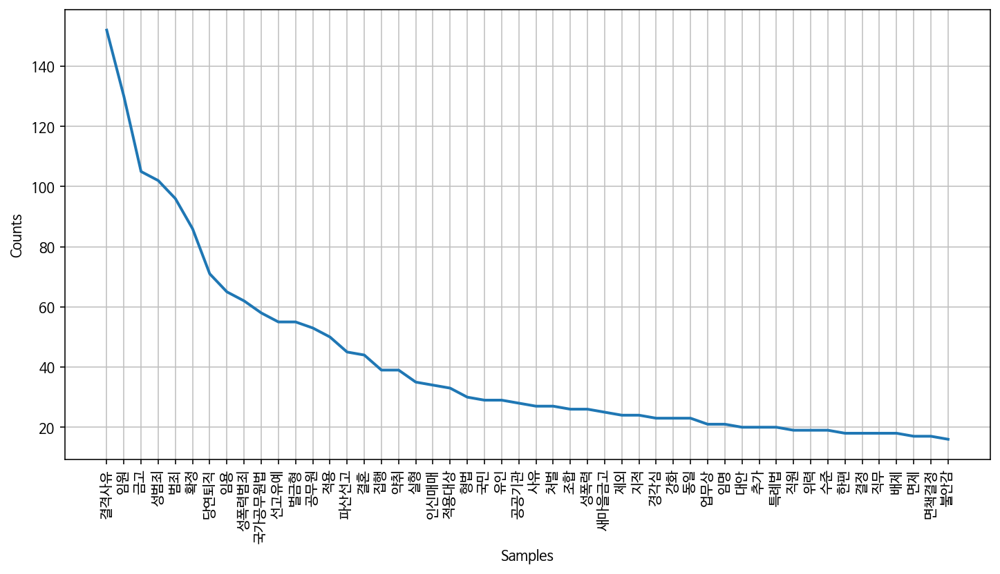

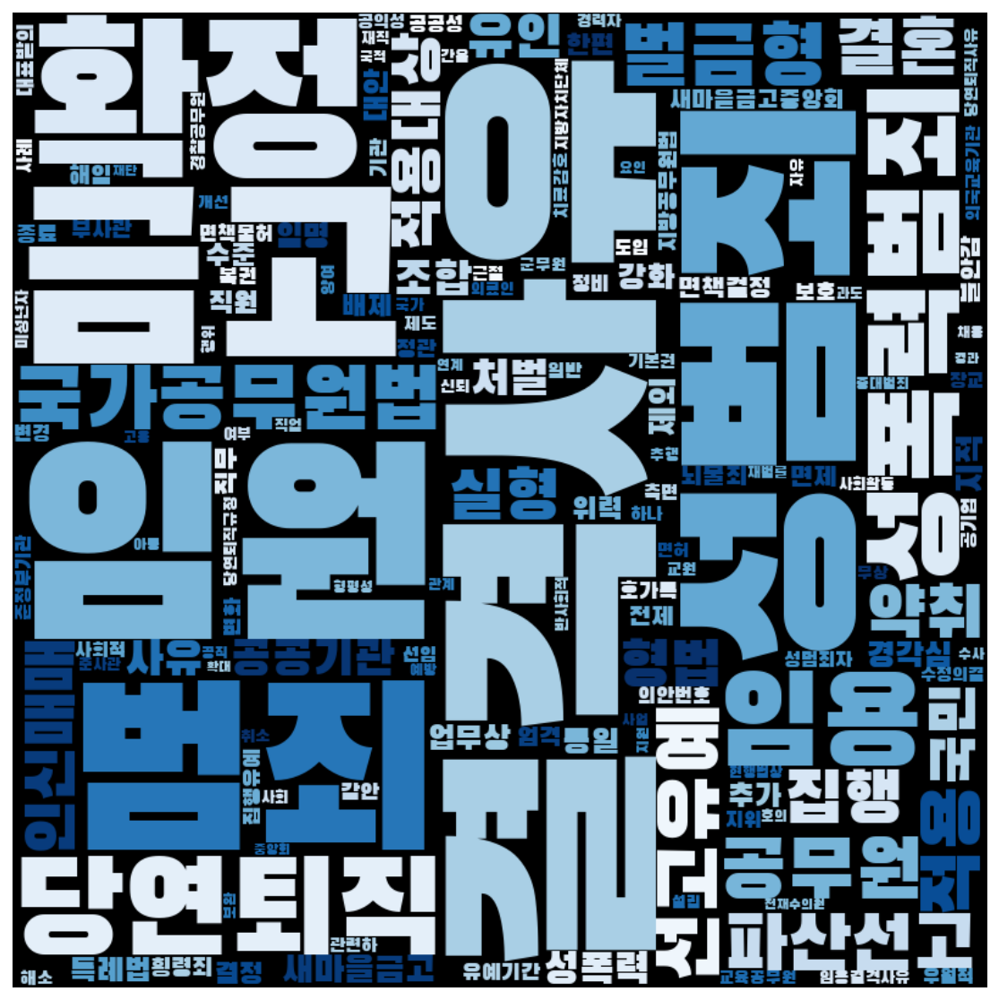

In [147]:
frewords_vis(moonjaein_g3_tokens)
wordcloud_vis(moonjaein_g3_tokens, 'Blues')

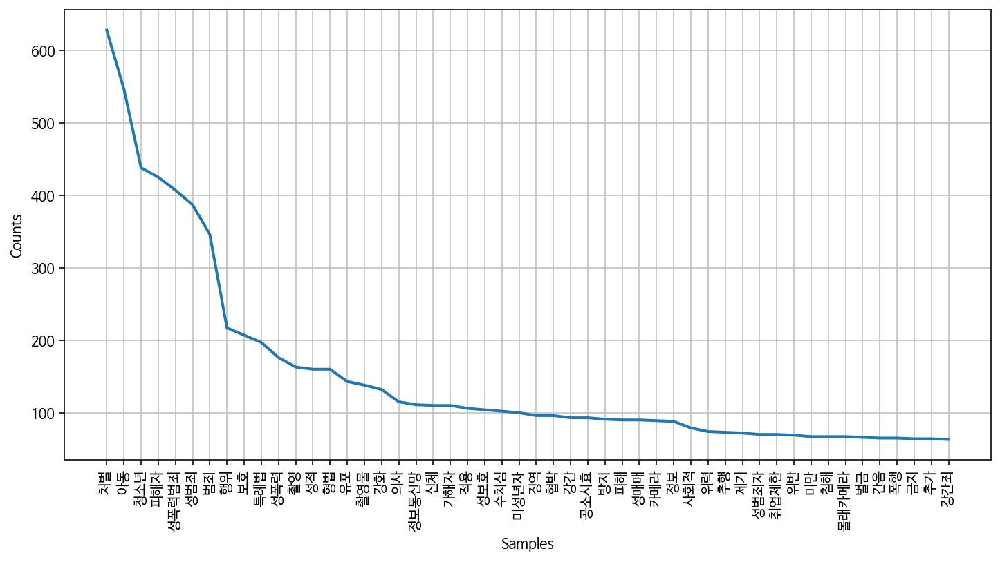

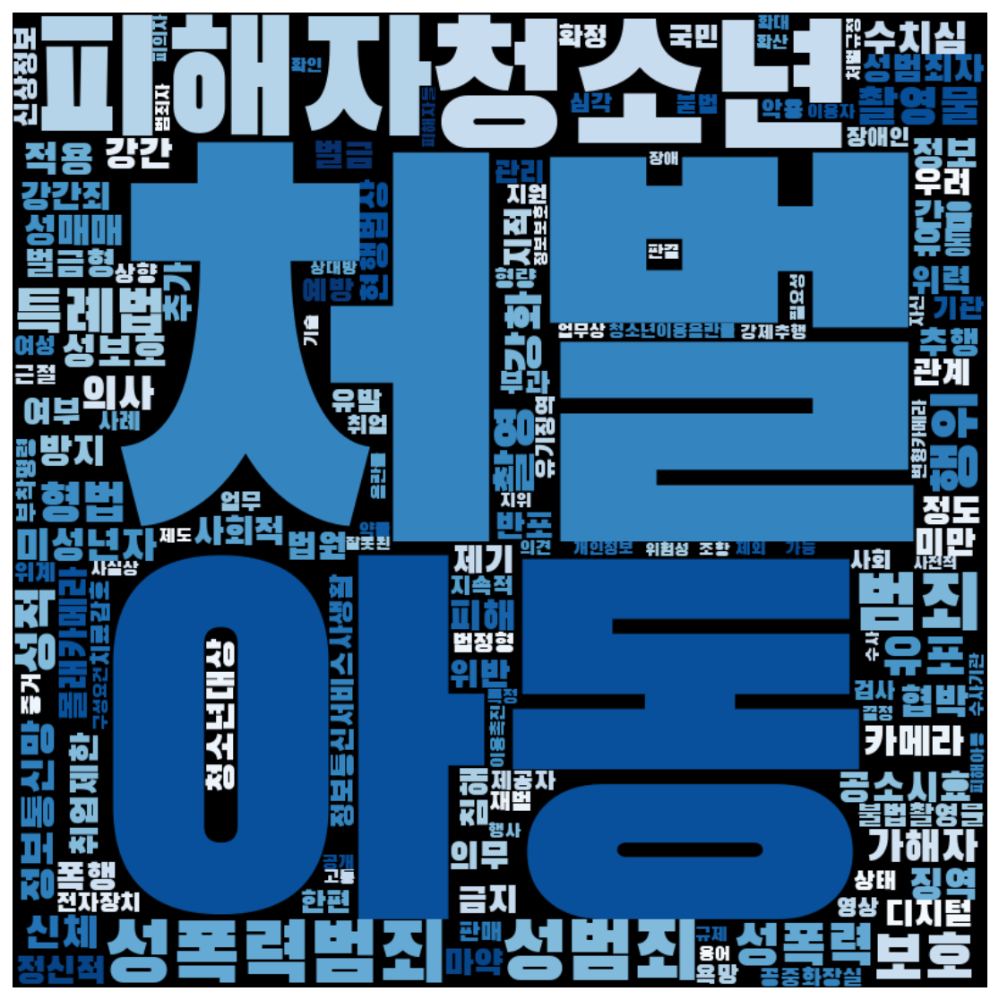

In [148]:
frewords_vis(moonjaein_g4_tokens)
wordcloud_vis(moonjaein_g4_tokens, 'Blues')

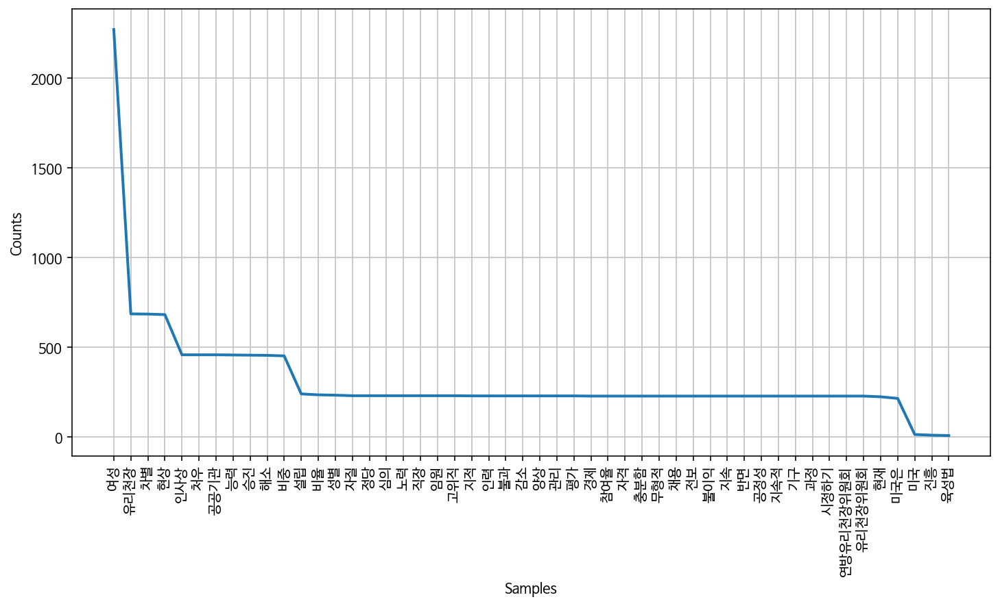

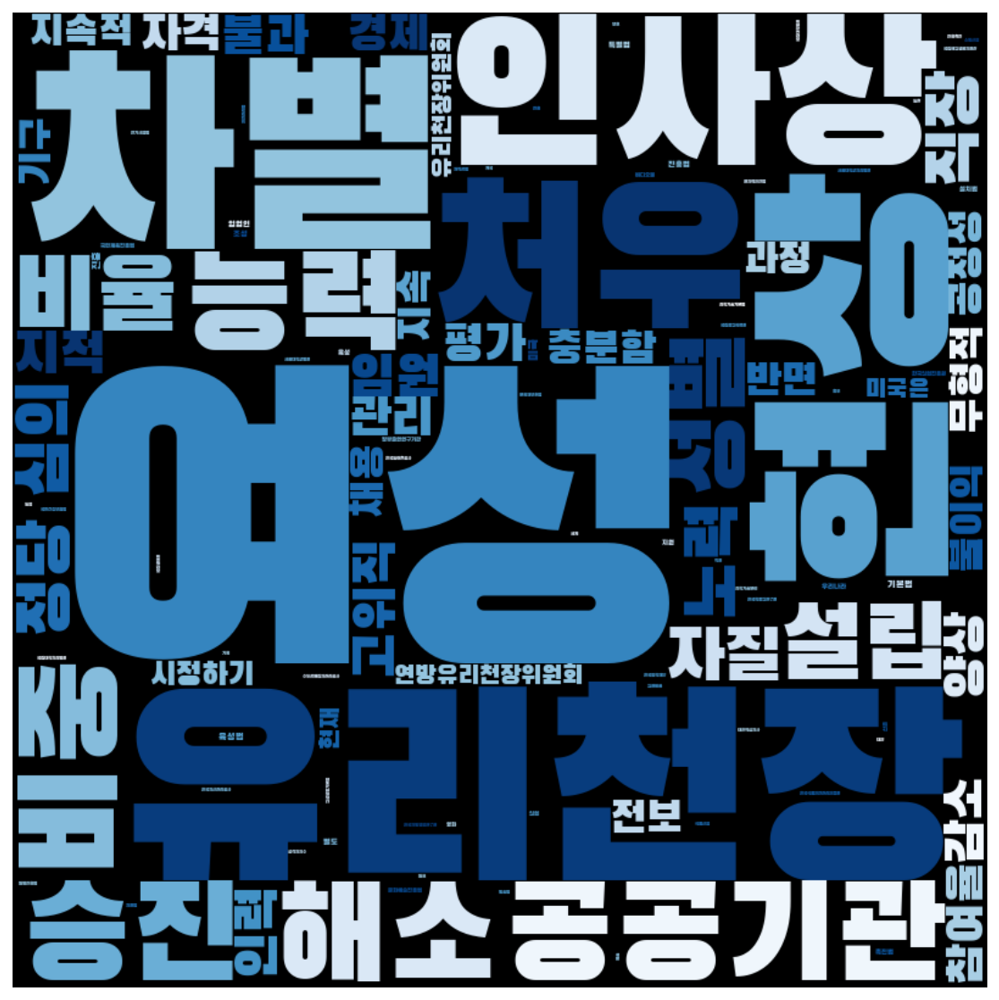

In [149]:
frewords_vis(moonjaein_g5_tokens)
wordcloud_vis(moonjaein_g5_tokens, 'Blues')

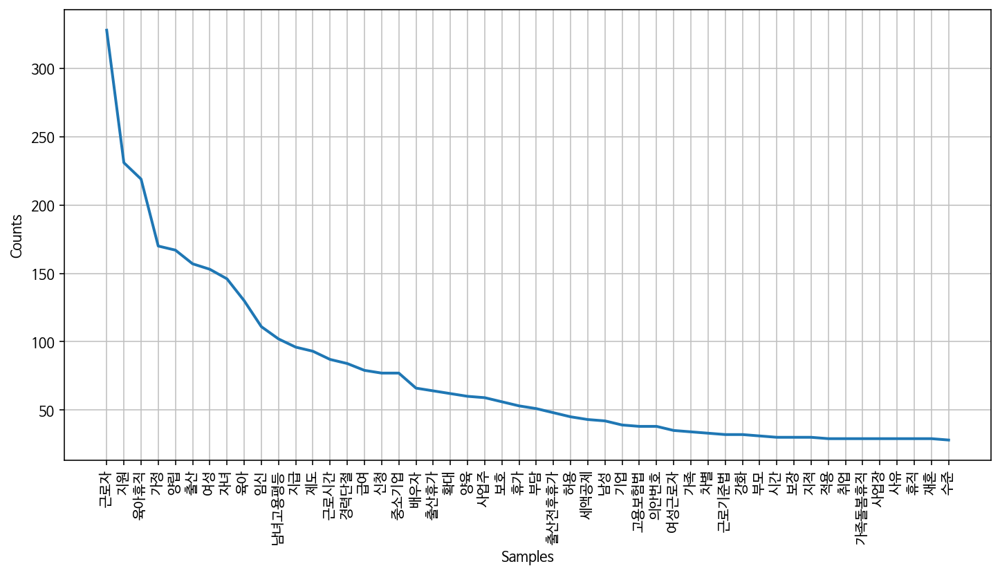

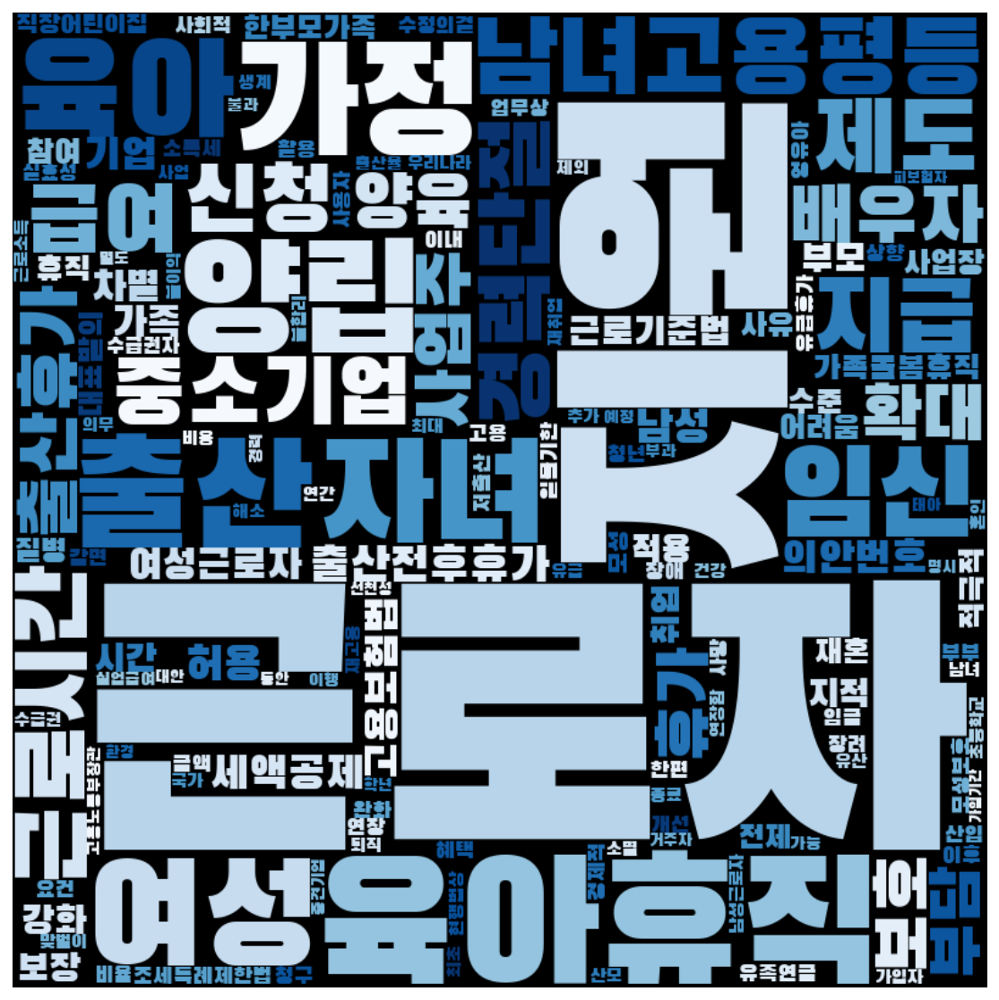

In [150]:
frewords_vis(moonjaein_g6_tokens)
wordcloud_vis(moonjaein_g6_tokens, 'Blues')

In [151]:
#frewords_vis(moonjaein_g7_tokens)
#wordcloud_vis(moonjaein_g7_tokens, 'Blues')